# 정당 및 정권 분석

In [1]:
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
import seaborn as sns
import re
from tqdm import tqdm
from gensim.models import Word2Vec
from sklearn.cluster import KMeans
import os
from gensim import models
import fasttext.util
from sklearn.cluster import AgglomerativeClustering
from konlpy.tag import Okt
import logging
import hanja
from krwordrank.hangle import normalize
import datetime
%matplotlib inline

In [2]:
# 한글폰트 설정
import matplotlib as mpl
import matplotlib.pyplot as plt
 
%config InlineBackend.figure_format = 'retina'
 
!apt -qq -y install fonts-nanum
 
import matplotlib.font_manager as fm
fontpath = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font = fm.FontProperties(fname=fontpath, size=9)
plt.rc('font', family='NanumBarunGothic') 
mpl.font_manager._rebuild()

Unable to locate an executable at "/Library/Java/JavaVirtualMachines/jdk-14.0.1.jdk/Contents/Home/bin/apt" (-1)


In [56]:
gender = pd.read_csv('whole-gender-bill-1320.csv', index_col=0,
                           parse_dates=['제안일자','의결일자'],encoding='utf-8-sig')
print(gender.shape)
gender.head(1)

(4295, 16)


,의안번호,의안명,제안일자,제안자구분,의결일자,의결결과,제안회기,제안이유,소관위원회,제안자,발의자,제안정당,성별,여성의원 수,정당성향,국회회기
0,131131,소득세법중개정법률안,1990-12-17,위원장,1990-12-18,원안가결,제13대 (1988~1992) 제151회,"정부제출,柳인학·강金식·금봉욱·林춘원·李경재·허만기·홍영기의원외64인 발의,1...",재무위원회,[],위원장,위원장,NaN,0,NaN,13


In [57]:
gender['제안일자'] = gender['제안일자'].dt.date
gender['의결일자'] = gender['의결일자'].dt.date

In [58]:
gender['제안일자'].unique()

array([datetime.date(1990, 12, 17), datetime.date(1990, 11, 20),
       datetime.date(1990, 10, 8), ..., datetime.date(2016, 6, 1),
       datetime.date(2016, 5, 31), datetime.date(2016, 5, 30)],
      dtype=object)

## 전체 진보/보수 성향별 wordcloud

In [59]:
gender['정당성향'].value_counts()

진보    2152
보수    1558
Name: 정당성향, dtype: int64

In [60]:
# 한글 전처리
def preprocessing(text): 
    text_pre1 = re.sub('[-=.#/:$}·,■?]', ' ', text)
    text_pre2 = re.sub('[^가-힣ㄱ-ㅎㅏ-ㅣa-zA-Z]', ' ', text_pre1)
    return str(text_pre2)

# 의미없는 단어 삭제 
def remove_stopword(text): 
    stopwords = ['사이','을','이','의','를','에','가','들','은','는','으로','한','도','항','관','정',
              '수','에서','로','것','그','과','제','입니다','할','하고','적','하는','로부터','면','관','항','이',
              '합니다','와','에게','고','인','하여','등','저','있습니다','말','까지','일명','보장하',
              '그리고','다','만','했습니다','안','된','못','일','더','위','최근','인한','있어'
              '있는','해','또한','명','하지','정말','물','많은','것임','류','줄','통해',
              '중','게','너무','자','이런','때','되지','위해','에는','없는','중','물이',
              '및','요','때문','관련','대한','전','라고','되었습니다','하기','나','후','같은','해서',
              '글','되어','주','차','하','내','없이','대해','잘','항','조','경우','함안','기간','하려는','일부',
              '마련','있도록','또는','함','하도록','개월','분','부터','제호','관','되고','년','월','및','등',\
              '안','바','이','것','부터','수','시','자',
            '조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출']

    text = [word for word in text if word not in stopwords]
    return text

In [61]:
gender['의안텍스트'] = (gender['의안명'] + ' ' + gender['제안이유']).str.strip()
gender['의안텍스트'] = gender['의안텍스트'].apply(lambda x:str(x).lower())

In [62]:
%time gender['의안텍스트'] = gender['의안텍스트'].apply(preprocessing)

CPU times: user 294 ms, sys: 3.98 ms, total: 298 ms
Wall time: 307 ms


In [63]:
from konlpy.tag import Mecab, Okt, Hannanum

# okt = Okt()
hannanum = Hannanum()

def get_tokens(x):
    try:
        return [i for i in hannanum.nouns(x) if len(i) > 1] if x else []
    except Exception as e:
        if str(x) == 'nan':
            return []
        print(e)
        print(str(x))
        raise e

In [64]:
# 단어에서 명사만 뽑아내기
# okt = Okt()
%time gender['tokens'] = gender['의안텍스트'].apply(get_tokens)
gender['tokens'][:3]

CPU times: user 2min 37s, sys: 1.15 s, total: 2min 38s
Wall time: 2min 38s


0    [소득세법중개정법률, 정부제출, 인학, 금봉욱, 춘원, 경재, 허만기, 홍영기의원외...
1    [특정범죄가중처벌등에관한법률중개정법률안, 정부, 제출, 각특정범죄가중처벌등에관한법률...
2    [유아의보호, 교육에관한법률안, 현대사회, 산업화, 여성, 사회참여, 가족구조, 핵...
Name: tokens, dtype: object

In [65]:
%time gender['tokens'] = gender['tokens'].apply(remove_stopword)

CPU times: user 1.4 s, sys: 7.83 ms, total: 1.41 s
Wall time: 1.43 s


In [66]:
%time gender['명사수'] = gender['tokens'].apply(len)

CPU times: user 2.35 ms, sys: 762 µs, total: 3.11 ms
Wall time: 2.82 ms


In [67]:
# 명사 수가 10개를 넘어가는 경우만 추출
#gender = gender[gender['명사수'] >= 10]
#gender = gender.reset_index(drop=True)
#print(gender.shape)

## 정권 탐색 

### 노태우 정권 
- 1998.02.25 ~ 1993.02.24

In [68]:
notaewoo = gender[(gender['제안일자'] > datetime.date(1988,5,3)) & 
                        (gender['제안일자'] < datetime.date(1993,2,24))]
notaewoo.shape

(23, 19)

In [69]:
notaewoo['정당성향'].value_counts()

보수    8
진보    5
Name: 정당성향, dtype: int64

In [70]:
pd.DataFrame(notaewoo.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성    4
     여성    4
진보   남성    3
     여성    2

#### 보수/진보 wordcloud

In [71]:
progressive = notaewoo[notaewoo['정당성향'] == '진보']
conservative = notaewoo[notaewoo['정당성향'] == '보수']

In [72]:
# word2vec 모델 학습에 로그를 찍기
logging.basicConfig(
    format='%(asctime)s : %(levelname)s : %(message)s', 
    level=logging.INFO)

In [73]:
model_progressive = Word2Vec(progressive['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)
model_conservative = Word2Vec(conservative['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)

2020-10-13 21:46:47,318 : INFO : collecting all words and their counts
2020-10-13 21:46:47,321 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-13 21:46:47,323 : INFO : collected 646 word types from a corpus of 932 raw words and 5 sentences
2020-10-13 21:46:47,325 : INFO : Loading a fresh vocabulary
2020-10-13 21:46:47,326 : INFO : effective_min_count=10 retains 4 unique words (0% of original 646, drops 642)
2020-10-13 21:46:47,328 : INFO : effective_min_count=10 leaves 50 word corpus (5% of original 932, drops 882)
2020-10-13 21:46:47,328 : INFO : deleting the raw counts dictionary of 646 items
2020-10-13 21:46:47,330 : INFO : sample=0.001 downsamples 4 most-common words
2020-10-13 21:46:47,331 : INFO : downsampling leaves estimated 3 word corpus (6.7% of prior 50)
2020-10-13 21:46:47,332 : INFO : estimated required memory for 4 words and 100 dimensions: 5200 bytes
2020-10-13 21:46:47,332 : INFO : resetting layer weights
2020-10-13 21:46:47,336 : INFO

2020-10-13 21:46:47,515 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:47,516 : INFO : EPOCH - 15 : training on 932 raw words (3 effective words) took 0.0s, 529 effective words/s
2020-10-13 21:46:47,522 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:47,523 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:47,525 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:47,528 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:47,529 : INFO : EPOCH - 16 : training on 932 raw words (4 effective words) took 0.0s, 548 effective words/s
2020-10-13 21:46:47,532 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:47,534 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:47,535 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:47,53

2020-10-13 21:46:47,688 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:47,689 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:47,690 : INFO : EPOCH - 32 : training on 932 raw words (4 effective words) took 0.0s, 749 effective words/s
2020-10-13 21:46:47,696 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:47,698 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:47,700 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:47,701 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:47,702 : INFO : EPOCH - 33 : training on 932 raw words (2 effective words) took 0.0s, 244 effective words/s
2020-10-13 21:46:47,708 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:47,710 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:47,71

2020-10-13 21:46:47,869 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:47,870 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:47,872 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:47,874 : INFO : EPOCH - 49 : training on 932 raw words (2 effective words) took 0.0s, 307 effective words/s
2020-10-13 21:46:47,885 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:47,887 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:47,890 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:47,892 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:47,893 : INFO : EPOCH - 50 : training on 932 raw words (2 effective words) took 0.0s, 230 effective words/s
2020-10-13 21:46:47,901 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:47,90

2020-10-13 21:46:48,067 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:48,069 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:48,070 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:48,072 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:48,073 : INFO : EPOCH - 66 : training on 932 raw words (4 effective words) took 0.0s, 743 effective words/s
2020-10-13 21:46:48,076 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:48,077 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:48,079 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:48,084 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:48,086 : INFO : EPOCH - 67 : training on 932 raw words (1 effective words) took 0.0s, 97 effective words/s
2020-10-13 21:46:48,089

2020-10-13 21:46:48,241 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:48,242 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:48,243 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:48,246 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:48,248 : INFO : EPOCH - 83 : training on 932 raw words (1 effective words) took 0.0s, 148 effective words/s
2020-10-13 21:46:48,252 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:48,253 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:48,254 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:48,256 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:48,257 : INFO : EPOCH - 84 : training on 932 raw words (0 effective words) took 0.0s, 0 effective words/s
2020-10-13 21:46:48,260 

2020-10-13 21:46:48,412 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:48,414 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:48,417 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:48,419 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:48,420 : INFO : EPOCH - 100 : training on 932 raw words (3 effective words) took 0.0s, 372 effective words/s
2020-10-13 21:46:48,421 : INFO : training on a 93200 raw words (341 effective words) took 1.1s, 315 effective words/s
2020-10-13 21:46:48,424 : INFO : collecting all words and their counts
2020-10-13 21:46:48,426 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-13 21:46:48,428 : INFO : collected 856 word types from a corpus of 1324 raw words and 8 sentences
2020-10-13 21:46:48,430 : INFO : Loading a fresh vocabulary
2020-10-13 21:46:48,431 : INFO : effective_min_count=10 

2020-10-13 21:46:48,600 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:48,601 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:48,603 : INFO : EPOCH - 14 : training on 1324 raw words (5 effective words) took 0.0s, 572 effective words/s
2020-10-13 21:46:48,605 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:48,606 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:48,608 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:48,610 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:48,612 : INFO : EPOCH - 15 : training on 1324 raw words (6 effective words) took 0.0s, 811 effective words/s
2020-10-13 21:46:48,618 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:48,619 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:48,

2020-10-13 21:46:48,957 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:48,960 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:48,962 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:48,963 : INFO : EPOCH - 31 : training on 1324 raw words (6 effective words) took 0.0s, 828 effective words/s
2020-10-13 21:46:48,969 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:48,978 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:48,979 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:48,981 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:48,983 : INFO : EPOCH - 32 : training on 1324 raw words (3 effective words) took 0.0s, 194 effective words/s
2020-10-13 21:46:48,986 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:48,

2020-10-13 21:46:49,205 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:49,208 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:49,209 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:49,210 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:49,211 : INFO : EPOCH - 48 : training on 1324 raw words (3 effective words) took 0.0s, 408 effective words/s
2020-10-13 21:46:49,218 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:49,220 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:49,222 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:49,224 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:49,225 : INFO : EPOCH - 49 : training on 1324 raw words (2 effective words) took 0.0s, 213 effective words/s
2020-10-13 21:46:49,

2020-10-13 21:46:49,565 : INFO : EPOCH - 64 : training on 1324 raw words (4 effective words) took 0.0s, 137 effective words/s
2020-10-13 21:46:49,572 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:49,575 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:49,576 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:49,577 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:49,579 : INFO : EPOCH - 65 : training on 1324 raw words (4 effective words) took 0.0s, 641 effective words/s
2020-10-13 21:46:49,581 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:49,583 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:49,584 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:49,584 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:49,

2020-10-13 21:46:49,745 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:49,746 : INFO : EPOCH - 81 : training on 1324 raw words (5 effective words) took 0.0s, 952 effective words/s
2020-10-13 21:46:49,752 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:49,754 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:49,756 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:49,757 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:49,759 : INFO : EPOCH - 82 : training on 1324 raw words (5 effective words) took 0.0s, 541 effective words/s
2020-10-13 21:46:49,764 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:49,766 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:49,769 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:49,

2020-10-13 21:46:49,955 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:49,957 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:49,958 : INFO : EPOCH - 98 : training on 1324 raw words (2 effective words) took 0.0s, 236 effective words/s
2020-10-13 21:46:49,961 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:49,963 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:49,965 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:46:49,967 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:46:49,968 : INFO : EPOCH - 99 : training on 1324 raw words (0 effective words) took 0.0s, 0 effective words/s
2020-10-13 21:46:49,971 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:46:49,972 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:46:49,97

In [76]:
# 진보, 보수 모두 여성 없음
#print(model_progressive.wv.most_similar('여성'))
#print(model_conservative.wv.most_similar('여성'))

In [77]:
import nltk 
from wordcloud import WordCloud

def total_tokens(df): 
    gender_tokens = []
    for row in df: 
        for word in row: 
            gender_tokens.append(word)
    return gender_tokens

def frewords_vis(tokens): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    plt.figure(figsize=(12,6))
    ko.plot(50) # 상위 50 토큰를 정렬하여 보여줌 
    plt.show()
    
def wordcloud_vis(tokens): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    data = ko.vocab().most_common(150)
    data2 = dict(data)
    font_path = '/usr/share/fonts/BlackHanSans-Regular.ttf'

    wordcloud = WordCloud(font_path=font_path,
                          width = 800, 
                         height = 800)

    wordcloud = wordcloud.generate_from_frequencies(data2)
    plt.figure(figsize=(10,10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [78]:
progressive_word = total_tokens(progressive['tokens'])
conservative_word = total_tokens(conservative['tokens'])

In [82]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','만원이하','세부담',
            '현재','보고','중요','규정함']
progressive_word = [each_word for each_word in progressive_word if each_word not in stopwords]
conservative_word = [each_word for each_word in conservative_word if each_word not in stopwords]

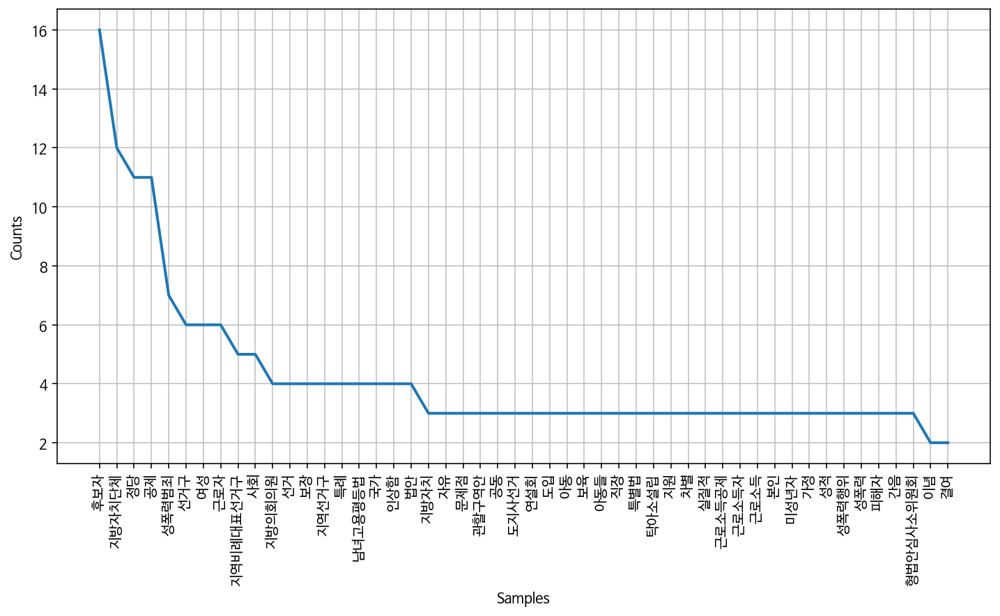

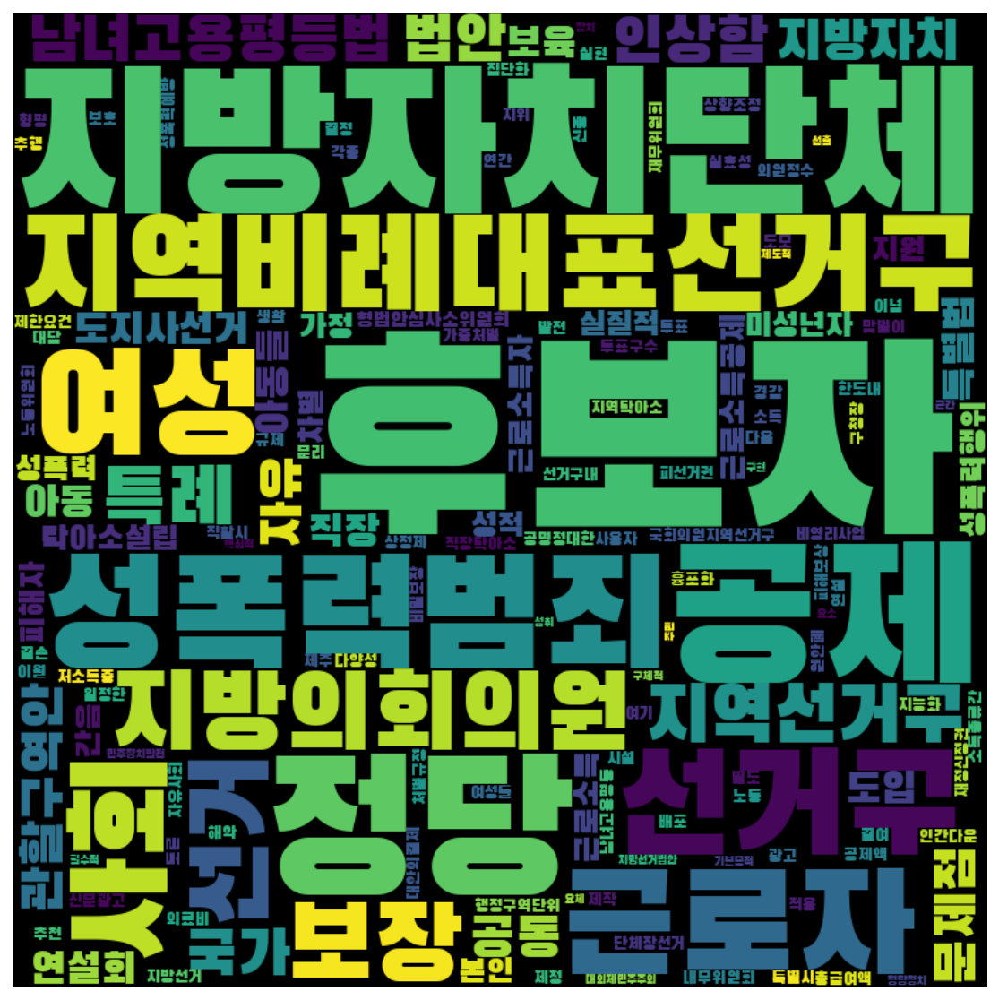

In [83]:
frewords_vis(progressive_word)
wordcloud_vis(progressive_word)

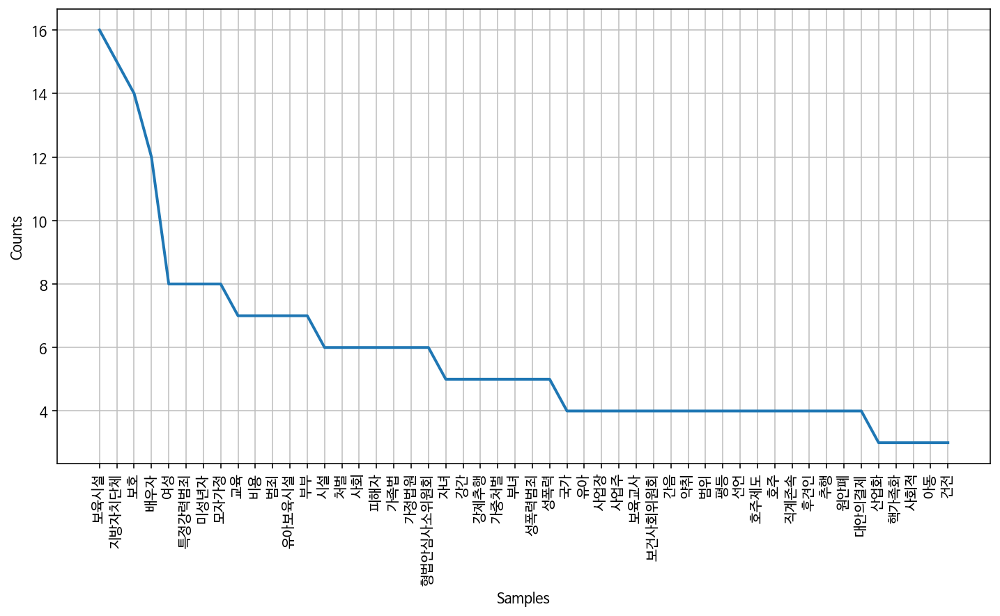

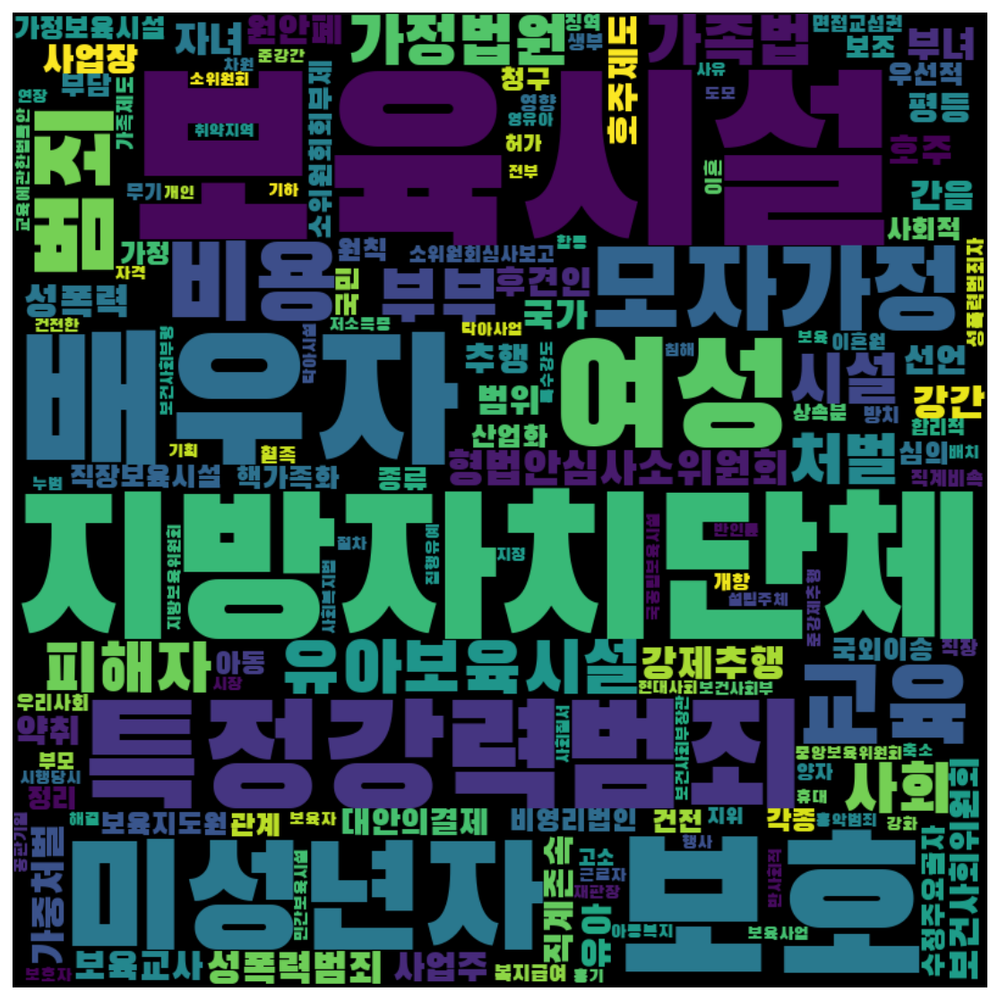

In [84]:
frewords_vis(conservative_word)
wordcloud_vis(conservative_word)

## 김영삼 정권 
- 1993.02.25 ~ 1998.02.24

In [85]:
kimyoungsam = gender[(gender['제안일자'] > datetime.date(1993,2,25)) & 
                        (gender['제안일자'] < datetime.date(1998,2,24))]
kimyoungsam.shape

(62, 19)

In [86]:
kimyoungsam['정당성향'].value_counts()

진보    22
보수    18
Name: 정당성향, dtype: int64

In [87]:
pd.DataFrame(kimyoungsam.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성    9
     여성    9
진보   남성   16
     여성    6

In [88]:
progressive = kimyoungsam[kimyoungsam['정당성향'] == '진보']
conservative = kimyoungsam[kimyoungsam['정당성향'] == '보수']

In [89]:
model_progressive = Word2Vec(progressive['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)
model_conservative = Word2Vec(conservative['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)

2020-10-13 21:50:30,258 : INFO : collecting all words and their counts
2020-10-13 21:50:30,260 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-13 21:50:30,264 : INFO : collected 1519 word types from a corpus of 2780 raw words and 22 sentences
2020-10-13 21:50:30,265 : INFO : Loading a fresh vocabulary
2020-10-13 21:50:30,267 : INFO : effective_min_count=10 retains 20 unique words (1% of original 1519, drops 1499)
2020-10-13 21:50:30,269 : INFO : effective_min_count=10 leaves 321 word corpus (11% of original 2780, drops 2459)
2020-10-13 21:50:30,271 : INFO : deleting the raw counts dictionary of 1519 items
2020-10-13 21:50:30,274 : INFO : sample=0.001 downsamples 20 most-common words
2020-10-13 21:50:30,275 : INFO : downsampling leaves estimated 51 word corpus (15.9% of prior 321)
2020-10-13 21:50:30,276 : INFO : estimated required memory for 20 words and 100 dimensions: 26000 bytes
2020-10-13 21:50:30,277 : INFO : resetting layer weights
2020-10-13 21

2020-10-13 21:50:30,470 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:30,476 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:30,479 : INFO : EPOCH - 15 : training on 2780 raw words (65 effective words) took 0.0s, 4013 effective words/s
2020-10-13 21:50:30,491 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:30,496 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:30,497 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:30,498 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:30,499 : INFO : EPOCH - 16 : training on 2780 raw words (55 effective words) took 0.0s, 4078 effective words/s
2020-10-13 21:50:30,505 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:30,507 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50

2020-10-13 21:50:30,746 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:30,747 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:30,749 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:30,750 : INFO : EPOCH - 32 : training on 2780 raw words (53 effective words) took 0.0s, 7371 effective words/s
2020-10-13 21:50:30,753 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:30,754 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:30,756 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:30,758 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:30,759 : INFO : EPOCH - 33 : training on 2780 raw words (38 effective words) took 0.0s, 5854 effective words/s
2020-10-13 21:50:30,767 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50

2020-10-13 21:50:31,011 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:31,020 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:31,024 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:31,025 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:31,027 : INFO : EPOCH - 49 : training on 2780 raw words (45 effective words) took 0.0s, 2766 effective words/s
2020-10-13 21:50:31,037 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:31,038 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:31,039 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:31,041 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:31,043 : INFO : EPOCH - 50 : training on 2780 raw words (49 effective words) took 0.0s, 8411 effective words/s
2020-10-13 21:50

2020-10-13 21:50:31,208 : INFO : EPOCH - 65 : training on 2780 raw words (49 effective words) took 0.0s, 15134 effective words/s
2020-10-13 21:50:31,212 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:31,213 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:31,214 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:31,214 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:31,215 : INFO : EPOCH - 66 : training on 2780 raw words (53 effective words) took 0.0s, 17136 effective words/s
2020-10-13 21:50:31,219 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:31,220 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:31,221 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:31,222 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:

2020-10-13 21:50:31,387 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:31,389 : INFO : EPOCH - 82 : training on 2780 raw words (48 effective words) took 0.0s, 5259 effective words/s
2020-10-13 21:50:31,392 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:31,394 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:31,396 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:31,397 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:31,399 : INFO : EPOCH - 83 : training on 2780 raw words (56 effective words) took 0.0s, 7684 effective words/s
2020-10-13 21:50:31,403 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:31,406 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:31,407 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50

2020-10-13 21:50:31,682 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:31,683 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:31,684 : INFO : EPOCH - 99 : training on 2780 raw words (48 effective words) took 0.0s, 9561 effective words/s
2020-10-13 21:50:31,688 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:31,689 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:31,691 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:31,694 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:31,698 : INFO : EPOCH - 100 : training on 2780 raw words (66 effective words) took 0.0s, 5909 effective words/s
2020-10-13 21:50:31,699 : INFO : training on a 278000 raw words (5181 effective words) took 1.4s, 3671 effective words/s
2020-10-13 21:50:31,701 : INFO : collecting all words and their counts
2020-

2020-10-13 21:50:31,961 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:31,965 : INFO : EPOCH - 13 : training on 1904 raw words (40 effective words) took 0.0s, 2430 effective words/s
2020-10-13 21:50:31,970 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:31,972 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:31,974 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:31,981 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:31,984 : INFO : EPOCH - 14 : training on 1904 raw words (39 effective words) took 0.0s, 2760 effective words/s
2020-10-13 21:50:31,988 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:31,991 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:31,992 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50

2020-10-13 21:50:32,188 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:32,189 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:32,190 : INFO : EPOCH - 30 : training on 1904 raw words (35 effective words) took 0.0s, 5121 effective words/s
2020-10-13 21:50:32,194 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:32,196 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:32,198 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:32,199 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:32,202 : INFO : EPOCH - 31 : training on 1904 raw words (36 effective words) took 0.0s, 4081 effective words/s
2020-10-13 21:50:32,211 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:32,217 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50

2020-10-13 21:50:32,442 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:32,443 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:32,445 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:32,447 : INFO : EPOCH - 47 : training on 1904 raw words (39 effective words) took 0.0s, 4770 effective words/s
2020-10-13 21:50:32,449 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:32,451 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:32,453 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:32,454 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:32,456 : INFO : EPOCH - 48 : training on 1904 raw words (42 effective words) took 0.0s, 6236 effective words/s
2020-10-13 21:50:32,458 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50

2020-10-13 21:50:32,621 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:32,623 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:32,624 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:32,625 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:32,626 : INFO : EPOCH - 64 : training on 1904 raw words (36 effective words) took 0.0s, 6779 effective words/s
2020-10-13 21:50:32,629 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:32,631 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:32,633 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:32,635 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:32,637 : INFO : EPOCH - 65 : training on 1904 raw words (36 effective words) took 0.0s, 4780 effective words/s
2020-10-13 21:50

2020-10-13 21:50:32,786 : INFO : EPOCH - 80 : training on 1904 raw words (47 effective words) took 0.0s, 7854 effective words/s
2020-10-13 21:50:32,791 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:32,792 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:32,794 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:32,795 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:32,796 : INFO : EPOCH - 81 : training on 1904 raw words (42 effective words) took 0.0s, 8141 effective words/s
2020-10-13 21:50:32,800 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:32,801 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:32,802 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:32,803 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50

2020-10-13 21:50:32,968 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:32,969 : INFO : EPOCH - 97 : training on 1904 raw words (34 effective words) took 0.0s, 4311 effective words/s
2020-10-13 21:50:32,974 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:32,976 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:32,978 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50:32,980 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:50:32,982 : INFO : EPOCH - 98 : training on 1904 raw words (45 effective words) took 0.0s, 5975 effective words/s
2020-10-13 21:50:32,985 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:50:32,986 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:50:32,987 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:50

In [90]:
print(model_progressive.wv.most_similar('여성'))
print(model_conservative.wv.most_similar('여성'))

2020-10-13 21:50:33,016 : INFO : precomputing L2-norms of word weight vectors
2020-10-13 21:50:33,018 : INFO : precomputing L2-norms of word weight vectors


[('확보', 0.9990018606185913), ('범위', 0.9986916780471802), ('강화', 0.9985756278038025), ('기능', 0.9984340667724609), ('규정함', 0.9983761310577393), ('청소년보호법', 0.9977728128433228), ('청소년', 0.9972853064537048), ('퇴직', 0.9971379041671753), ('지방자치단체', 0.9971276521682739), ('개편', 0.9954268932342529)]
[('예방', 0.999653697013855), ('성폭력', 0.9996278285980225), ('직장내', 0.9995925426483154), ('실효성', 0.999585747718811), ('위반', 0.999577522277832), ('피해자', 0.9995768070220947), ('지방자치단체', 0.9995555281639099), ('강화', 0.9995340704917908), ('신설', 0.9995301365852356), ('차별', 0.9995111227035522)]


In [91]:
progressive_word = total_tokens(progressive['tokens'])
conservative_word = total_tokens(conservative['tokens'])

In [95]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','퍼센트']
progressive_word = [each_word for each_word in progressive_word if each_word not in stopwords]
conservative_word = [each_word for each_word in conservative_word if each_word not in stopwords]

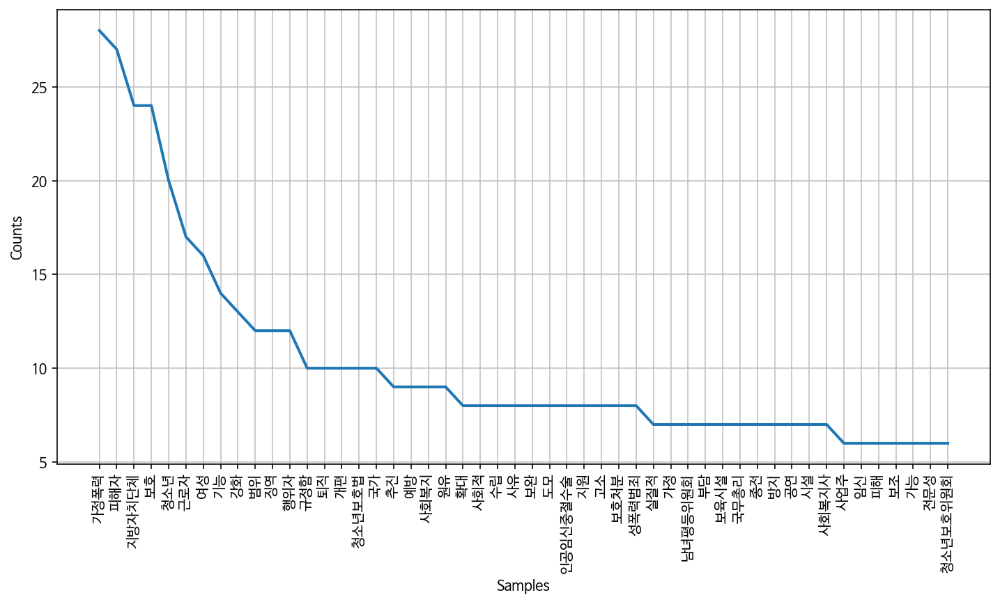

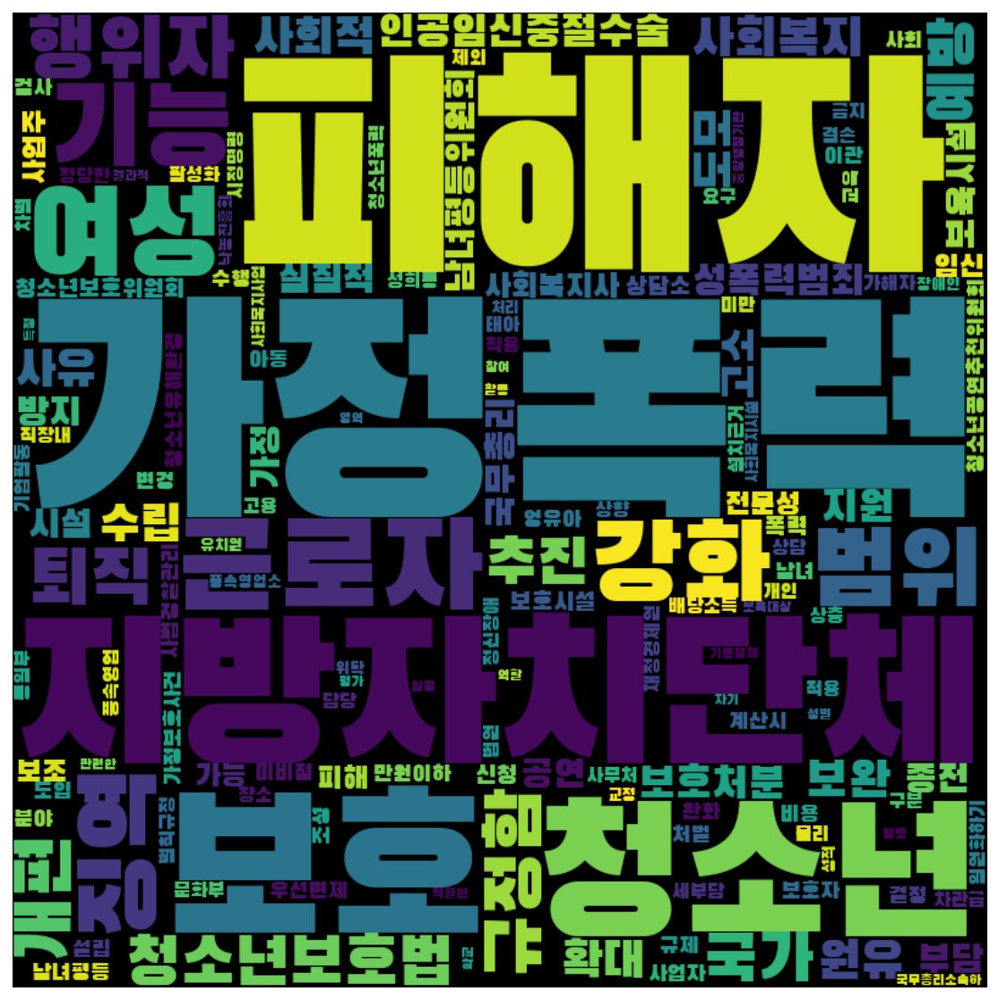

In [96]:
frewords_vis(progressive_word)
wordcloud_vis(progressive_word)

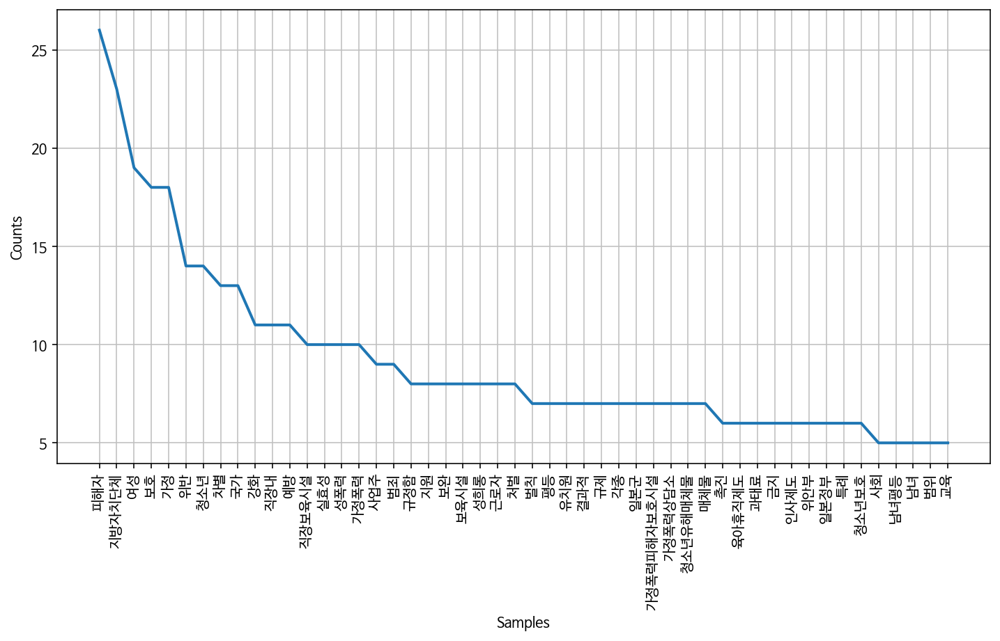

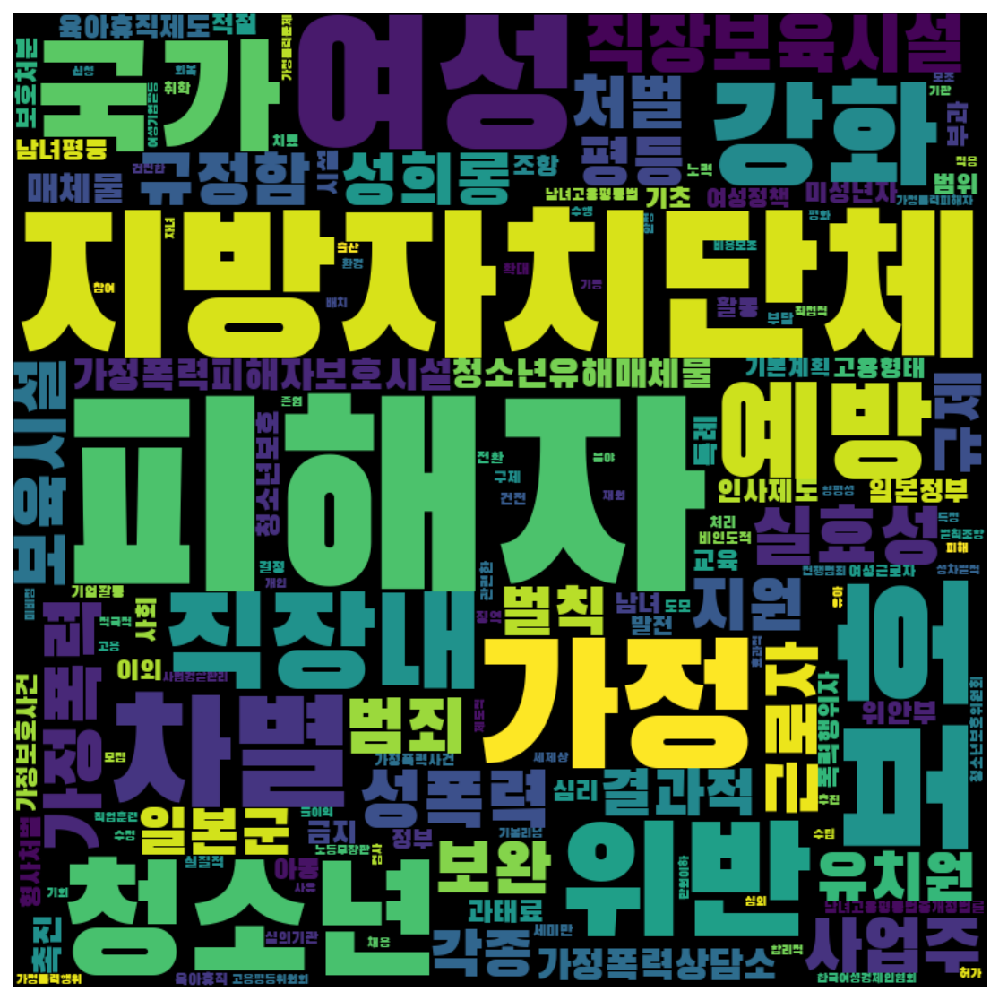

In [97]:
frewords_vis(conservative_word)
wordcloud_vis(conservative_word)

## 김대중 정권 
- 1998.02.25 ~ 2003.02.24

In [98]:
kimdaejoong = gender[(gender['제안일자'] > datetime.date(1998,2,25)) & 
                        (gender['제안일자'] < datetime.date(2003,2,24))]
kimdaejoong.shape

(92, 19)

In [99]:
kimdaejoong['정당성향'].value_counts()

보수    38
진보    14
Name: 정당성향, dtype: int64

In [100]:
pd.DataFrame(kimdaejoong.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성   22
     여성   16
진보   남성    7
     여성    7

In [101]:
progressive = kimdaejoong[kimdaejoong['정당성향'] == '진보']
conservative = kimdaejoong[kimdaejoong['정당성향'] == '보수']

In [102]:
model_progressive = Word2Vec(progressive['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)
model_conservative = Word2Vec(conservative['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)

2020-10-13 21:53:21,965 : INFO : collecting all words and their counts
2020-10-13 21:53:21,966 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-13 21:53:21,969 : INFO : collected 942 word types from a corpus of 2294 raw words and 14 sentences
2020-10-13 21:53:21,971 : INFO : Loading a fresh vocabulary
2020-10-13 21:53:21,972 : INFO : effective_min_count=10 retains 20 unique words (2% of original 942, drops 922)
2020-10-13 21:53:21,973 : INFO : effective_min_count=10 leaves 499 word corpus (21% of original 2294, drops 1795)
2020-10-13 21:53:21,975 : INFO : deleting the raw counts dictionary of 942 items
2020-10-13 21:53:21,976 : INFO : sample=0.001 downsamples 20 most-common words
2020-10-13 21:53:21,977 : INFO : downsampling leaves estimated 74 word corpus (14.9% of prior 499)
2020-10-13 21:53:21,980 : INFO : estimated required memory for 20 words and 100 dimensions: 26000 bytes
2020-10-13 21:53:21,981 : INFO : resetting layer weights
2020-10-13 21:53:

2020-10-13 21:53:22,146 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:22,147 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:22,148 : INFO : EPOCH - 15 : training on 2294 raw words (78 effective words) took 0.0s, 17605 effective words/s
2020-10-13 21:53:22,151 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:22,153 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:22,154 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:22,155 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:22,156 : INFO : EPOCH - 16 : training on 2294 raw words (78 effective words) took 0.0s, 16556 effective words/s
2020-10-13 21:53:22,160 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:22,161 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:

2020-10-13 21:53:22,416 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:22,418 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:22,420 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:22,422 : INFO : EPOCH - 32 : training on 2294 raw words (75 effective words) took 0.0s, 6890 effective words/s
2020-10-13 21:53:22,426 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:22,427 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:22,428 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:22,430 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:22,432 : INFO : EPOCH - 33 : training on 2294 raw words (69 effective words) took 0.0s, 10894 effective words/s
2020-10-13 21:53:22,436 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:5

2020-10-13 21:53:22,602 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:22,604 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:22,606 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:22,610 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:22,612 : INFO : EPOCH - 49 : training on 2294 raw words (76 effective words) took 0.0s, 8232 effective words/s
2020-10-13 21:53:22,615 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:22,616 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:22,617 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:22,618 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:22,619 : INFO : EPOCH - 50 : training on 2294 raw words (90 effective words) took 0.0s, 21757 effective words/s
2020-10-13 21:5

2020-10-13 21:53:22,824 : INFO : EPOCH - 65 : training on 2294 raw words (77 effective words) took 0.0s, 8599 effective words/s
2020-10-13 21:53:22,842 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:22,845 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:22,849 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:22,866 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:22,870 : INFO : EPOCH - 66 : training on 2294 raw words (75 effective words) took 0.0s, 2691 effective words/s
2020-10-13 21:53:22,875 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:22,876 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:22,878 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:22,884 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53

2020-10-13 21:53:23,109 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:23,110 : INFO : EPOCH - 82 : training on 2294 raw words (82 effective words) took 0.0s, 14373 effective words/s
2020-10-13 21:53:23,116 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:23,117 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:23,119 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:23,120 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:23,121 : INFO : EPOCH - 83 : training on 2294 raw words (68 effective words) took 0.0s, 12248 effective words/s
2020-10-13 21:53:23,125 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:23,128 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:23,129 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:

2020-10-13 21:53:23,334 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:23,336 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:23,338 : INFO : EPOCH - 99 : training on 2294 raw words (81 effective words) took 0.0s, 10819 effective words/s
2020-10-13 21:53:23,348 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:23,352 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:23,365 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:23,369 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:23,370 : INFO : EPOCH - 100 : training on 2294 raw words (72 effective words) took 0.0s, 3327 effective words/s
2020-10-13 21:53:23,371 : INFO : training on a 229400 raw words (7494 effective words) took 1.4s, 5432 effective words/s
2020-10-13 21:53:23,374 : INFO : collecting all words and their counts
2020

2020-10-13 21:53:23,618 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:23,619 : INFO : EPOCH - 13 : training on 3559 raw words (133 effective words) took 0.0s, 22891 effective words/s
2020-10-13 21:53:23,623 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:23,626 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:23,628 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:23,630 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:23,632 : INFO : EPOCH - 14 : training on 3559 raw words (144 effective words) took 0.0s, 16145 effective words/s
2020-10-13 21:53:23,638 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:23,640 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:23,643 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 2

2020-10-13 21:53:23,801 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:23,802 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:23,803 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:23,805 : INFO : EPOCH - 30 : training on 3559 raw words (143 effective words) took 0.0s, 27626 effective words/s
2020-10-13 21:53:23,811 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:23,812 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:23,813 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:23,814 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:23,815 : INFO : EPOCH - 31 : training on 3559 raw words (126 effective words) took 0.0s, 29814 effective words/s
2020-10-13 21:53:23,818 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 2

2020-10-13 21:53:23,989 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:23,990 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:23,991 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:23,993 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:23,994 : INFO : EPOCH - 47 : training on 3559 raw words (126 effective words) took 0.0s, 22739 effective words/s
2020-10-13 21:53:23,998 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:23,999 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:24,002 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:24,004 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:24,006 : INFO : EPOCH - 48 : training on 3559 raw words (118 effective words) took 0.0s, 14799 effective words/s
2020-10-13 2

2020-10-13 21:53:24,167 : INFO : EPOCH - 63 : training on 3559 raw words (151 effective words) took 0.0s, 20178 effective words/s
2020-10-13 21:53:24,172 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:24,173 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:24,175 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:24,176 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:24,177 : INFO : EPOCH - 64 : training on 3559 raw words (149 effective words) took 0.0s, 27368 effective words/s
2020-10-13 21:53:24,180 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:24,181 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:24,182 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:24,183 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 2

2020-10-13 21:53:24,353 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:24,354 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:24,355 : INFO : EPOCH - 80 : training on 3559 raw words (127 effective words) took 0.0s, 19576 effective words/s
2020-10-13 21:53:24,359 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:24,360 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:24,364 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:24,366 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:24,368 : INFO : EPOCH - 81 : training on 3559 raw words (146 effective words) took 0.0s, 16179 effective words/s
2020-10-13 21:53:24,373 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:24,374 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 2

2020-10-13 21:53:24,741 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:24,742 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:24,744 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:24,745 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:24,756 : INFO : EPOCH - 97 : training on 3559 raw words (145 effective words) took 0.0s, 9880 effective words/s
2020-10-13 21:53:24,766 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:53:24,772 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:53:24,776 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:53:24,783 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:53:24,790 : INFO : EPOCH - 98 : training on 3559 raw words (128 effective words) took 0.0s, 5382 effective words/s
2020-10-13 21:

In [104]:
# 진보 14건이라 여성 10회 이하라 나오지 않음
#print(model_progressive.wv.most_similar('여성'))
print(model_conservative.wv.most_similar('여성'))

2020-10-13 21:53:33,167 : INFO : precomputing L2-norms of word weight vectors


[('선출', 0.9333212971687317), ('강화', 0.912263810634613), ('모성보호급여', 0.9101728200912476), ('신설', 0.9090704321861267), ('산전후', 0.9057848453521729), ('공직선거후보자', 0.9021334052085876), ('허용', 0.8946938514709473), ('추천', 0.8907930850982666), ('근속기간', 0.8823678493499756), ('휴직기간', 0.878730297088623)]


In [105]:
progressive_word = total_tokens(progressive['tokens'])
conservative_word = total_tokens(conservative['tokens'])

In [106]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
progressive_word = [each_word for each_word in progressive_word if each_word not in stopwords]
conservative_word = [each_word for each_word in conservative_word if each_word not in stopwords]

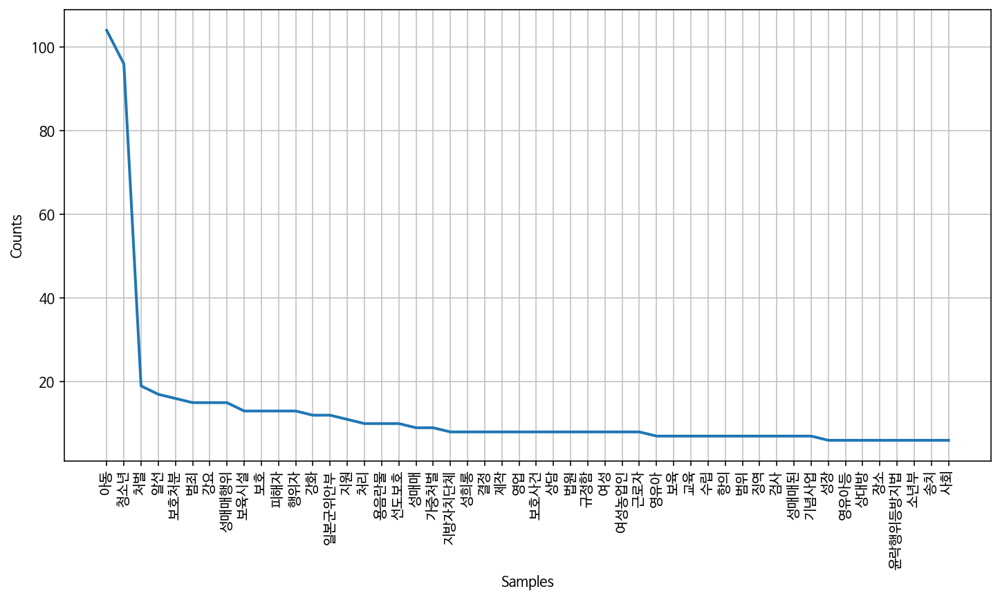

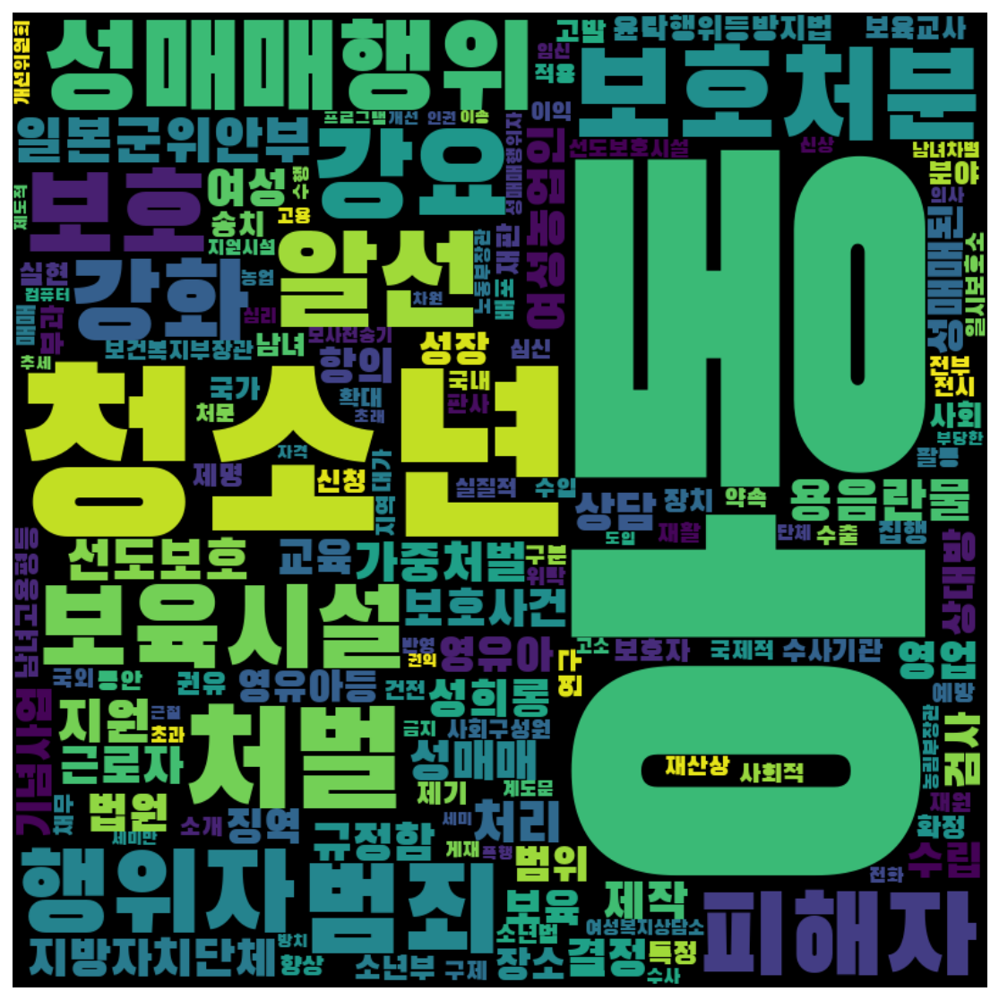

In [107]:
frewords_vis(progressive_word)
wordcloud_vis(progressive_word)

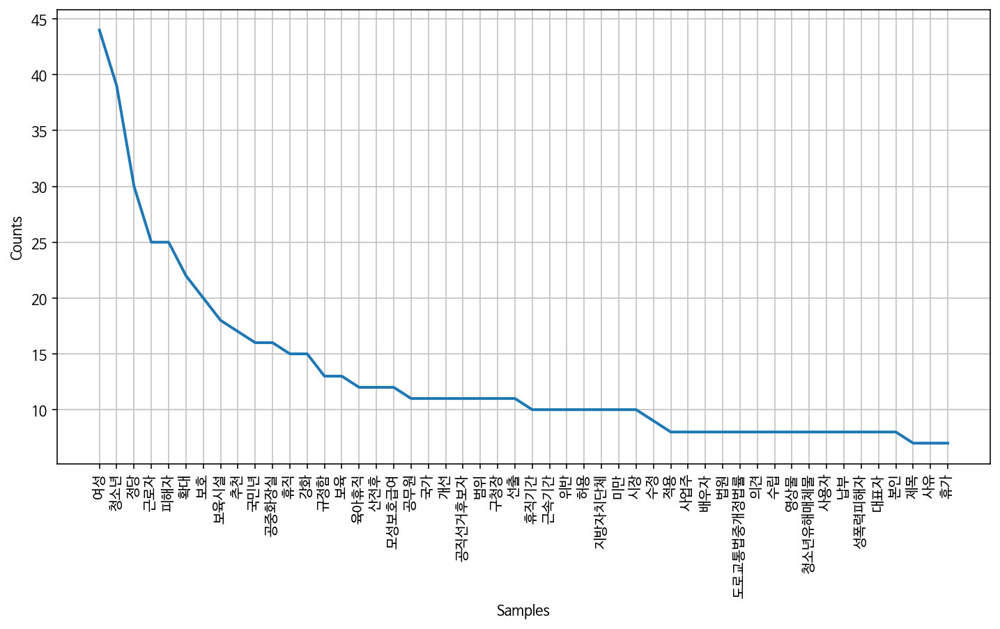

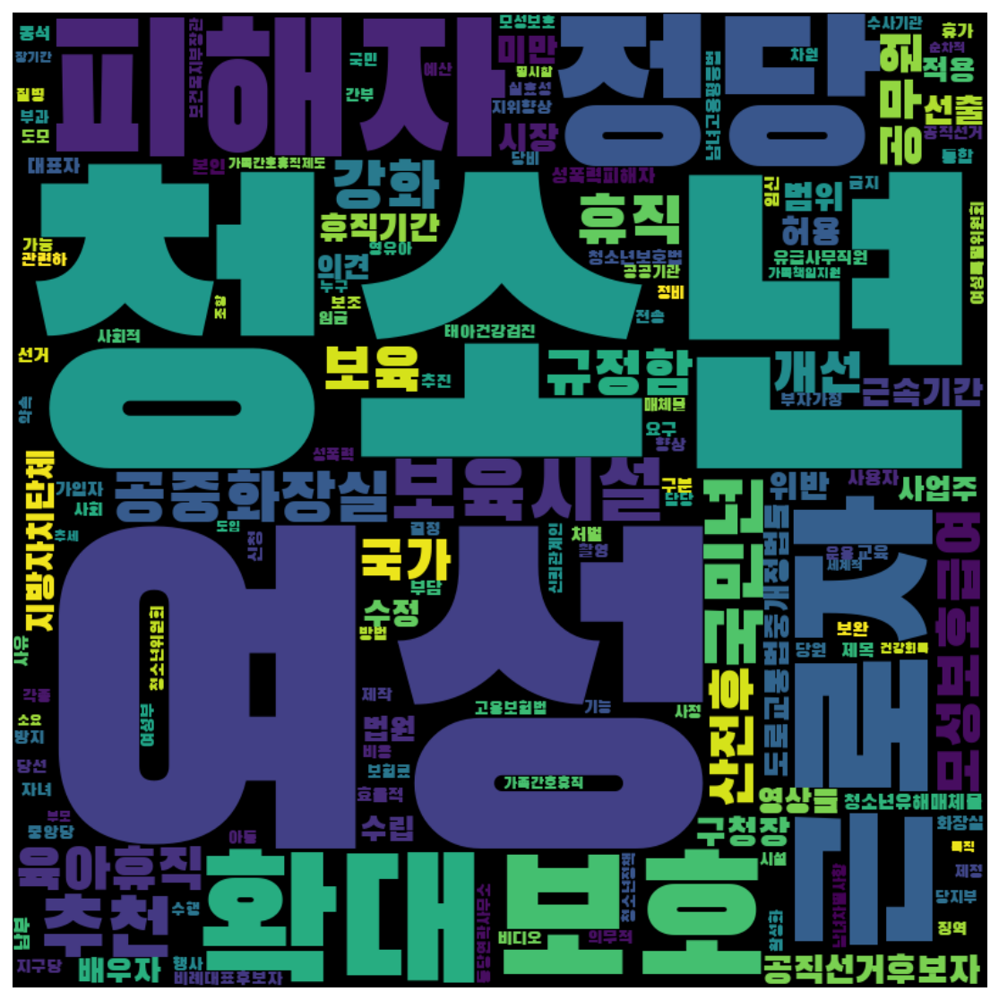

In [108]:
frewords_vis(conservative_word)
wordcloud_vis(conservative_word)

## 노무현 정권  
- 2003.02.25 ~ 2004.04.14

In [109]:
romoohyun = gender[(gender['제안일자'] > datetime.date(2003,2,25)) & 
                        (gender['제안일자'] < datetime.date(2008,2,24))]
romoohyun.shape

(454, 19)

In [110]:
romoohyun['정당성향'].value_counts()

보수    183
진보    162
Name: 정당성향, dtype: int64

In [111]:
pd.DataFrame(romoohyun.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성   86
     여성   97
진보   남성   77
     여성   85

In [112]:
progressive = romoohyun[romoohyun['정당성향'] == '진보']
conservative = romoohyun[romoohyun['정당성향'] == '보수']

In [113]:
model_progressive = Word2Vec(progressive['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)
model_conservative = Word2Vec(conservative['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)

2020-10-13 21:55:46,996 : INFO : collecting all words and their counts
2020-10-13 21:55:46,999 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-13 21:55:47,008 : INFO : collected 4339 word types from a corpus of 16128 raw words and 162 sentences
2020-10-13 21:55:47,009 : INFO : Loading a fresh vocabulary
2020-10-13 21:55:47,013 : INFO : effective_min_count=10 retains 323 unique words (7% of original 4339, drops 4016)
2020-10-13 21:55:47,015 : INFO : effective_min_count=10 leaves 7381 word corpus (45% of original 16128, drops 8747)
2020-10-13 21:55:47,018 : INFO : deleting the raw counts dictionary of 4339 items
2020-10-13 21:55:47,019 : INFO : sample=0.001 downsamples 117 most-common words
2020-10-13 21:55:47,020 : INFO : downsampling leaves estimated 5507 word corpus (74.6% of prior 7381)
2020-10-13 21:55:47,022 : INFO : estimated required memory for 323 words and 100 dimensions: 419900 bytes
2020-10-13 21:55:47,023 : INFO : resetting layer weights
20

2020-10-13 21:55:47,445 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:47,447 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:47,448 : INFO : EPOCH - 15 : training on 16128 raw words (5485 effective words) took 0.0s, 530666 effective words/s
2020-10-13 21:55:47,459 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:47,466 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:47,468 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:47,469 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:47,470 : INFO : EPOCH - 16 : training on 16128 raw words (5502 effective words) took 0.0s, 440310 effective words/s
2020-10-13 21:55:47,479 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:47,486 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-13 21:55:47,824 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:47,832 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:47,837 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:47,838 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:47,839 : INFO : EPOCH - 32 : training on 16128 raw words (5463 effective words) took 0.0s, 346544 effective words/s
2020-10-13 21:55:47,854 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:47,855 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:47,857 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:47,860 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:47,864 : INFO : EPOCH - 33 : training on 16128 raw words (5533 effective words) took 0.0s, 565262 effective words/s
2020-1

2020-10-13 21:55:48,173 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:48,175 : INFO : EPOCH - 48 : training on 16128 raw words (5479 effective words) took 0.0s, 435947 effective words/s
2020-10-13 21:55:48,184 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:48,187 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:48,191 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:48,192 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:48,194 : INFO : EPOCH - 49 : training on 16128 raw words (5471 effective words) took 0.0s, 578010 effective words/s
2020-10-13 21:55:48,203 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:48,208 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:48,209 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-13 21:55:48,528 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:48,530 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:48,532 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:48,533 : INFO : EPOCH - 65 : training on 16128 raw words (5505 effective words) took 0.0s, 637033 effective words/s
2020-10-13 21:55:48,542 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:48,545 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:48,547 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:48,548 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:48,549 : INFO : EPOCH - 66 : training on 16128 raw words (5498 effective words) took 0.0s, 431395 effective words/s
2020-10-13 21:55:48,558 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-13 21:55:48,801 : INFO : EPOCH - 81 : training on 16128 raw words (5522 effective words) took 0.0s, 378221 effective words/s
2020-10-13 21:55:48,807 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:48,810 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:48,813 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:48,815 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:48,818 : INFO : EPOCH - 82 : training on 16128 raw words (5485 effective words) took 0.0s, 518976 effective words/s
2020-10-13 21:55:48,833 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:48,838 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:48,840 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:48,842 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-13 21:55:49,199 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:49,202 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:49,204 : INFO : EPOCH - 98 : training on 16128 raw words (5533 effective words) took 0.0s, 247827 effective words/s
2020-10-13 21:55:49,209 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:49,214 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:49,216 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:49,218 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:49,219 : INFO : EPOCH - 99 : training on 16128 raw words (5554 effective words) took 0.0s, 435383 effective words/s
2020-10-13 21:55:49,229 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:49,237 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-13 21:55:49,637 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:49,640 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:49,642 : INFO : EPOCH - 12 : training on 14463 raw words (4591 effective words) took 0.0s, 442742 effective words/s
2020-10-13 21:55:49,653 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:49,657 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:49,660 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:49,662 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:49,663 : INFO : EPOCH - 13 : training on 14463 raw words (4645 effective words) took 0.0s, 472340 effective words/s
2020-10-13 21:55:49,673 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:49,677 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-13 21:55:49,971 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:49,979 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:49,979 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:49,982 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:49,986 : INFO : EPOCH - 29 : training on 14463 raw words (4639 effective words) took 0.0s, 278522 effective words/s
2020-10-13 21:55:49,998 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:50,001 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:50,005 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:50,014 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:50,022 : INFO : EPOCH - 30 : training on 14463 raw words (4607 effective words) took 0.0s, 193301 effective words/s
2020-1

2020-10-13 21:55:50,305 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:50,307 : INFO : EPOCH - 45 : training on 14463 raw words (4576 effective words) took 0.0s, 639588 effective words/s
2020-10-13 21:55:50,314 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:50,316 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:50,319 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:50,320 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:50,322 : INFO : EPOCH - 46 : training on 14463 raw words (4556 effective words) took 0.0s, 555604 effective words/s
2020-10-13 21:55:50,330 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:50,333 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:50,334 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-13 21:55:50,585 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:50,586 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:50,588 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:50,589 : INFO : EPOCH - 62 : training on 14463 raw words (4593 effective words) took 0.0s, 466114 effective words/s
2020-10-13 21:55:50,598 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:50,602 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:50,604 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:50,605 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:50,607 : INFO : EPOCH - 63 : training on 14463 raw words (4587 effective words) took 0.0s, 326883 effective words/s
2020-10-13 21:55:50,614 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-13 21:55:50,904 : INFO : EPOCH - 78 : training on 14463 raw words (4629 effective words) took 0.0s, 683727 effective words/s
2020-10-13 21:55:50,915 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:50,916 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:50,919 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:50,920 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:50,922 : INFO : EPOCH - 79 : training on 14463 raw words (4547 effective words) took 0.0s, 346356 effective words/s
2020-10-13 21:55:50,929 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:50,932 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:50,933 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:50,935 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-13 21:55:51,184 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:51,186 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:51,188 : INFO : EPOCH - 95 : training on 14463 raw words (4551 effective words) took 0.0s, 368479 effective words/s
2020-10-13 21:55:51,198 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:51,200 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 21:55:51,202 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 21:55:51,204 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 21:55:51,205 : INFO : EPOCH - 96 : training on 14463 raw words (4548 effective words) took 0.0s, 594787 effective words/s
2020-10-13 21:55:51,219 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 21:55:51,221 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

In [114]:
print(model_progressive.wv.most_similar('여성'))
print(model_conservative.wv.most_similar('여성'))

2020-10-13 21:55:51,354 : INFO : precomputing L2-norms of word weight vectors
2020-10-13 21:55:51,363 : INFO : precomputing L2-norms of word weight vectors


[('수준', 0.5343396067619324), ('여성근로자', 0.49714988470077515), ('경제활동', 0.49686574935913086), ('남성', 0.48711103200912476), ('임신', 0.4856303930282593), ('영유아', 0.480912446975708), ('참여', 0.47421491146087646), ('다양한', 0.4586959481239319), ('저출산', 0.4556083083152771), ('출산', 0.435503751039505)]
[('사회참여', 0.7764431834220886), ('남성', 0.7133530378341675), ('후보', 0.6277425289154053), ('모성보호', 0.5900609493255615), ('추천', 0.5896836519241333), ('육아', 0.5861806869506836), ('심각', 0.5856042504310608), ('참여', 0.5828116536140442), ('초래', 0.574823260307312), ('반영', 0.5323418378829956)]


In [115]:
# 문장 벡터 생성
def get_sentence_mean_vector(morphs, model):
    vector = []
    for i in morphs:
        try:
            vector.append(model.wv[i])
        except:
            pass
    try:
        return np.mean(vector, axis=0)
    except:
        pass
    
# 엘보우 함수
def elbow(X):
    sse = []
    for i in tqdm(range(1,15), desc = '엘보우'):
        km = KMeans(init='k-means++', n_clusters = i, random_state=0)
        km.fit(X)
        sse.append(km.inertia_)
        
    plt.plot(range(1,15), sse, marker='o')
    plt.xlabel("number of cluster")
    plt.ylabel("SSE")
    plt.show()

In [116]:
progressive['문장벡터'] = progressive['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_progressive))
conservative['문장벡터'] = conservative['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_conservative))

<ipython-input-116-7f57b9f27847>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  progressive['문장벡터'] = progressive['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_progressive))
<ipython-input-116-7f57b9f27847>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  conservative['문장벡터'] = conservative['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_conservative))


#### 진보

In [121]:
# K means 수행 
word_vectors_pro = progressive['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro)
progressive['category'] = idx

<ipython-input-121-b83bfee9be13>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  progressive['category'] = idx


In [122]:
progressive['category'].value_counts()

0    42
4    39
1    33
5    18
2    17
3    13
Name: category, dtype: int64

In [123]:
progressive_g1 = progressive[progressive['category'] == 0]
progressive_g2 = progressive[progressive['category'] == 1]
progressive_g3 = progressive[progressive['category'] == 2]
progressive_g4 = progressive[progressive['category'] == 3]
progressive_g5 = progressive[progressive['category'] == 4]
progressive_g6 = progressive[progressive['category'] == 5]

In [124]:
progressive_g1_tokens = total_tokens(progressive_g1['tokens'])
progressive_g2_tokens = total_tokens(progressive_g2['tokens'])
progressive_g3_tokens = total_tokens(progressive_g3['tokens'])
progressive_g4_tokens = total_tokens(progressive_g4['tokens'])
progressive_g5_tokens = total_tokens(progressive_g5['tokens'])
progressive_g6_tokens = total_tokens(progressive_g6['tokens'])

In [125]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
progressive_g1_tokens = [each_word for each_word in progressive_g1_tokens if each_word not in stopwords]
progressive_g2_tokens = [each_word for each_word in progressive_g2_tokens if each_word not in stopwords]
progressive_g3_tokens = [each_word for each_word in progressive_g3_tokens if each_word not in stopwords]
progressive_g4_tokens = [each_word for each_word in progressive_g4_tokens if each_word not in stopwords]
progressive_g5_tokens = [each_word for each_word in progressive_g5_tokens if each_word not in stopwords]
progressive_g6_tokens = [each_word for each_word in progressive_g6_tokens if each_word not in stopwords]

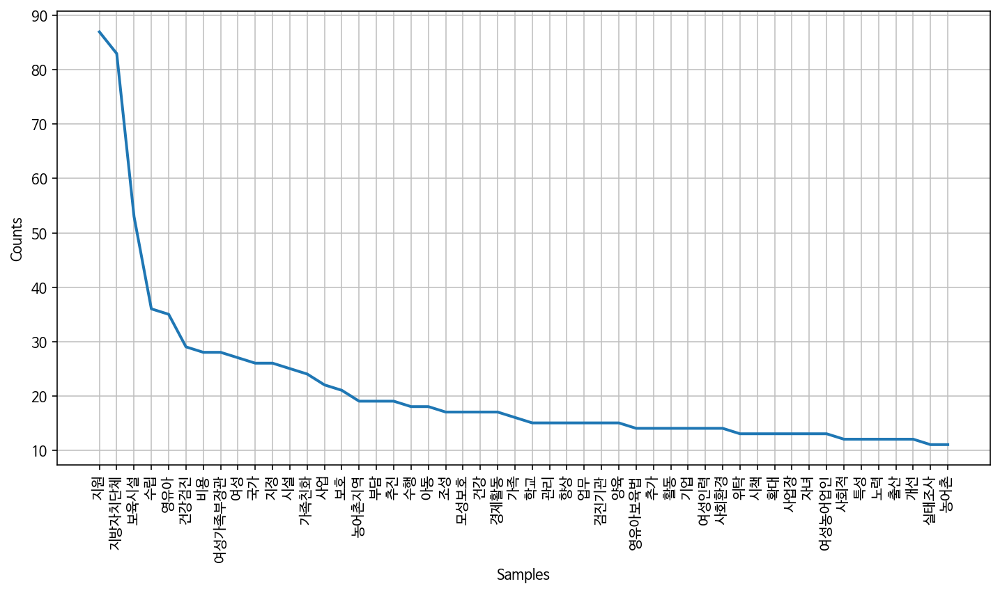

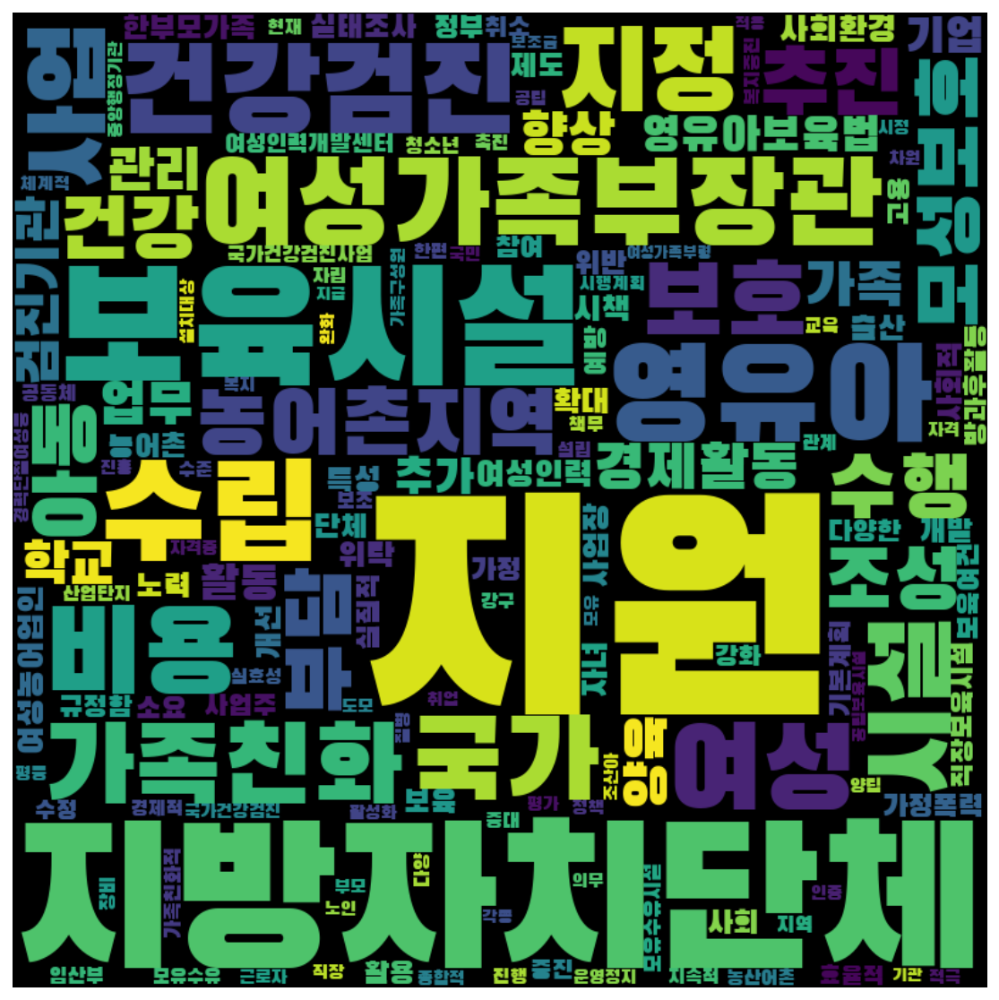

In [126]:
frewords_vis(progressive_g1_tokens)
wordcloud_vis(progressive_g1_tokens)

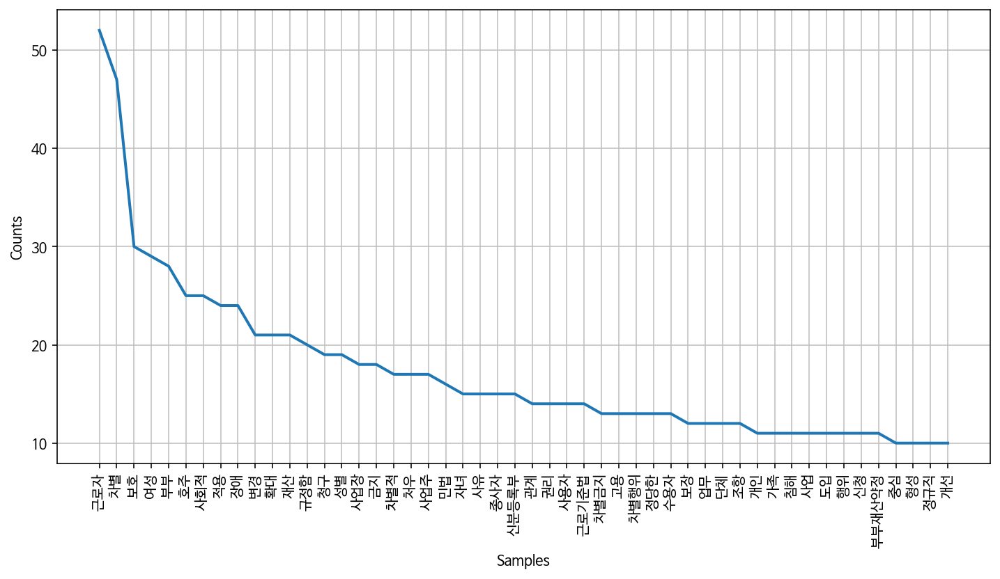

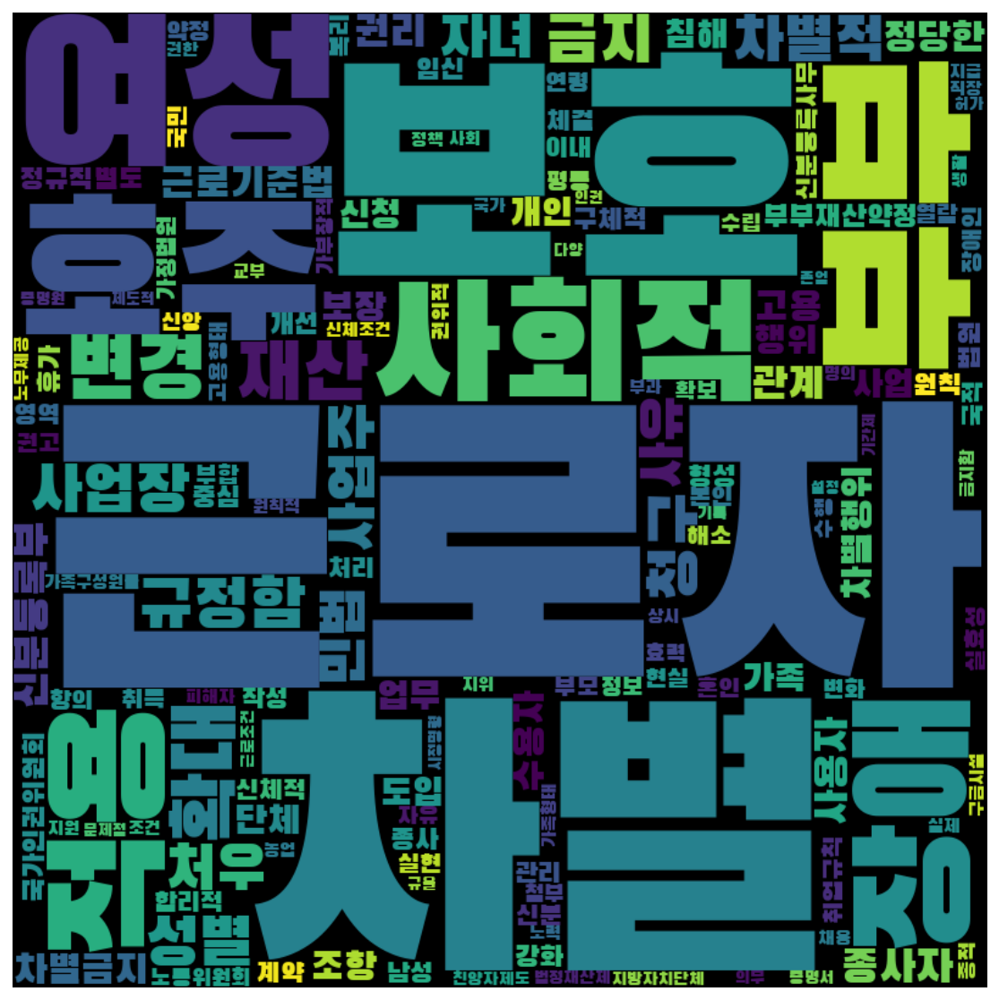

In [127]:
frewords_vis(progressive_g2_tokens)
wordcloud_vis(progressive_g2_tokens)

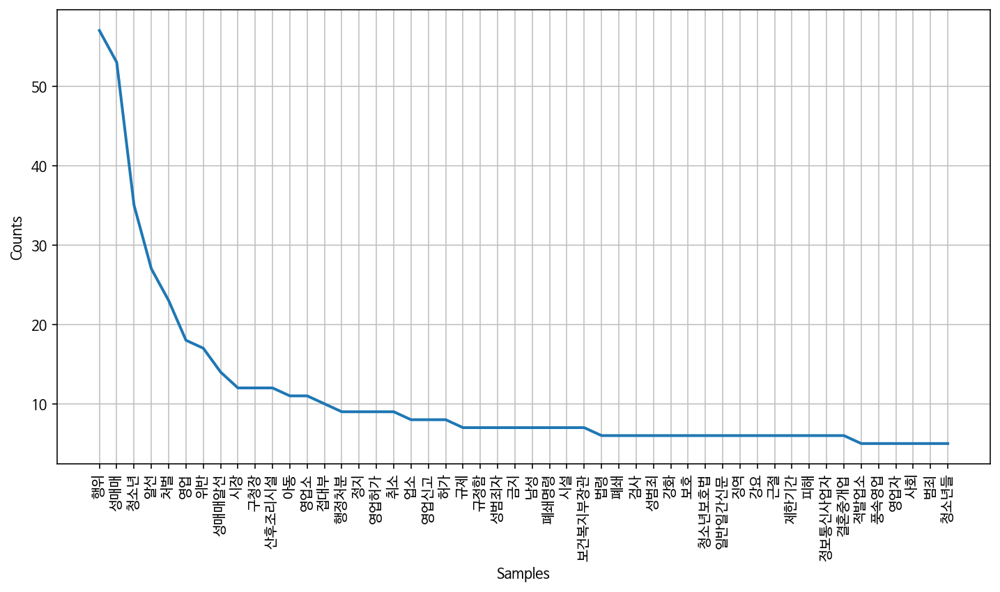

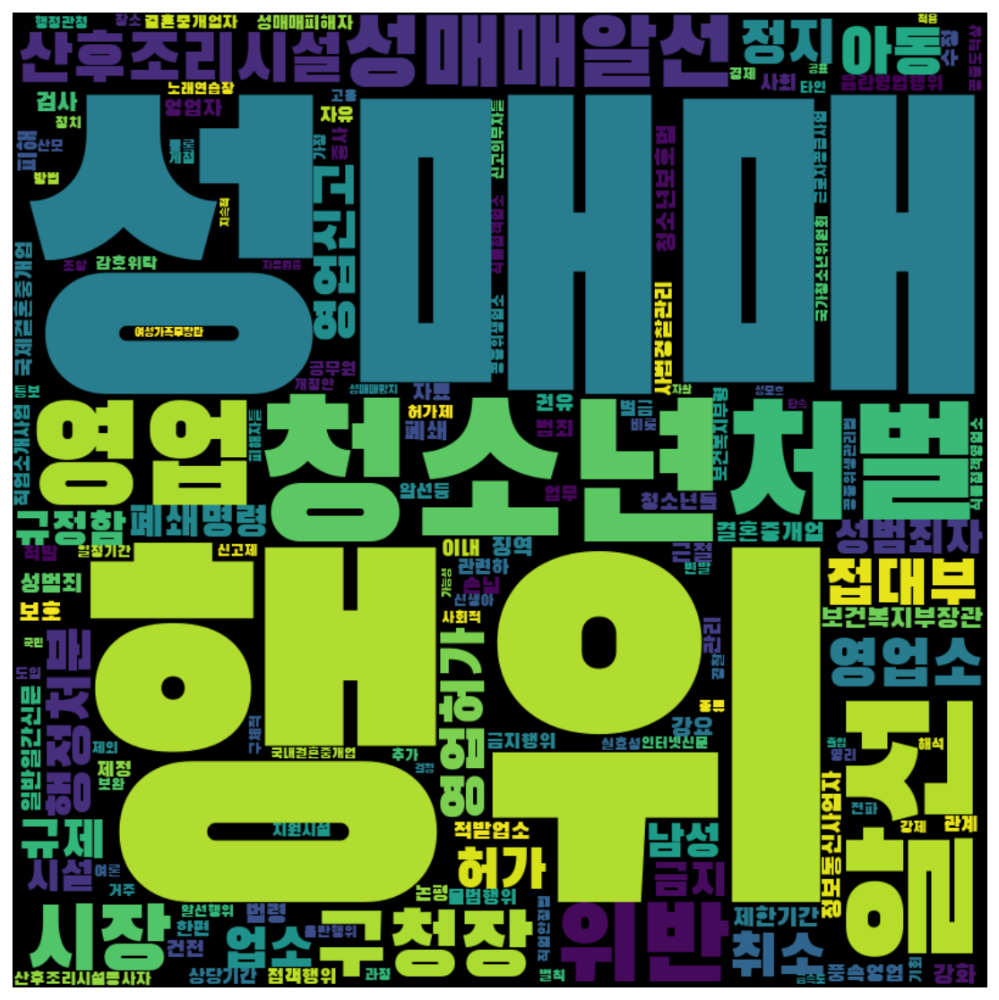

In [128]:
frewords_vis(progressive_g3_tokens)
wordcloud_vis(progressive_g3_tokens)

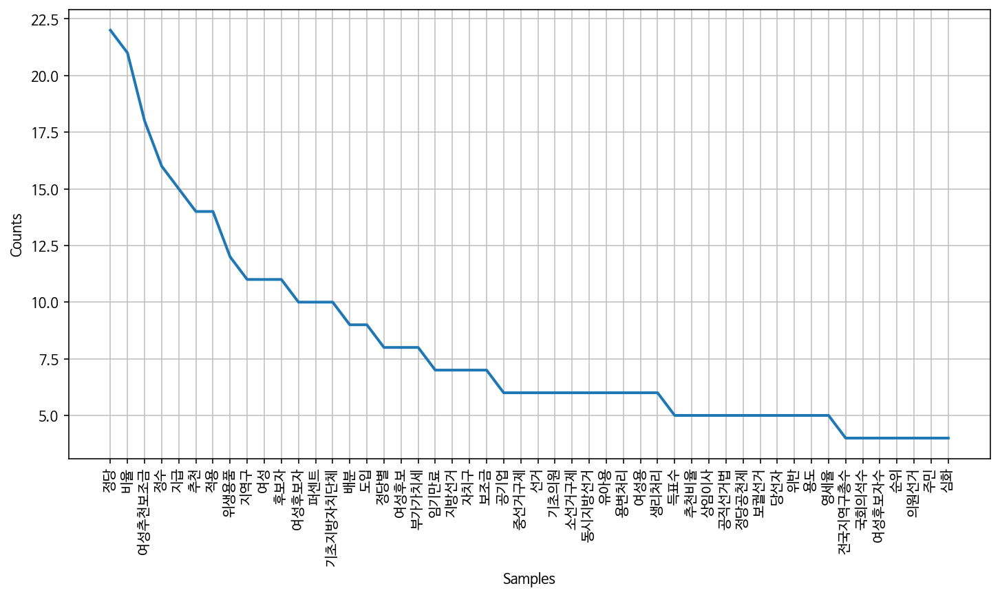

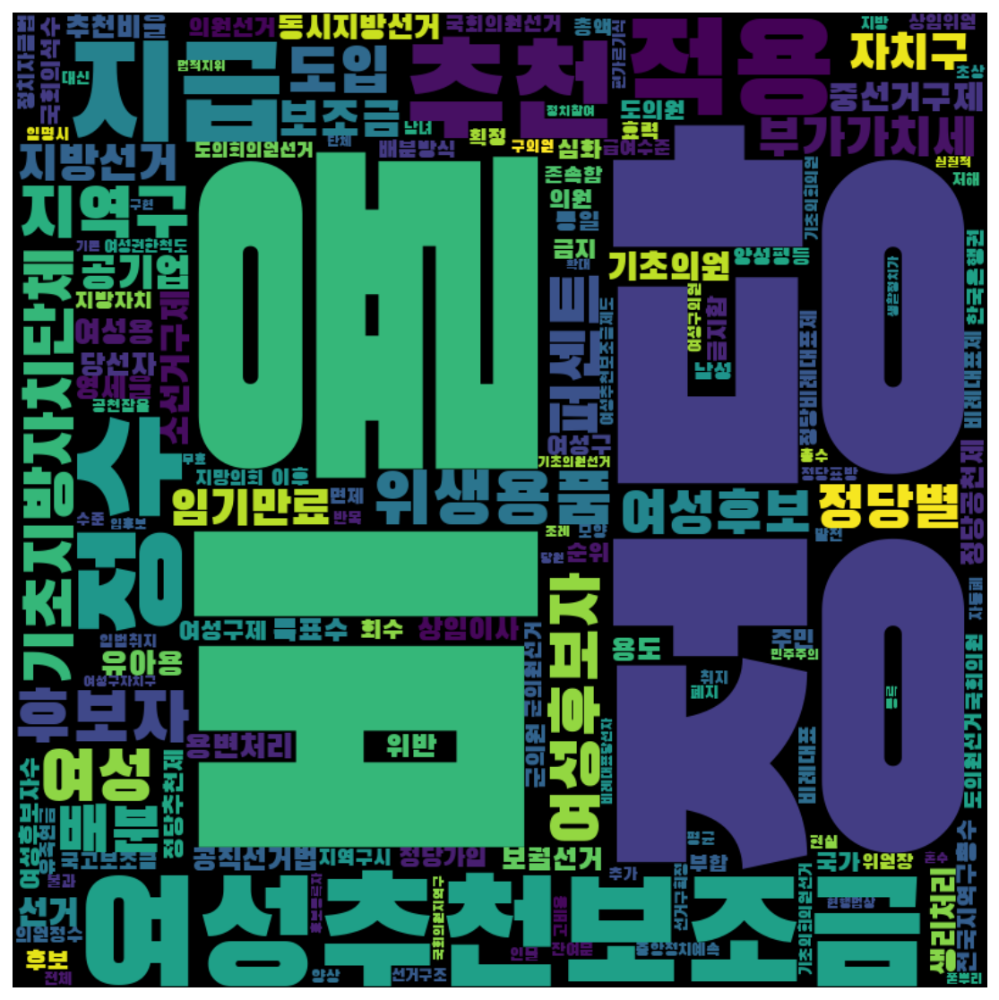

In [129]:
frewords_vis(progressive_g4_tokens)
wordcloud_vis(progressive_g4_tokens)

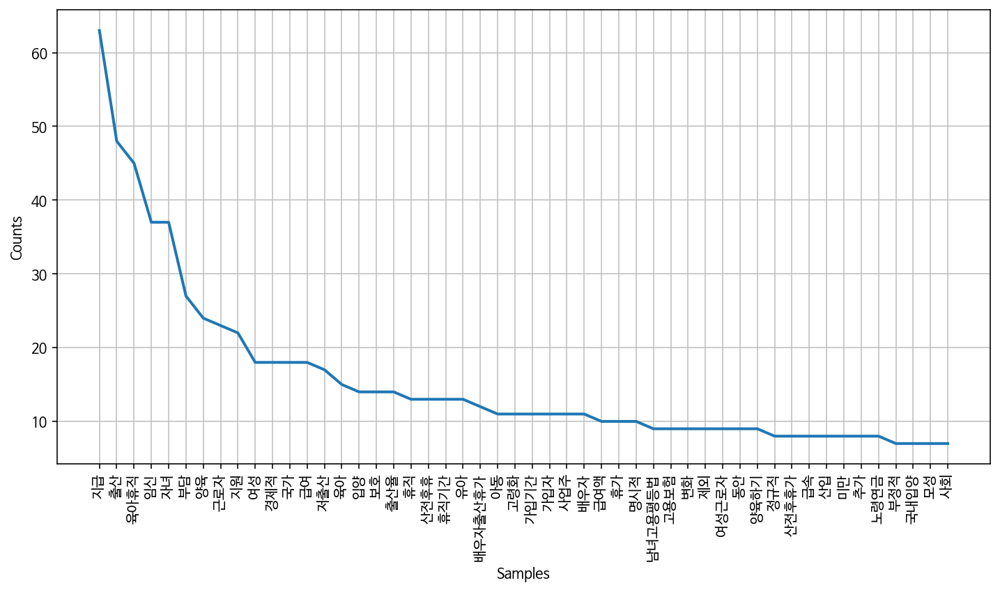

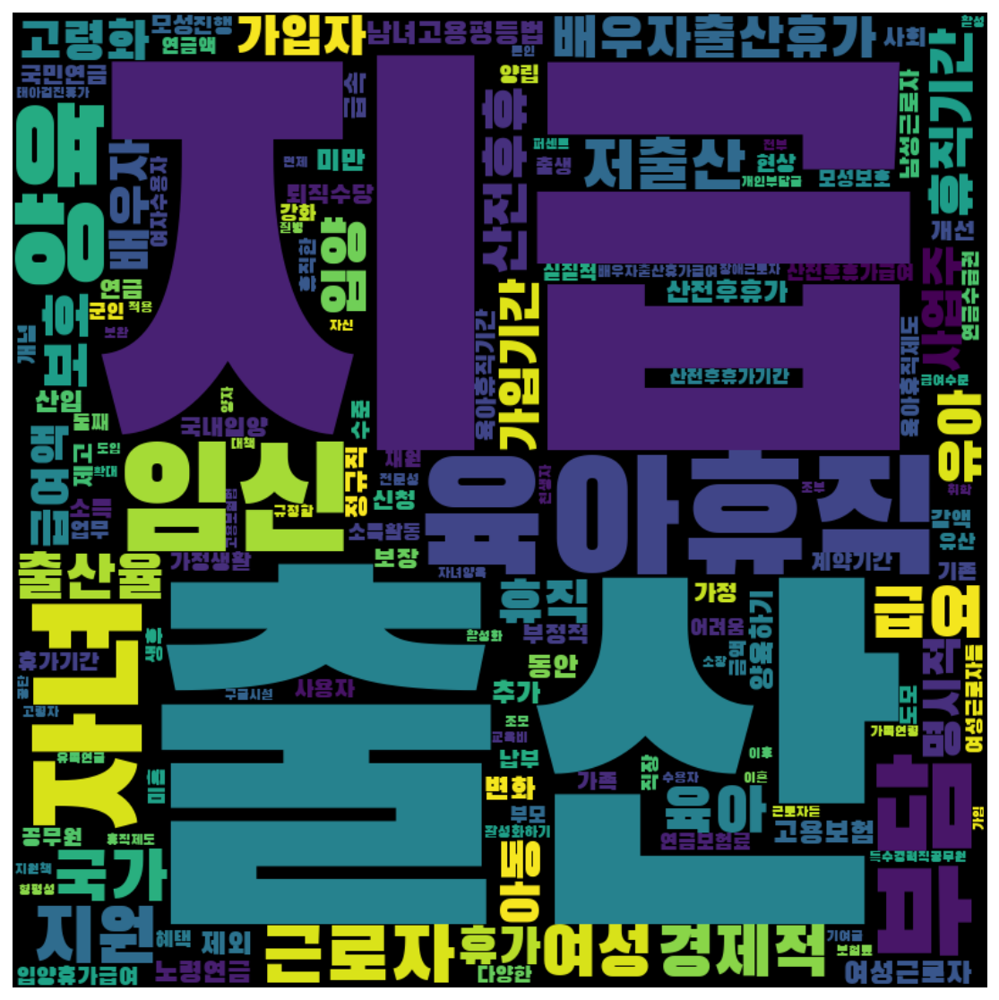

In [130]:
frewords_vis(progressive_g5_tokens)
wordcloud_vis(progressive_g5_tokens)

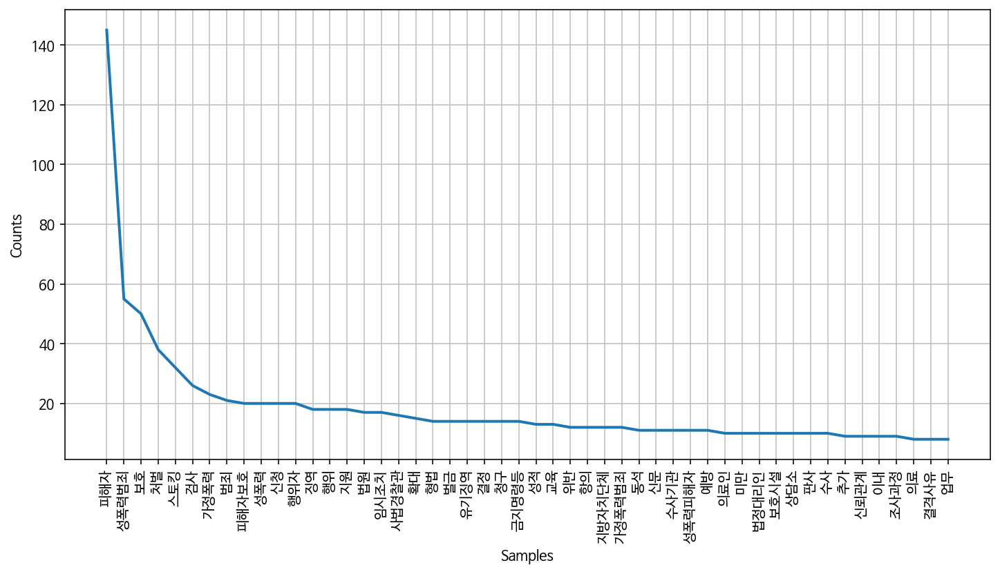

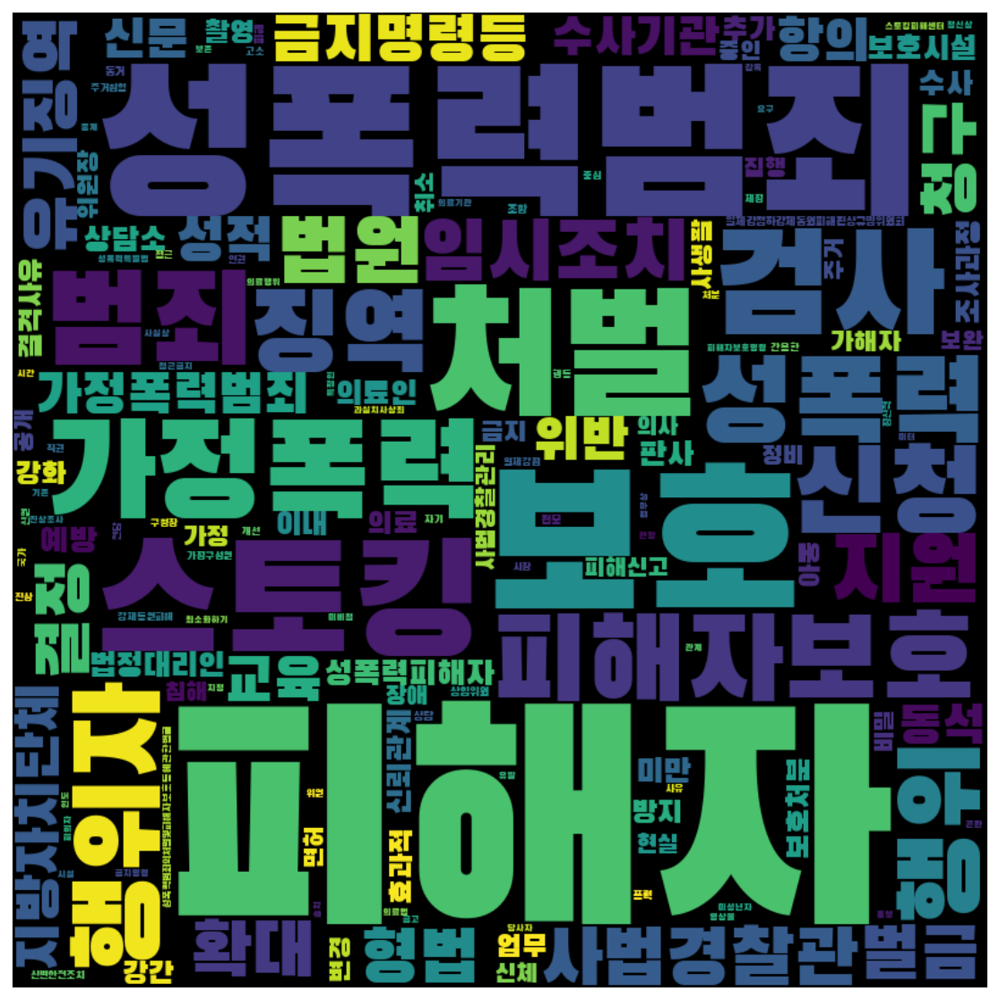

In [131]:
frewords_vis(progressive_g6_tokens)
wordcloud_vis(progressive_g6_tokens)

#### 보수

In [132]:
# K means 수행 
word_vectors_con = conservative['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con)
conservative['category'] = idx

<ipython-input-132-413f37cc3da8>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  conservative['category'] = idx


In [133]:
conservative['category'].value_counts()

0    52
2    32
1    31
3    27
5    24
4    17
Name: category, dtype: int64

In [134]:
conservative_g1 = conservative[conservative['category'] == 0]
conservative_g2 = conservative[conservative['category'] == 1]
conservative_g3 = conservative[conservative['category'] == 2]
conservative_g4 = conservative[conservative['category'] == 3]
conservative_g5 = conservative[conservative['category'] == 4]
conservative_g6 = conservative[conservative['category'] == 5]

In [135]:
conservative_g1_tokens = total_tokens(conservative_g1['tokens'])
conservative_g2_tokens = total_tokens(conservative_g2['tokens'])
conservative_g3_tokens = total_tokens(conservative_g3['tokens'])
conservative_g4_tokens = total_tokens(conservative_g4['tokens'])
conservative_g5_tokens = total_tokens(conservative_g5['tokens'])
conservative_g6_tokens = total_tokens(conservative_g6['tokens'])

In [143]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','미만',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
conservative_g1_tokens = [each_word for each_word in conservative_g1_tokens if each_word not in stopwords]
conservative_g2_tokens = [each_word for each_word in conservative_g2_tokens if each_word not in stopwords]
conservative_g3_tokens = [each_word for each_word in conservative_g3_tokens if each_word not in stopwords]
conservative_g4_tokens = [each_word for each_word in conservative_g4_tokens if each_word not in stopwords]
conservative_g5_tokens = [each_word for each_word in conservative_g5_tokens if each_word not in stopwords]
conservative_g6_tokens = [each_word for each_word in conservative_g6_tokens if each_word not in stopwords]

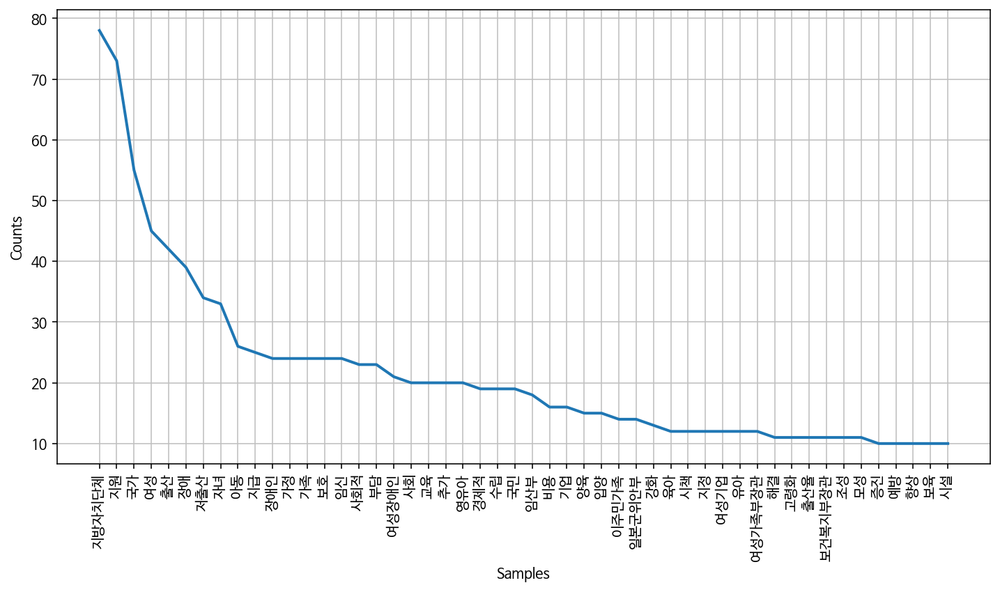

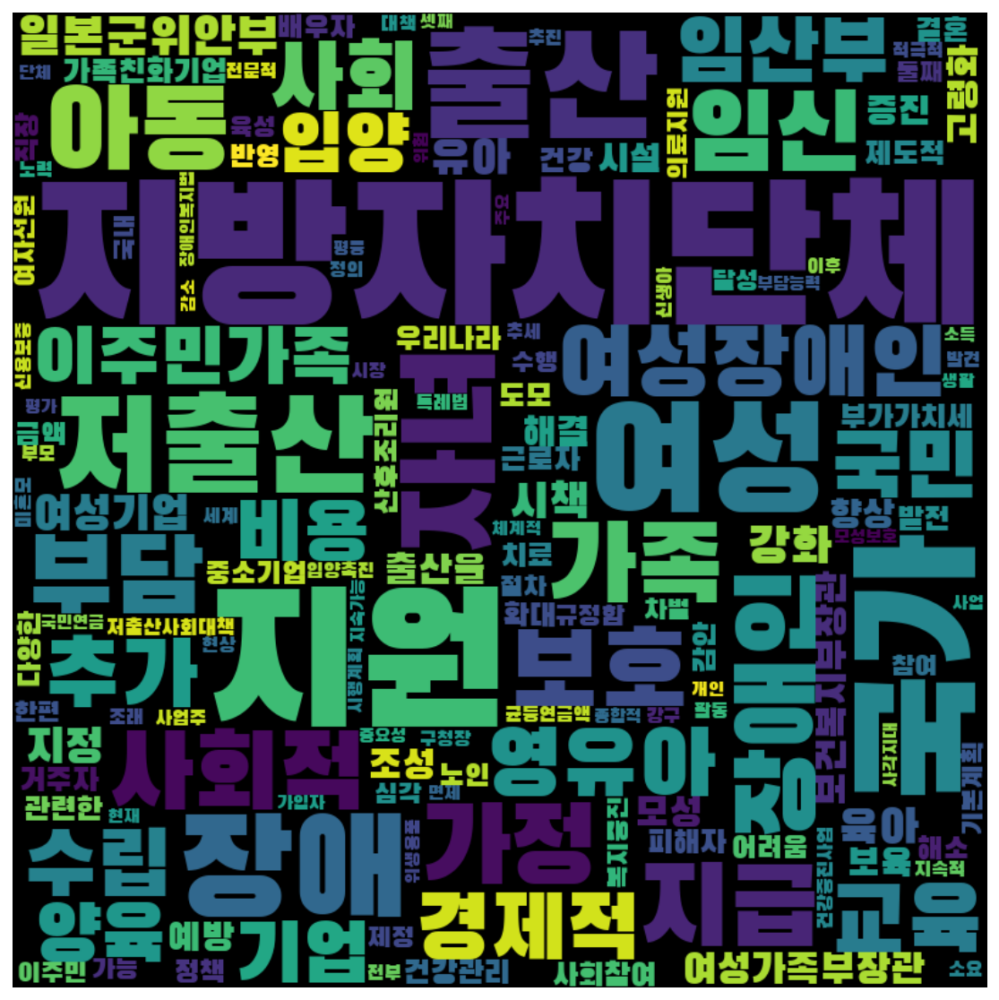

In [144]:
frewords_vis(conservative_g1_tokens)
wordcloud_vis(conservative_g1_tokens)

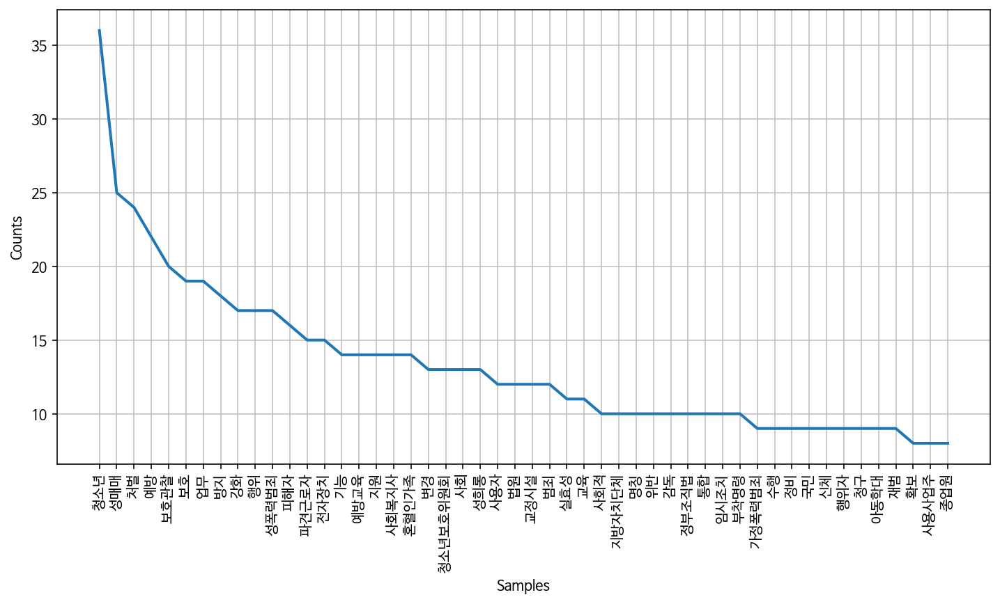

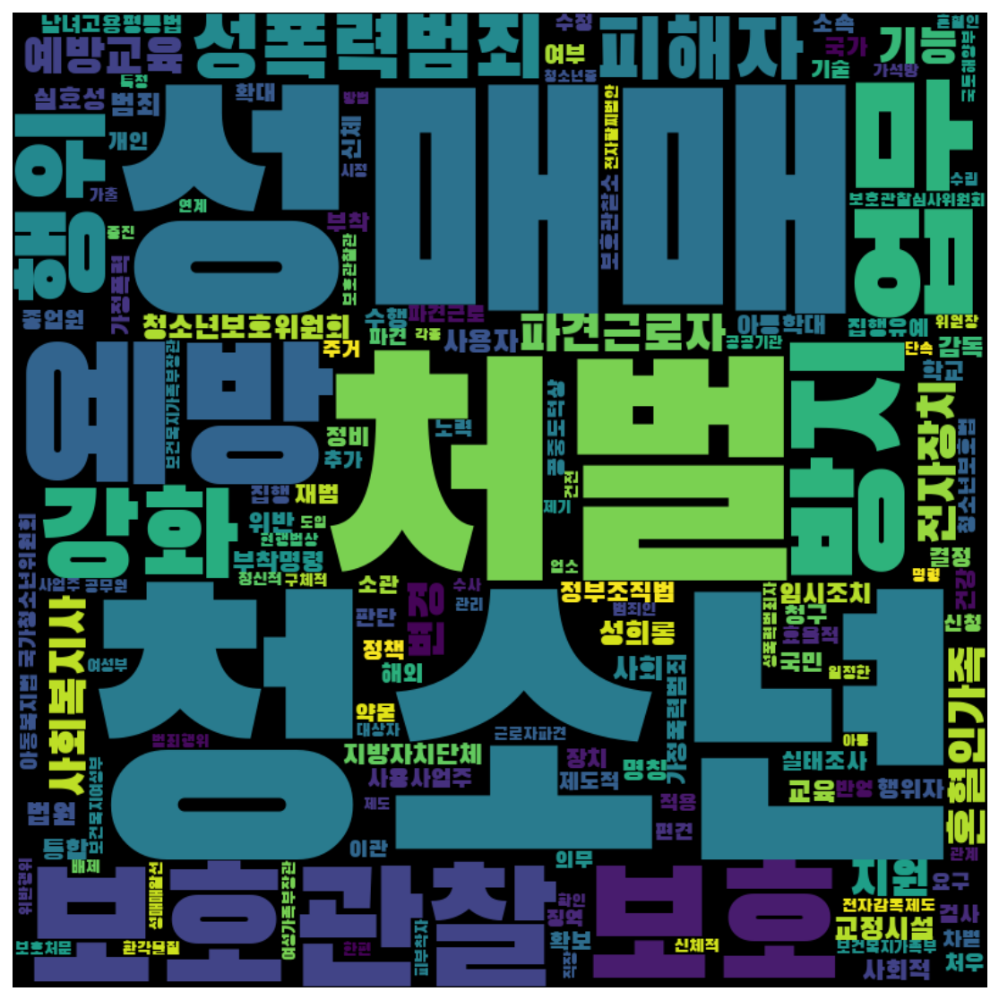

In [145]:
frewords_vis(conservative_g2_tokens)
wordcloud_vis(conservative_g2_tokens)

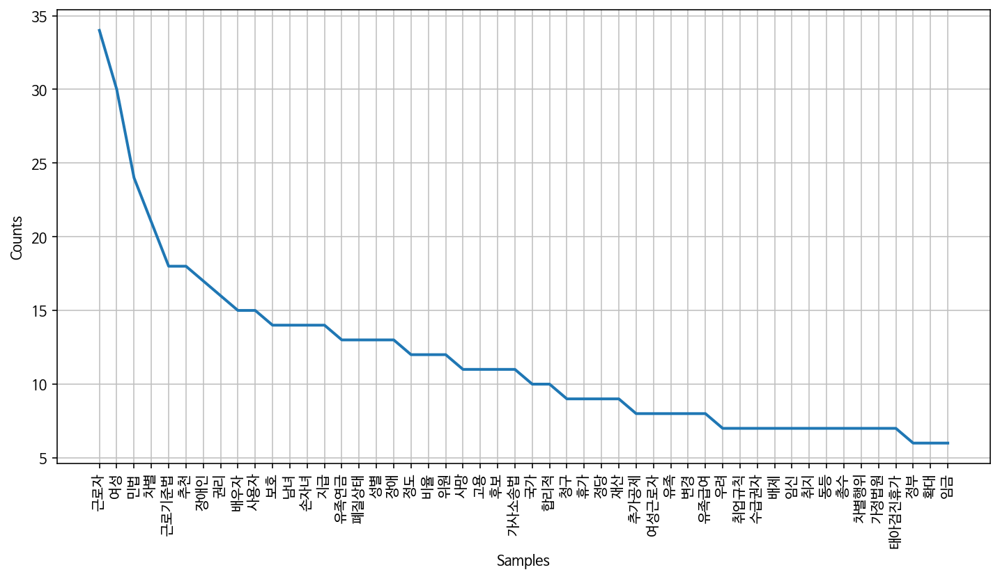

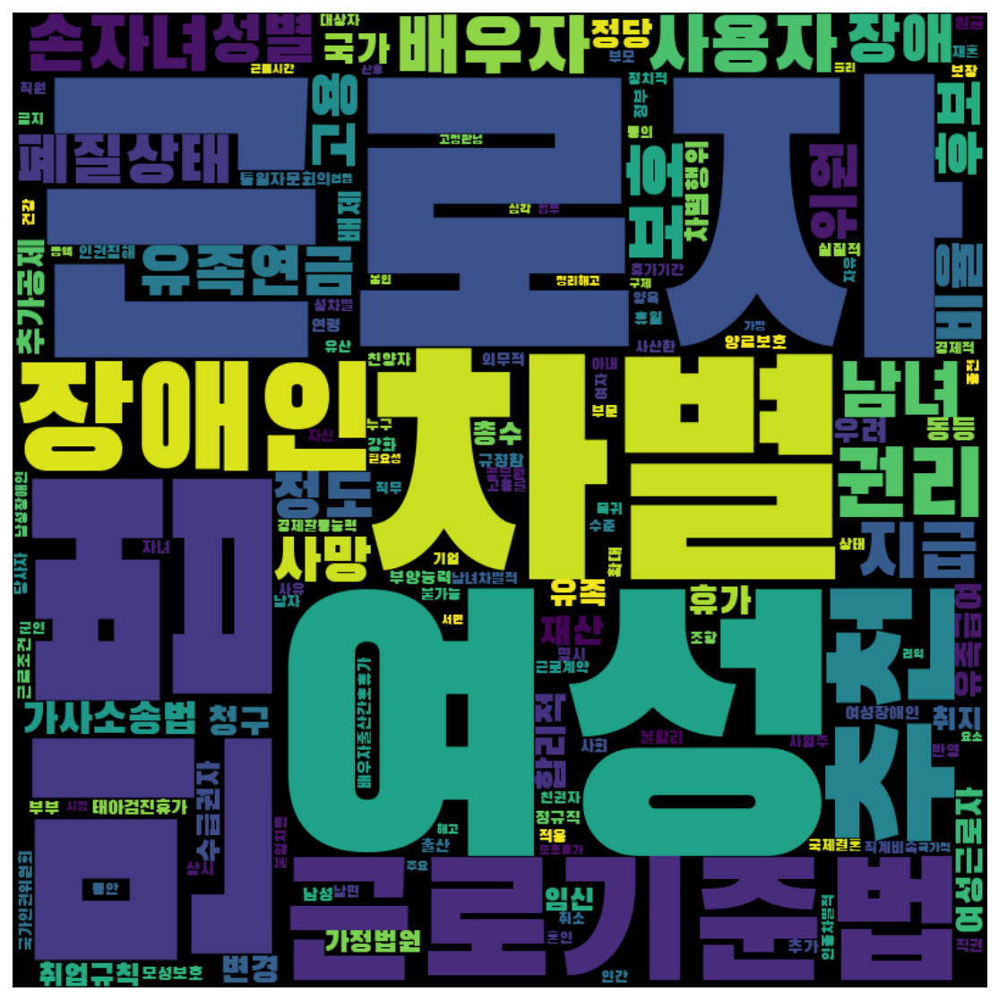

In [146]:
frewords_vis(conservative_g3_tokens)
wordcloud_vis(conservative_g3_tokens)

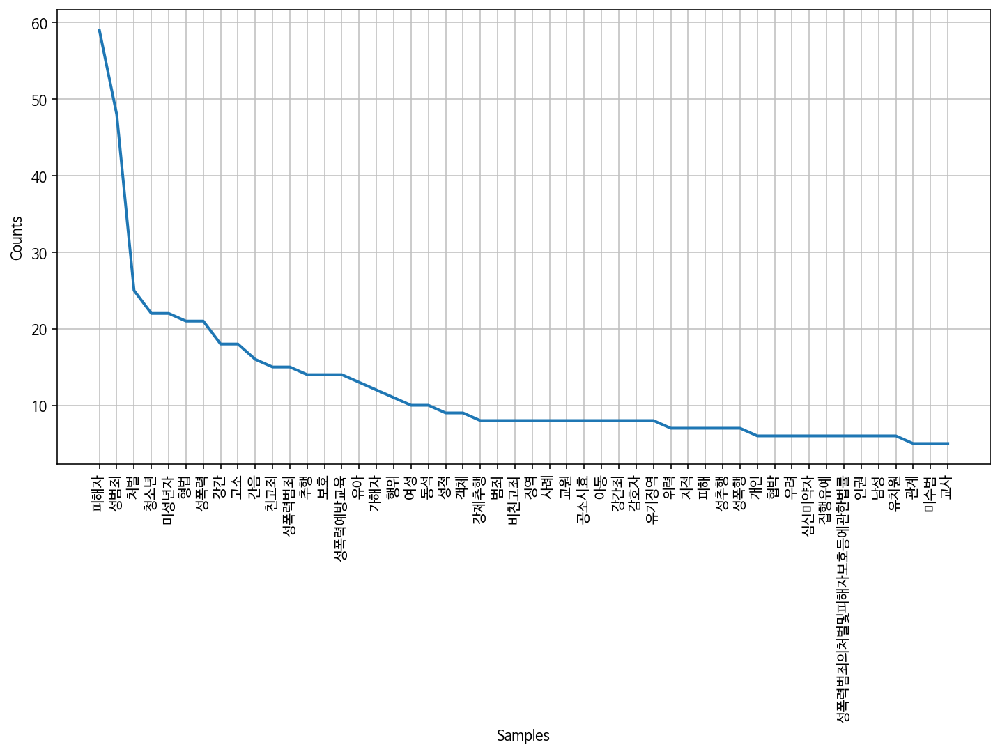

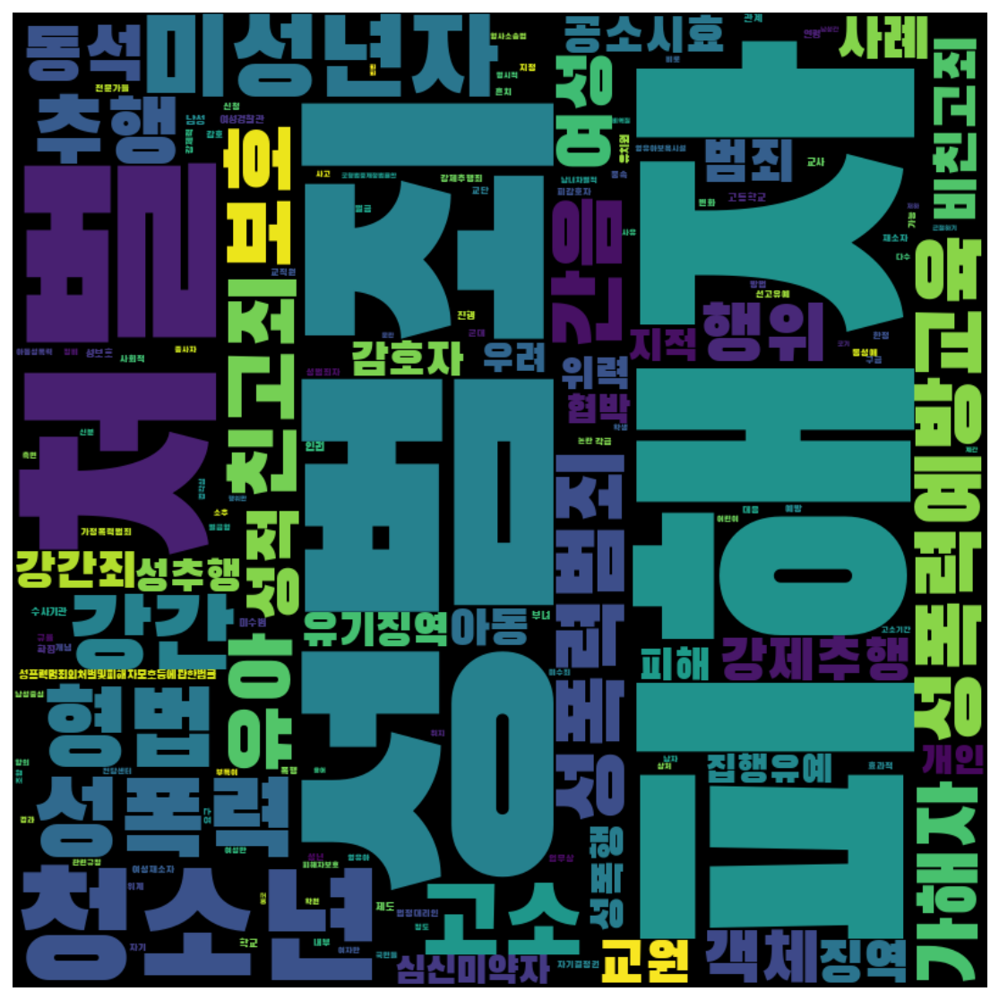

In [147]:
frewords_vis(conservative_g4_tokens)
wordcloud_vis(conservative_g4_tokens)

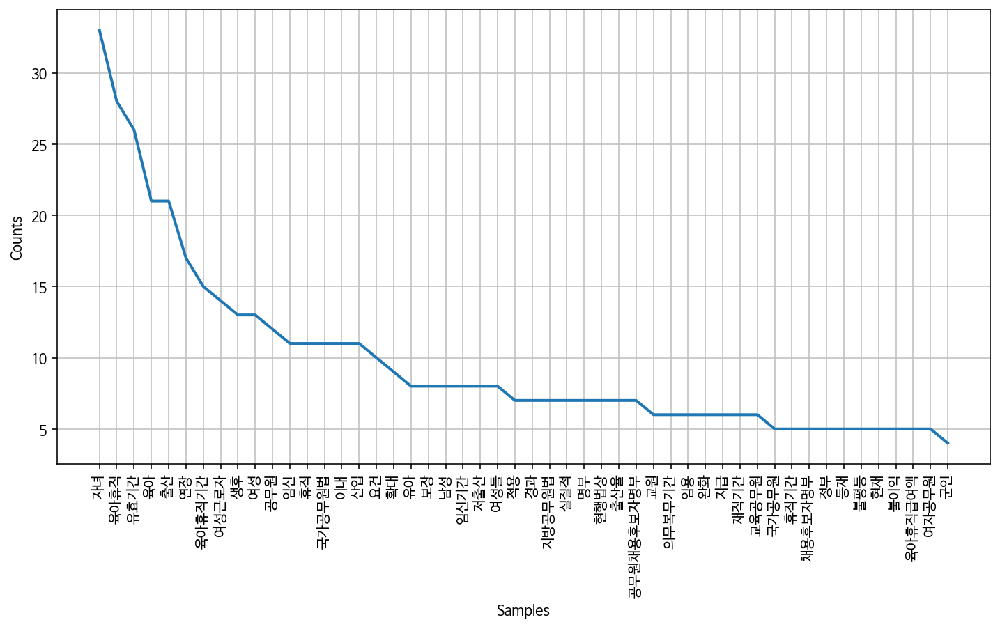

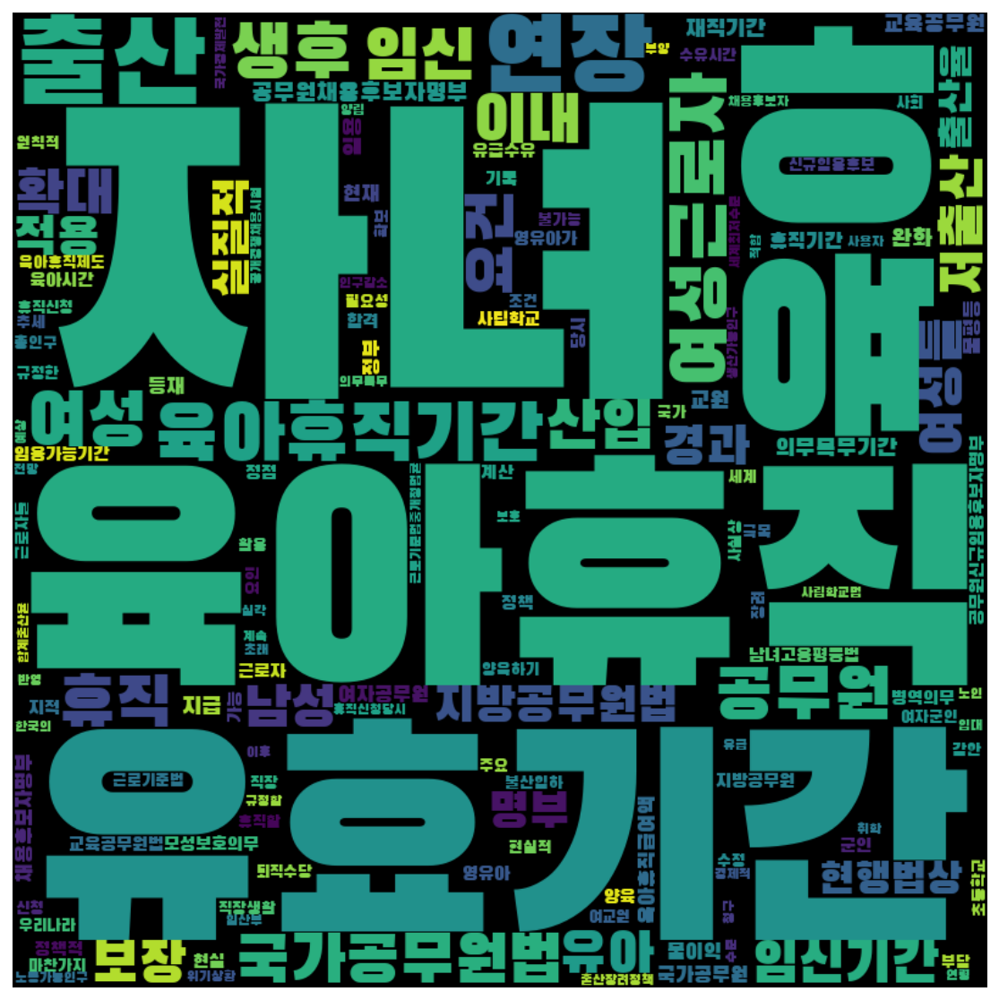

In [148]:
frewords_vis(conservative_g5_tokens)
wordcloud_vis(conservative_g5_tokens)

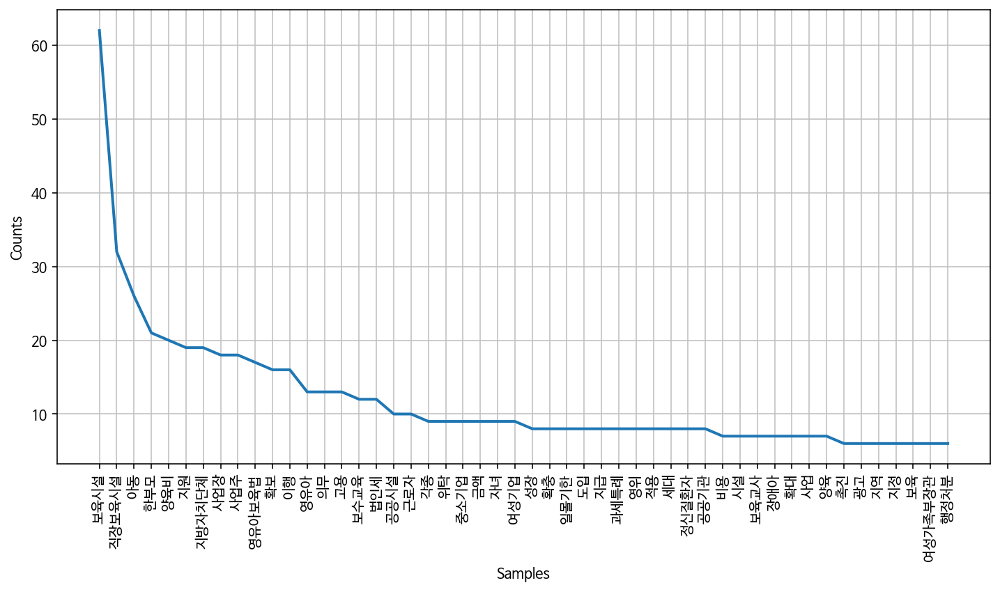

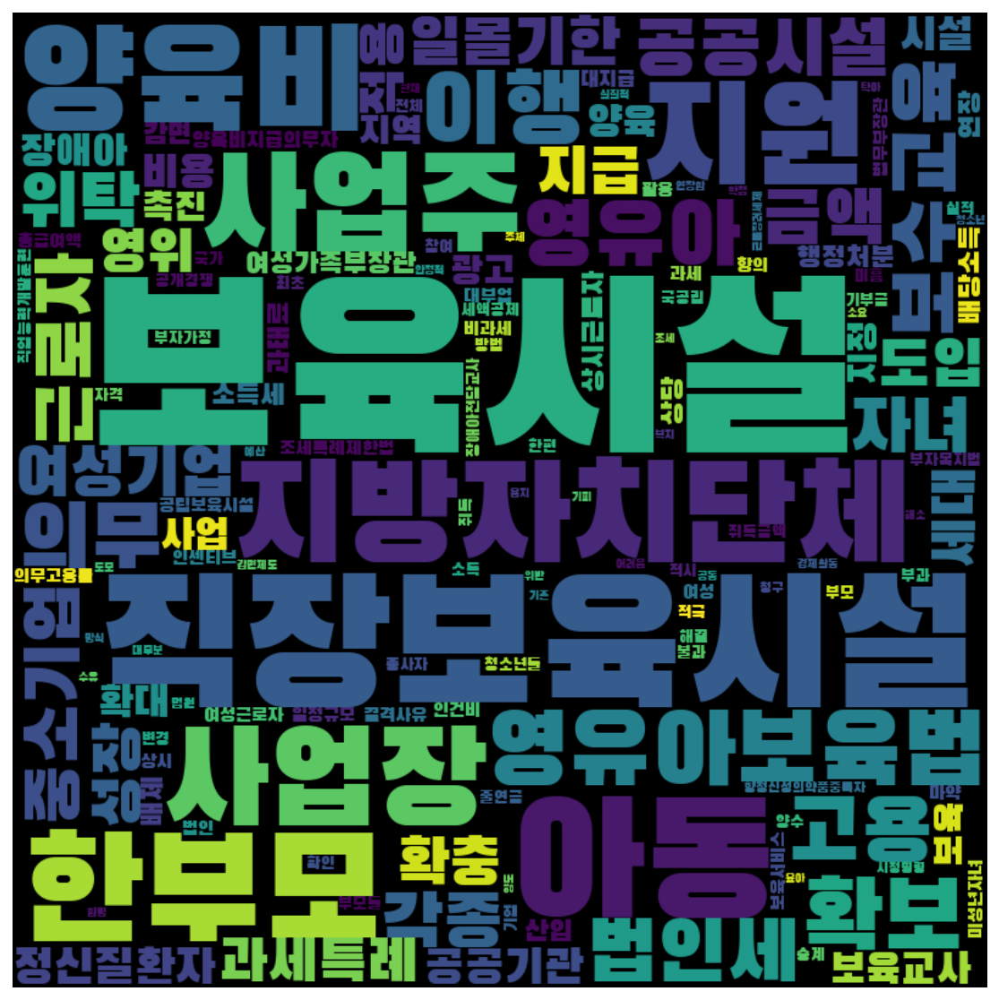

In [149]:
frewords_vis(conservative_g6_tokens)
wordcloud_vis(conservative_g6_tokens)

## 이명박 정권
- 2008.02.25 ~ 2013.02.24

In [151]:
leemyungbak = gender[(gender['제안일자'] > datetime.date(2008,2,25)) & 
                        (gender['제안일자'] < datetime.date(2013,2,24))]
leemyungbak.shape

(1131, 19)

In [152]:
leemyungbak['정당성향'].value_counts()

보수    563
진보    413
Name: 정당성향, dtype: int64

In [153]:
pd.DataFrame(leemyungbak.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  321
     여성  242
진보   남성  244
     여성  169

In [154]:
progressive = leemyungbak[leemyungbak['정당성향'] == '진보']
conservative = leemyungbak[leemyungbak['정당성향'] == '보수']

In [155]:
model_progressive = Word2Vec(progressive['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)
model_conservative = Word2Vec(conservative['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)

2020-10-13 22:02:35,838 : INFO : collecting all words and their counts
2020-10-13 22:02:35,840 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-13 22:02:35,852 : INFO : collected 5917 word types from a corpus of 33162 raw words and 413 sentences
2020-10-13 22:02:35,853 : INFO : Loading a fresh vocabulary
2020-10-13 22:02:35,859 : INFO : effective_min_count=10 retains 718 unique words (12% of original 5917, drops 5199)
2020-10-13 22:02:35,860 : INFO : effective_min_count=10 leaves 20996 word corpus (63% of original 33162, drops 12166)
2020-10-13 22:02:35,864 : INFO : deleting the raw counts dictionary of 5917 items
2020-10-13 22:02:35,866 : INFO : sample=0.001 downsamples 69 most-common words
2020-10-13 22:02:35,867 : INFO : downsampling leaves estimated 17609 word corpus (83.9% of prior 20996)
2020-10-13 22:02:35,872 : INFO : estimated required memory for 718 words and 100 dimensions: 933400 bytes
2020-10-13 22:02:35,873 : INFO : resetting layer weight

2020-10-13 22:02:36,570 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:36,575 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:36,576 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:36,578 : INFO : EPOCH - 15 : training on 33162 raw words (17605 effective words) took 0.0s, 574422 effective words/s
2020-10-13 22:02:36,600 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:36,604 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:36,607 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:36,609 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:36,610 : INFO : EPOCH - 16 : training on 33162 raw words (17574 effective words) took 0.0s, 843548 effective words/s
2020-10-13 22:02:36,625 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:02:37,069 : INFO : EPOCH - 31 : training on 33162 raw words (17611 effective words) took 0.0s, 864072 effective words/s
2020-10-13 22:02:37,086 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:37,090 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:37,092 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:37,093 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:37,094 : INFO : EPOCH - 32 : training on 33162 raw words (17593 effective words) took 0.0s, 992494 effective words/s
2020-10-13 22:02:37,110 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:37,115 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:37,117 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:37,119 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:02:37,644 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:37,648 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:37,652 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:37,654 : INFO : EPOCH - 48 : training on 33162 raw words (17636 effective words) took 0.0s, 643134 effective words/s
2020-10-13 22:02:37,672 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:37,680 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:37,682 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:37,684 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:37,684 : INFO : EPOCH - 49 : training on 33162 raw words (17531 effective words) took 0.0s, 880815 effective words/s
2020-10-13 22:02:37,700 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:02:38,203 : INFO : EPOCH - 64 : training on 33162 raw words (17614 effective words) took 0.0s, 1171700 effective words/s
2020-10-13 22:02:38,217 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:38,222 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:38,224 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:38,226 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:38,227 : INFO : EPOCH - 65 : training on 33162 raw words (17577 effective words) took 0.0s, 940265 effective words/s
2020-10-13 22:02:38,246 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:38,257 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:38,260 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:38,262 : INFO : worker thread finished; awaiting finish of 0 more threads
202

2020-10-13 22:02:38,774 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:38,777 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:38,779 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:38,780 : INFO : EPOCH - 81 : training on 33162 raw words (17591 effective words) took 0.0s, 770687 effective words/s
2020-10-13 22:02:38,795 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:38,799 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:38,802 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:38,804 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:38,805 : INFO : EPOCH - 82 : training on 33162 raw words (17561 effective words) took 0.0s, 870524 effective words/s
2020-10-13 22:02:38,823 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:02:39,273 : INFO : EPOCH - 97 : training on 33162 raw words (17598 effective words) took 0.0s, 943265 effective words/s
2020-10-13 22:02:39,296 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:39,304 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:39,308 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:39,309 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:39,311 : INFO : EPOCH - 98 : training on 33162 raw words (17634 effective words) took 0.0s, 629876 effective words/s
2020-10-13 22:02:39,330 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:39,339 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:39,342 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:39,348 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:02:40,106 : INFO : EPOCH - 11 : training on 44702 raw words (25358 effective words) took 0.0s, 773623 effective words/s
2020-10-13 22:02:40,137 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:40,140 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:40,142 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:40,144 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:40,145 : INFO : EPOCH - 12 : training on 44702 raw words (25369 effective words) took 0.0s, 801414 effective words/s
2020-10-13 22:02:40,175 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:40,176 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:40,180 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:40,182 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:02:40,789 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:40,793 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:40,802 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:40,803 : INFO : EPOCH - 28 : training on 44702 raw words (25475 effective words) took 0.0s, 596918 effective words/s
2020-10-13 22:02:40,830 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:40,838 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:40,840 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:40,842 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:40,844 : INFO : EPOCH - 29 : training on 44702 raw words (25457 effective words) took 0.0s, 773883 effective words/s
2020-10-13 22:02:40,882 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:02:41,502 : INFO : EPOCH - 44 : training on 44702 raw words (25446 effective words) took 0.0s, 609816 effective words/s
2020-10-13 22:02:41,531 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:41,532 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:41,535 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:41,536 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:41,537 : INFO : EPOCH - 45 : training on 44702 raw words (25449 effective words) took 0.0s, 835226 effective words/s
2020-10-13 22:02:41,559 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:41,570 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:41,573 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:41,574 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:02:42,123 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:42,125 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:42,127 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:42,128 : INFO : EPOCH - 61 : training on 44702 raw words (25403 effective words) took 0.0s, 810153 effective words/s
2020-10-13 22:02:42,148 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:42,158 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:42,159 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:42,161 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:42,162 : INFO : EPOCH - 62 : training on 44702 raw words (25333 effective words) took 0.0s, 933681 effective words/s
2020-10-13 22:02:42,189 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:02:42,778 : INFO : EPOCH - 77 : training on 44702 raw words (25415 effective words) took 0.0s, 670168 effective words/s
2020-10-13 22:02:42,806 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:42,818 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:42,820 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:42,822 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:42,824 : INFO : EPOCH - 78 : training on 44702 raw words (25388 effective words) took 0.0s, 641886 effective words/s
2020-10-13 22:02:42,845 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:42,857 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:42,858 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:42,860 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:02:43,454 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:43,455 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:43,458 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:43,460 : INFO : EPOCH - 94 : training on 44702 raw words (25366 effective words) took 0.0s, 667004 effective words/s
2020-10-13 22:02:43,490 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:02:43,499 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:02:43,501 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:02:43,505 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:02:43,507 : INFO : EPOCH - 95 : training on 44702 raw words (25382 effective words) took 0.0s, 684763 effective words/s
2020-10-13 22:02:43,542 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

In [156]:
print(model_progressive.wv.most_similar('여성'))
print(model_conservative.wv.most_similar('여성'))

2020-10-13 22:02:43,709 : INFO : precomputing L2-norms of word weight vectors
2020-10-13 22:02:43,712 : INFO : precomputing L2-norms of word weight vectors


[('우리나라', 0.48665446043014526), ('대부분', 0.4762759208679199), ('선진국', 0.4759904146194458), ('경제활동', 0.47027677297592163), ('세계', 0.4504871964454651), ('육아', 0.41945353150367737), ('적극적', 0.4162195920944214), ('과제', 0.4154497981071472), ('미달', 0.4131714105606079), ('반면', 0.4114464223384857)]
[('임신', 0.4792892336845398), ('남성', 0.4498429596424103), ('출산', 0.41978251934051514), ('산후', 0.4171726107597351), ('유산', 0.4113999903202057), ('통계', 0.40783917903900146), ('산모', 0.40449345111846924), ('보호휴가', 0.4009014368057251), ('현상', 0.4006587862968445), ('임산부', 0.39632099866867065)]


In [157]:
progressive['문장벡터'] = progressive['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_progressive))
conservative['문장벡터'] = conservative['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_conservative))

<ipython-input-157-7f57b9f27847>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  progressive['문장벡터'] = progressive['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_progressive))
<ipython-input-157-7f57b9f27847>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  conservative['문장벡터'] = conservative['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_conservative))


#### 진보

In [159]:
# K means 수행 
word_vectors_pro = progressive['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro)
progressive['category'] = idx

<ipython-input-159-b83bfee9be13>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  progressive['category'] = idx


In [160]:
progressive['category'].value_counts()

0    92
5    83
1    77
3    71
2    63
4    27
Name: category, dtype: int64

In [161]:
progressive_g1 = progressive[progressive['category'] == 0]
progressive_g2 = progressive[progressive['category'] == 1]
progressive_g3 = progressive[progressive['category'] == 2]
progressive_g4 = progressive[progressive['category'] == 3]
progressive_g5 = progressive[progressive['category'] == 4]
progressive_g6 = progressive[progressive['category'] == 5]

In [162]:
progressive_g1_tokens = total_tokens(progressive_g1['tokens'])
progressive_g2_tokens = total_tokens(progressive_g2['tokens'])
progressive_g3_tokens = total_tokens(progressive_g3['tokens'])
progressive_g4_tokens = total_tokens(progressive_g4['tokens'])
progressive_g5_tokens = total_tokens(progressive_g5['tokens'])
progressive_g6_tokens = total_tokens(progressive_g6['tokens'])

In [163]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
progressive_g1_tokens = [each_word for each_word in progressive_g1_tokens if each_word not in stopwords]
progressive_g2_tokens = [each_word for each_word in progressive_g2_tokens if each_word not in stopwords]
progressive_g3_tokens = [each_word for each_word in progressive_g3_tokens if each_word not in stopwords]
progressive_g4_tokens = [each_word for each_word in progressive_g4_tokens if each_word not in stopwords]
progressive_g5_tokens = [each_word for each_word in progressive_g5_tokens if each_word not in stopwords]
progressive_g6_tokens = [each_word for each_word in progressive_g6_tokens if each_word not in stopwords]

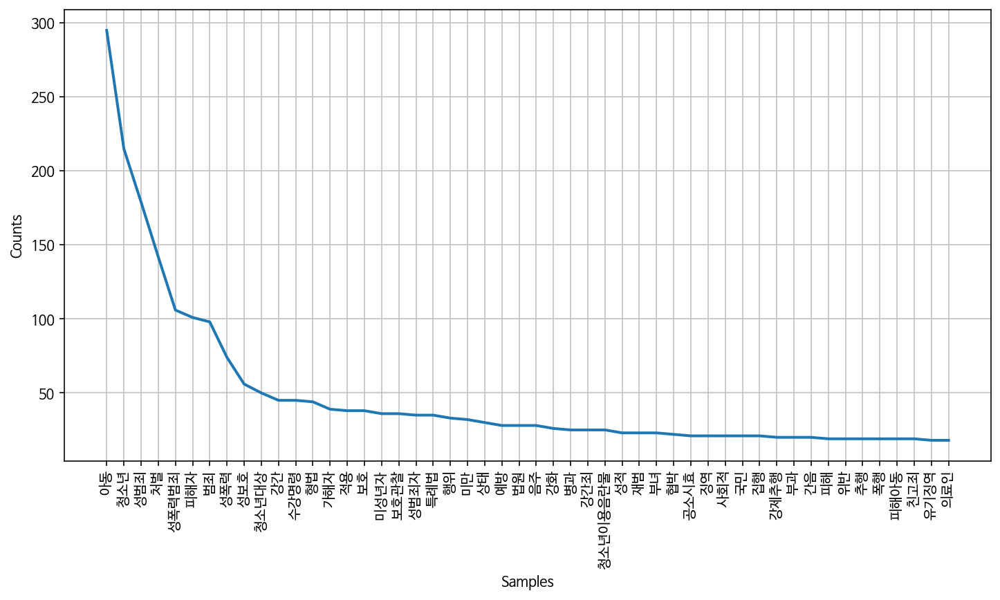

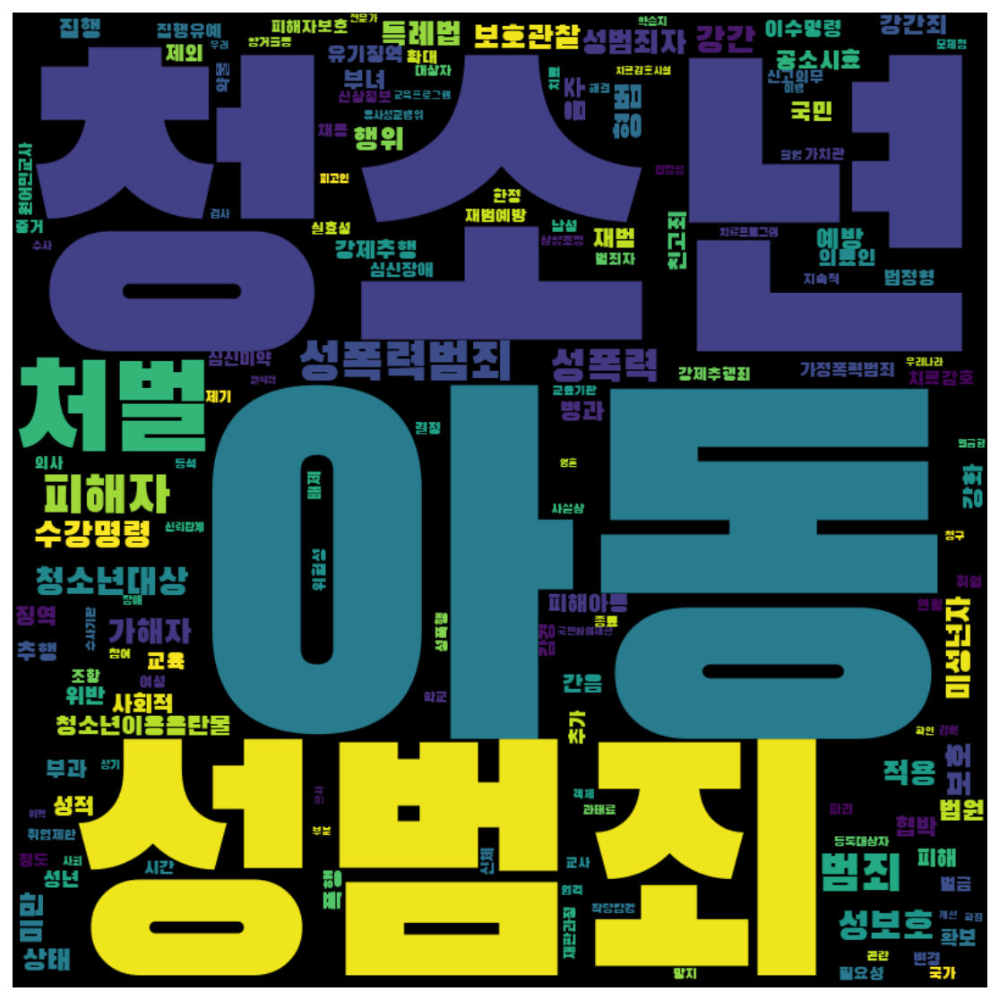

In [164]:
frewords_vis(progressive_g1_tokens)
wordcloud_vis(progressive_g1_tokens)

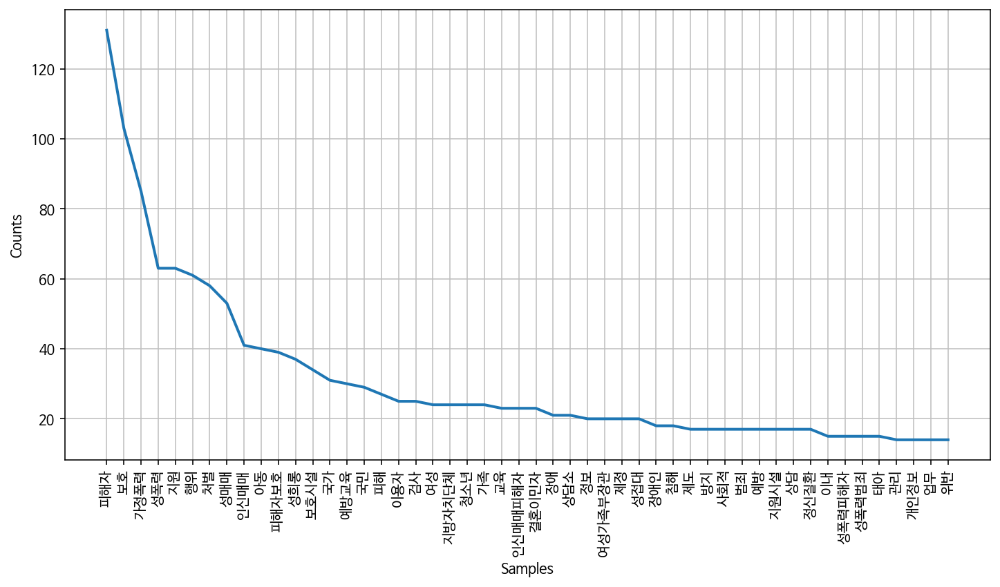

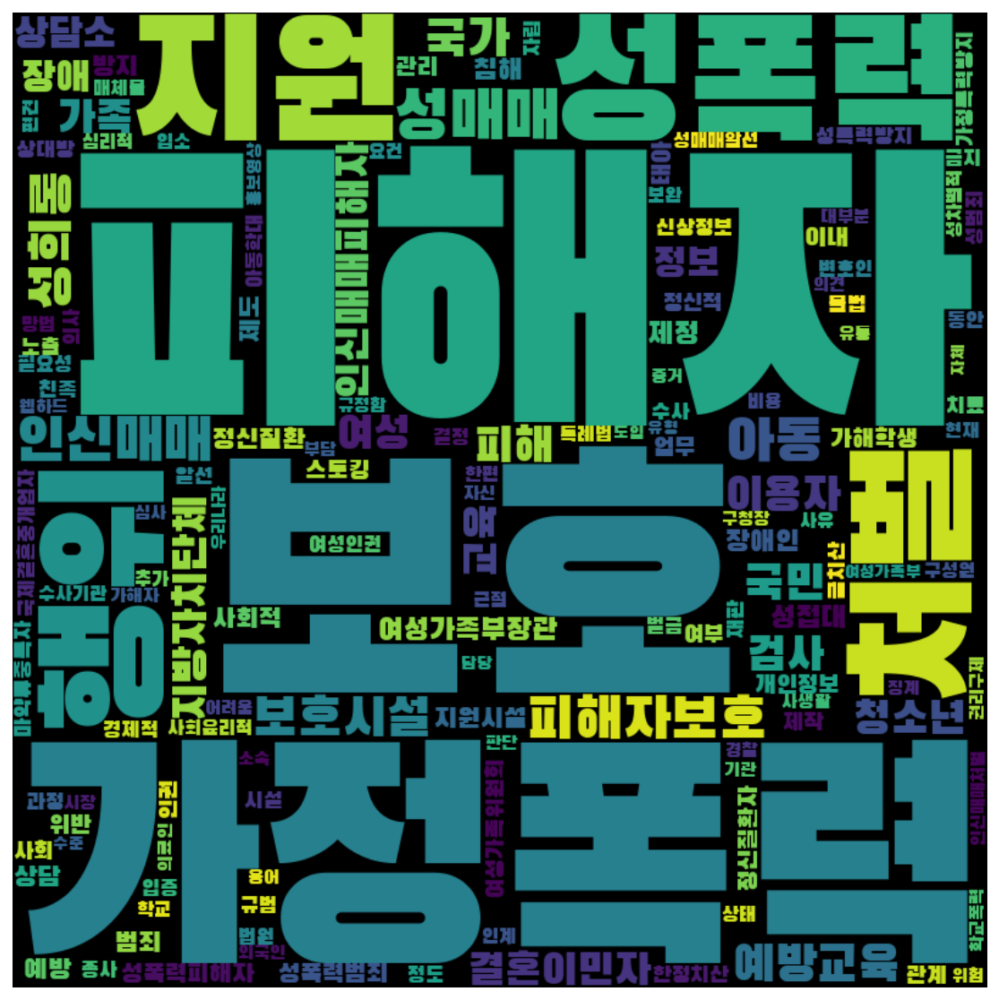

In [165]:
frewords_vis(progressive_g2_tokens)
wordcloud_vis(progressive_g2_tokens)

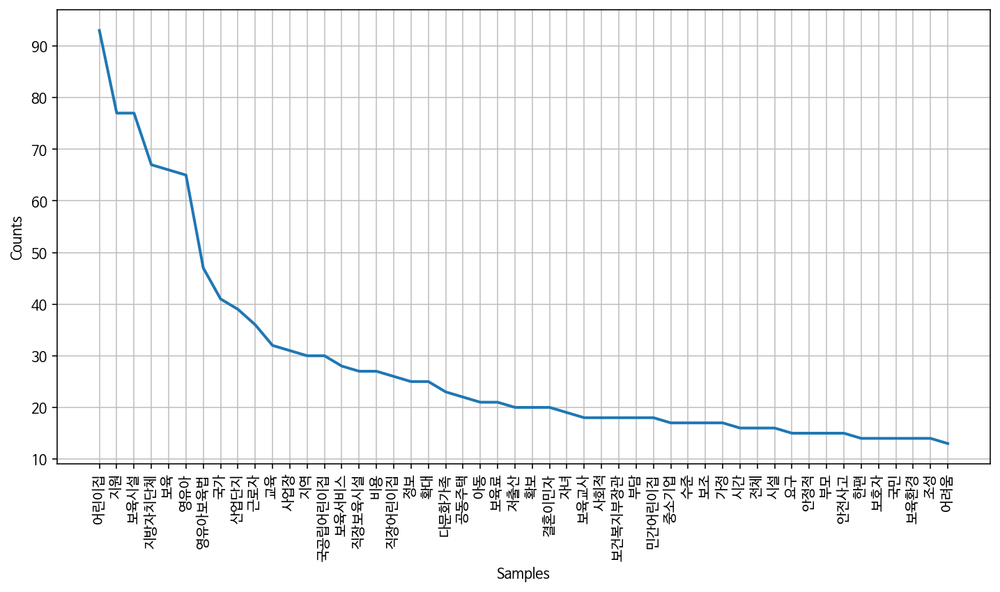

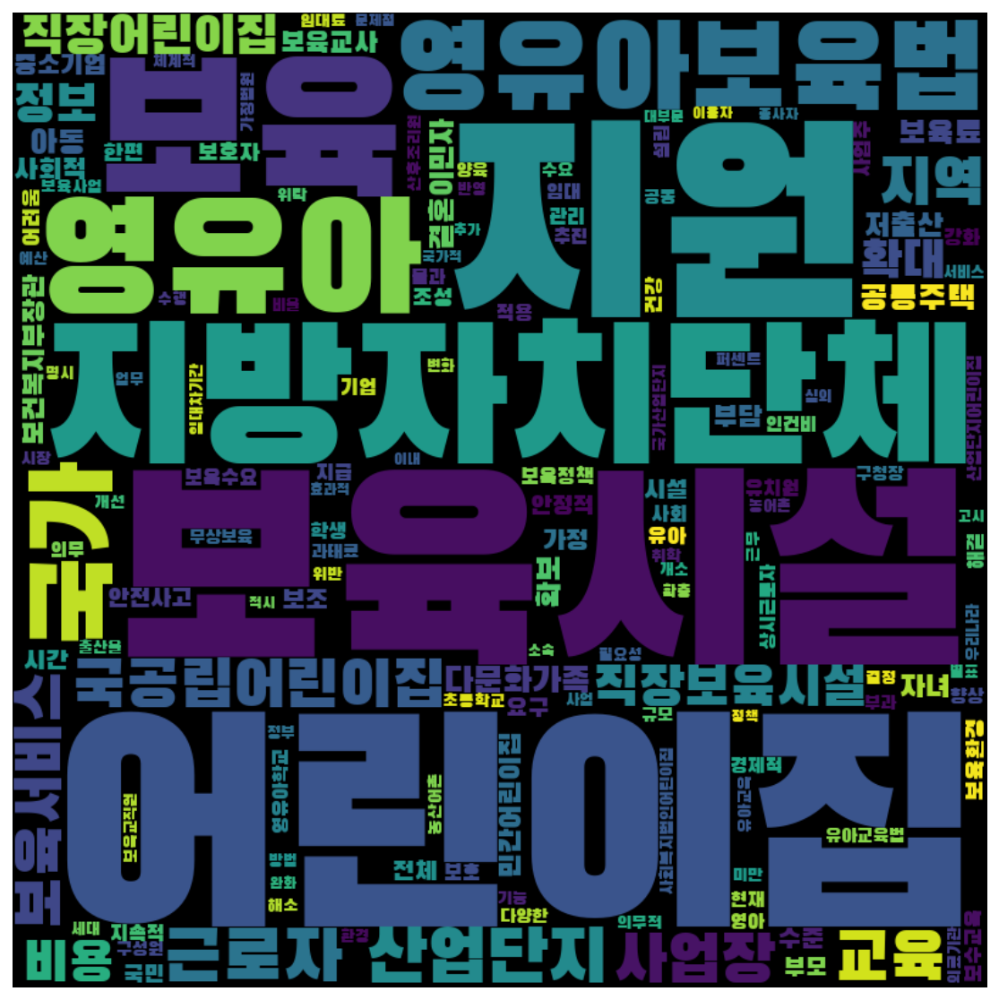

In [166]:
frewords_vis(progressive_g3_tokens)
wordcloud_vis(progressive_g3_tokens)

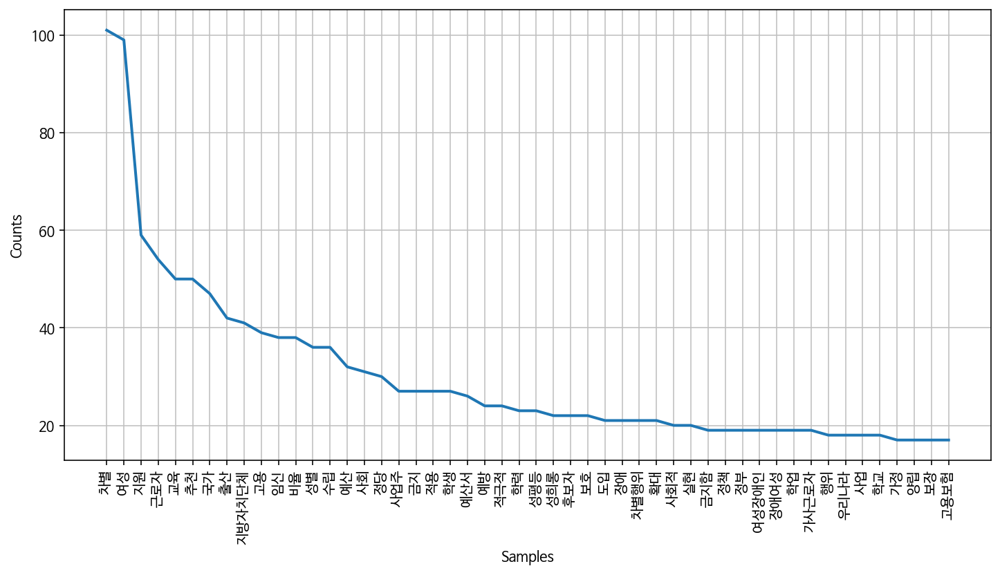

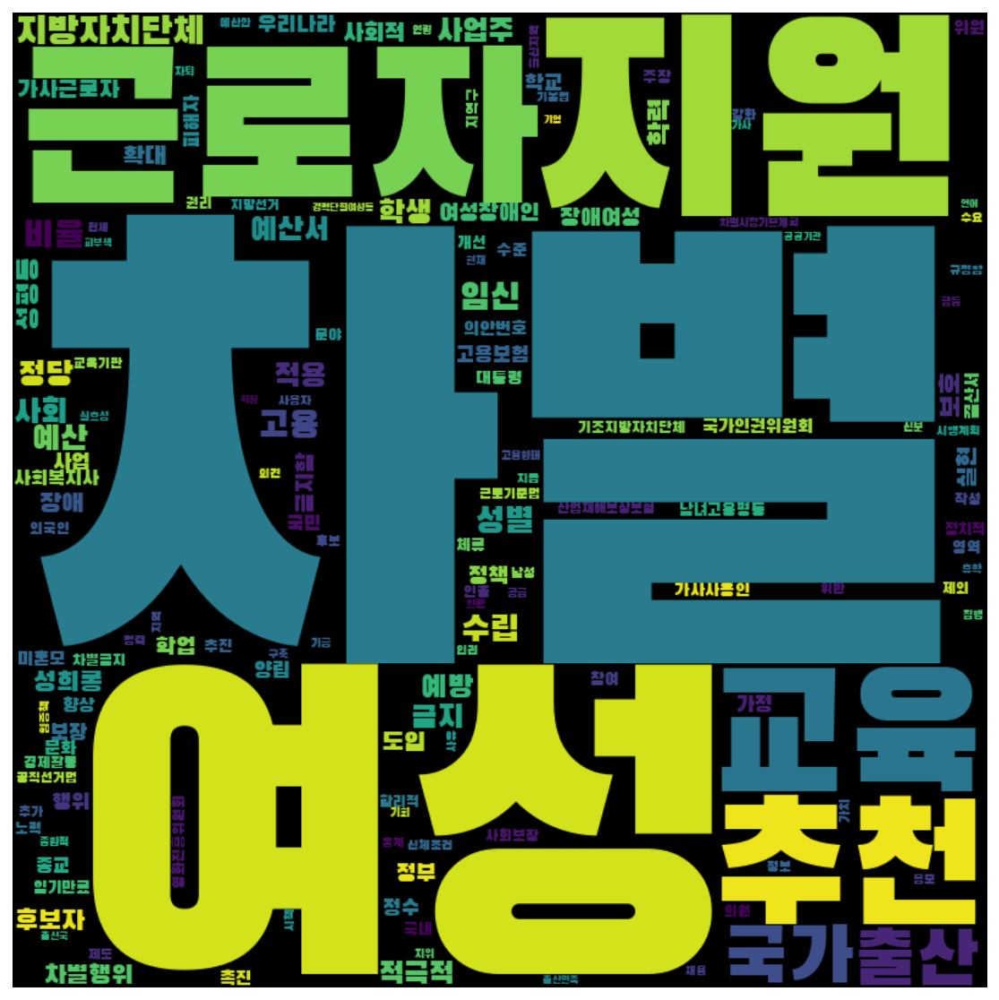

In [167]:
frewords_vis(progressive_g4_tokens)
wordcloud_vis(progressive_g4_tokens)

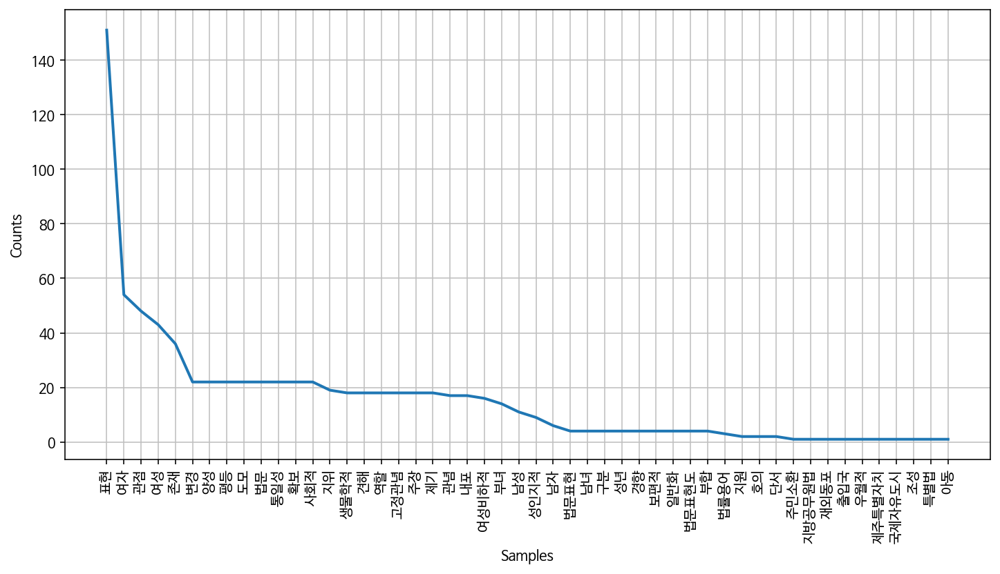

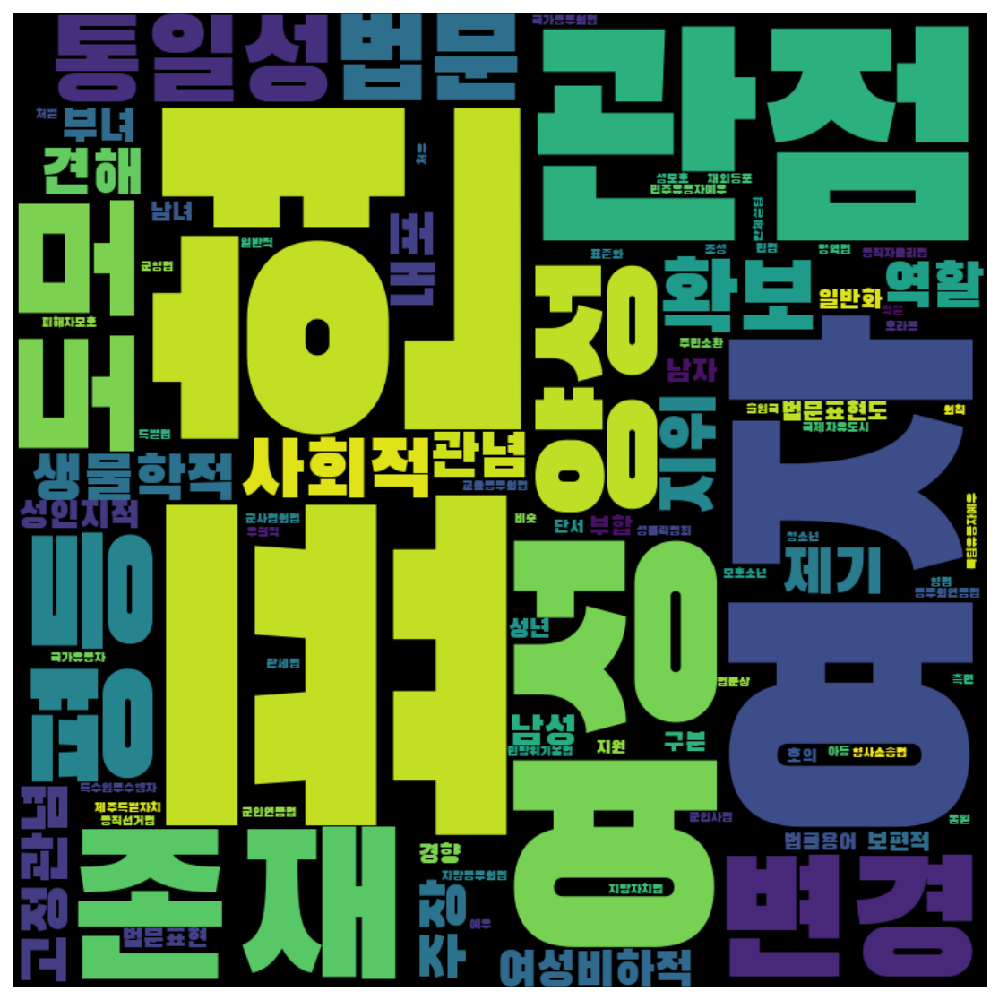

In [168]:
frewords_vis(progressive_g5_tokens)
wordcloud_vis(progressive_g5_tokens)

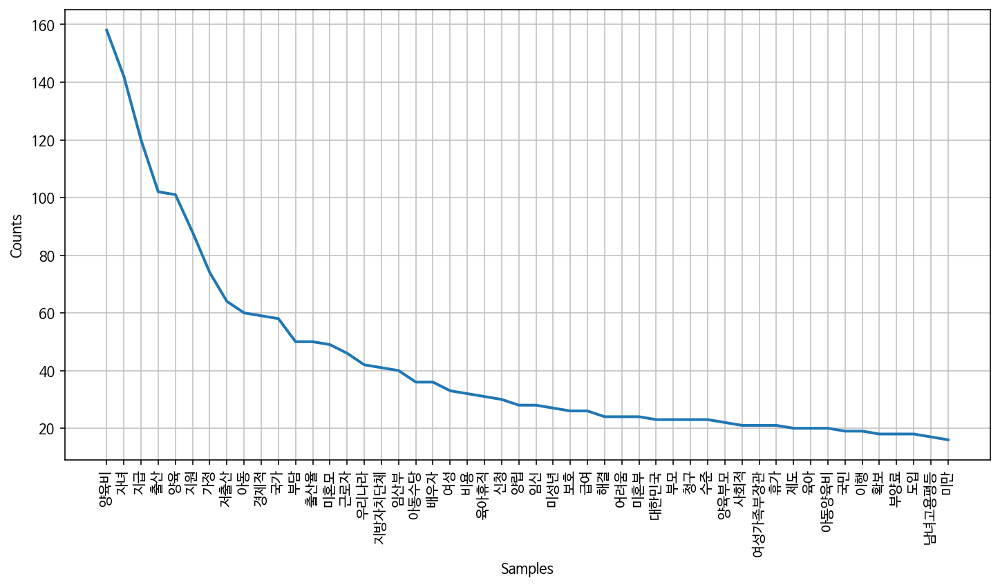

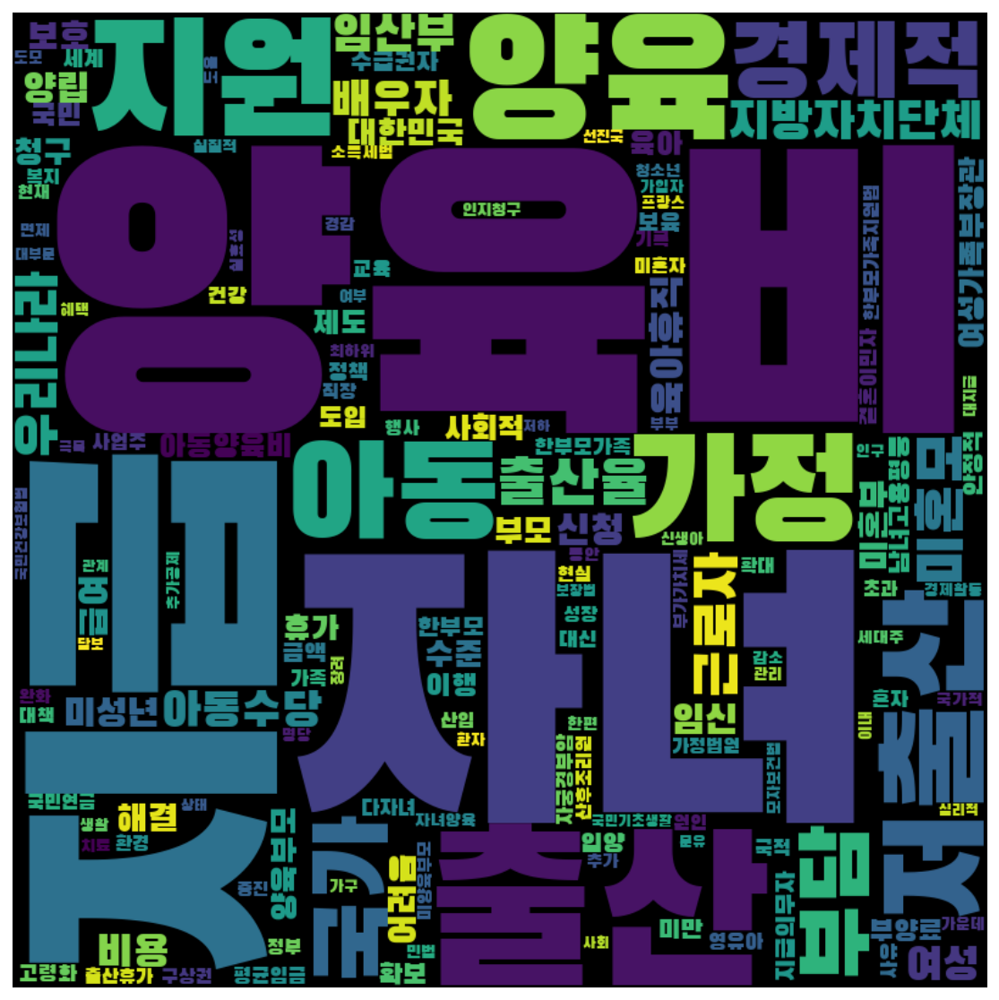

In [169]:
frewords_vis(progressive_g6_tokens)
wordcloud_vis(progressive_g6_tokens)

#### 보수

In [170]:
# K means 수행 
word_vectors_con = conservative['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con)
conservative['category'] = idx

<ipython-input-170-413f37cc3da8>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  conservative['category'] = idx


In [171]:
conservative['category'].value_counts()

0    130
3    121
1     95
4     80
2     74
5     63
Name: category, dtype: int64

In [172]:
conservative_g1 = conservative[conservative['category'] == 0]
conservative_g2 = conservative[conservative['category'] == 1]
conservative_g3 = conservative[conservative['category'] == 2]
conservative_g4 = conservative[conservative['category'] == 3]
conservative_g5 = conservative[conservative['category'] == 4]
conservative_g6 = conservative[conservative['category'] == 5]

In [173]:
conservative_g1_tokens = total_tokens(conservative_g1['tokens'])
conservative_g2_tokens = total_tokens(conservative_g2['tokens'])
conservative_g3_tokens = total_tokens(conservative_g3['tokens'])
conservative_g4_tokens = total_tokens(conservative_g4['tokens'])
conservative_g5_tokens = total_tokens(conservative_g5['tokens'])
conservative_g6_tokens = total_tokens(conservative_g6['tokens'])

In [174]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
conservative_g1_tokens = [each_word for each_word in conservative_g1_tokens if each_word not in stopwords]
conservative_g2_tokens = [each_word for each_word in conservative_g2_tokens if each_word not in stopwords]
conservative_g3_tokens = [each_word for each_word in conservative_g3_tokens if each_word not in stopwords]
conservative_g4_tokens = [each_word for each_word in conservative_g4_tokens if each_word not in stopwords]
conservative_g5_tokens = [each_word for each_word in conservative_g5_tokens if each_word not in stopwords]
conservative_g6_tokens = [each_word for each_word in conservative_g6_tokens if each_word not in stopwords]

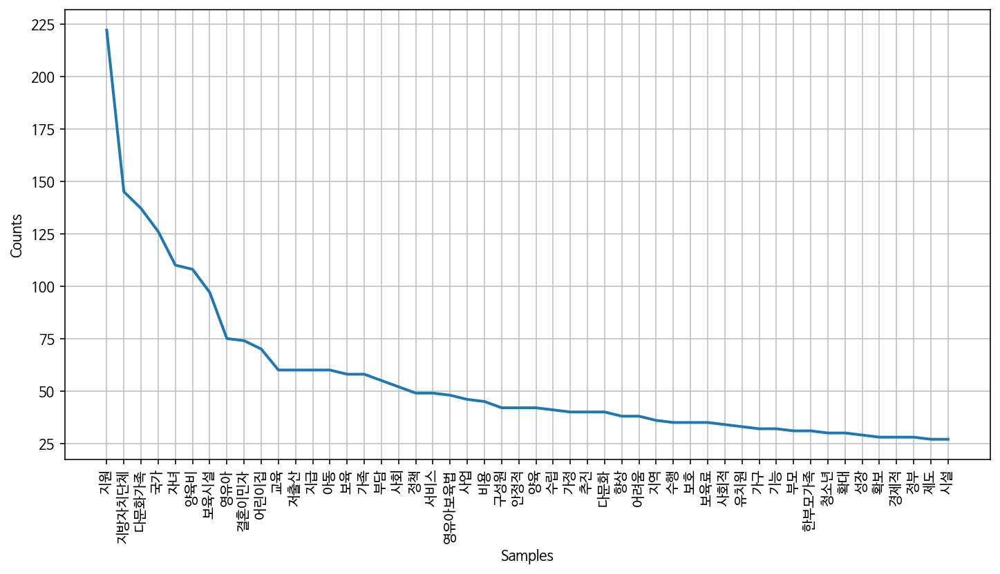

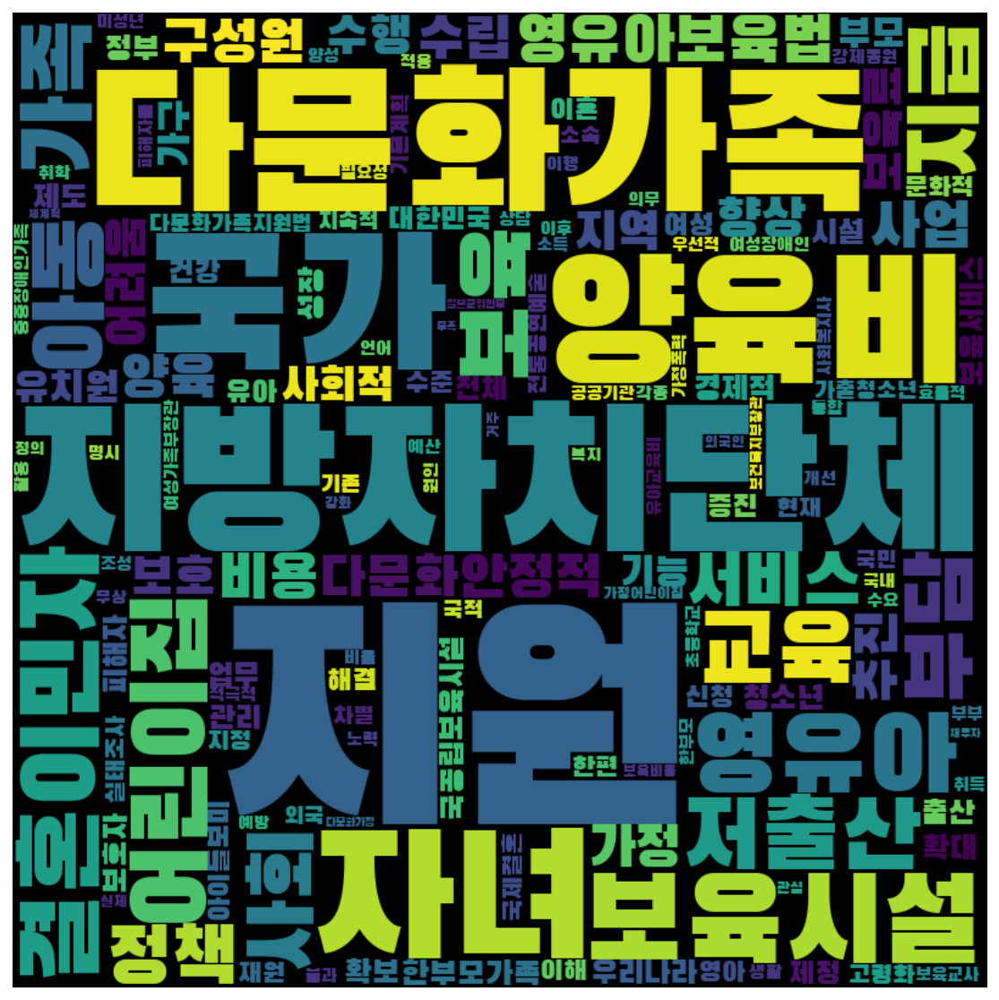

In [175]:
frewords_vis(conservative_g1_tokens)
wordcloud_vis(conservative_g1_tokens)

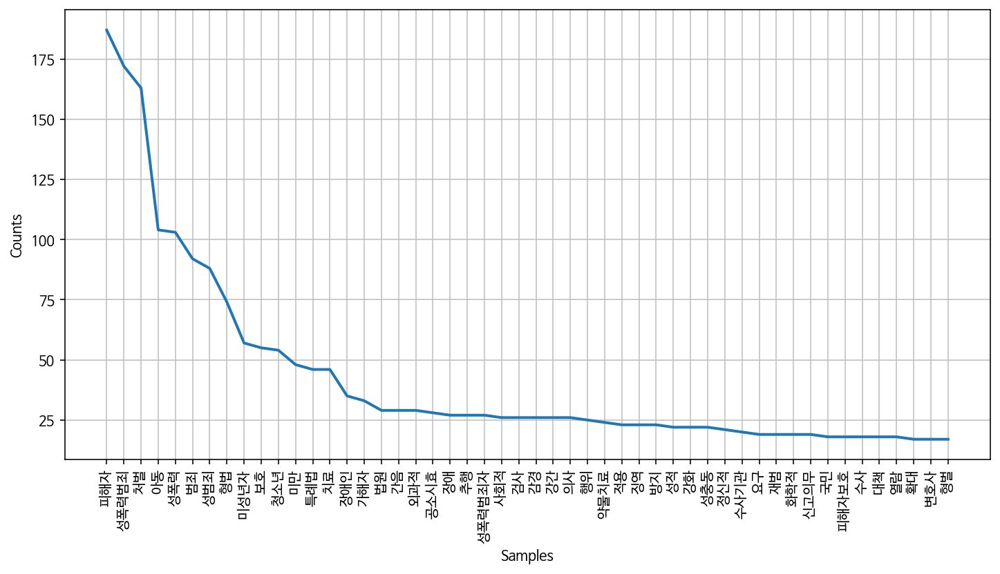

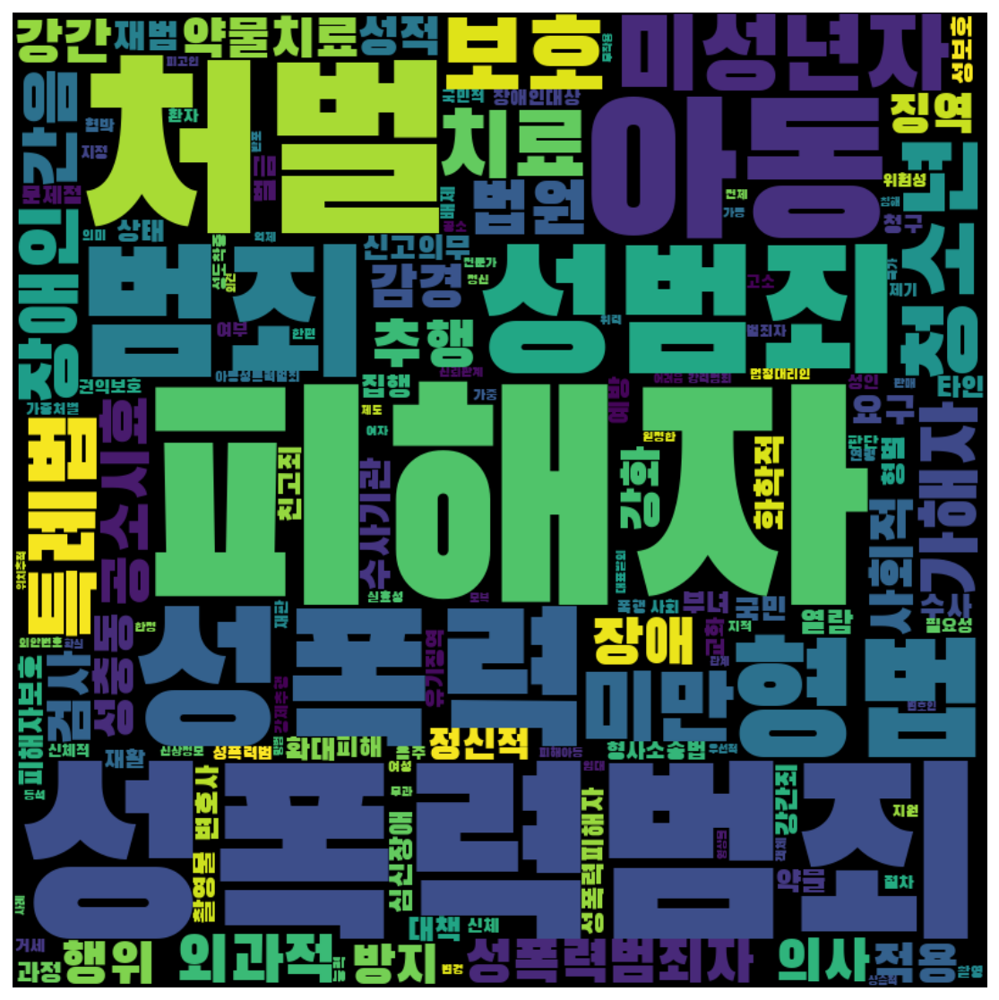

In [176]:
frewords_vis(conservative_g2_tokens)
wordcloud_vis(conservative_g2_tokens)

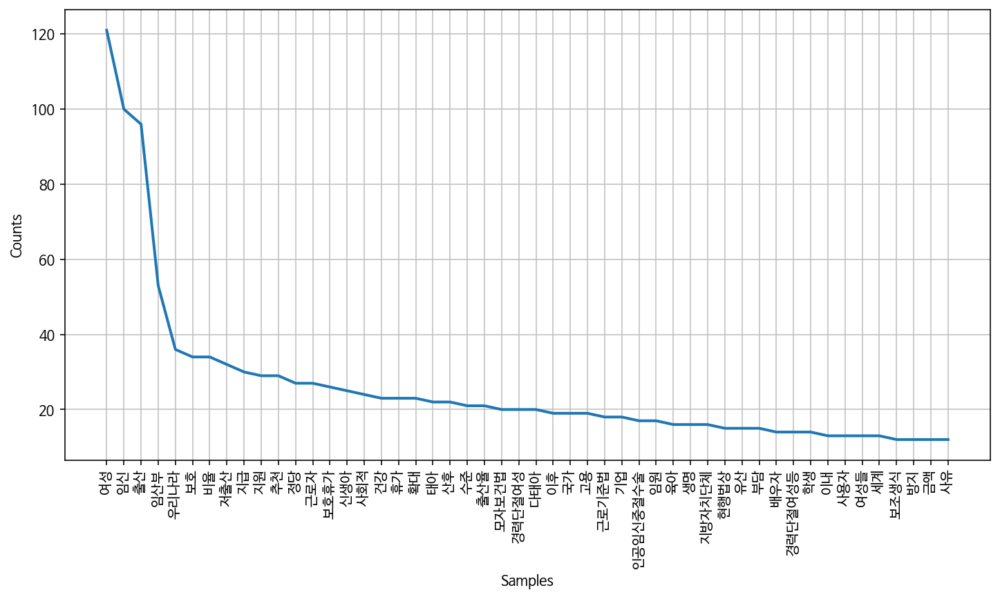

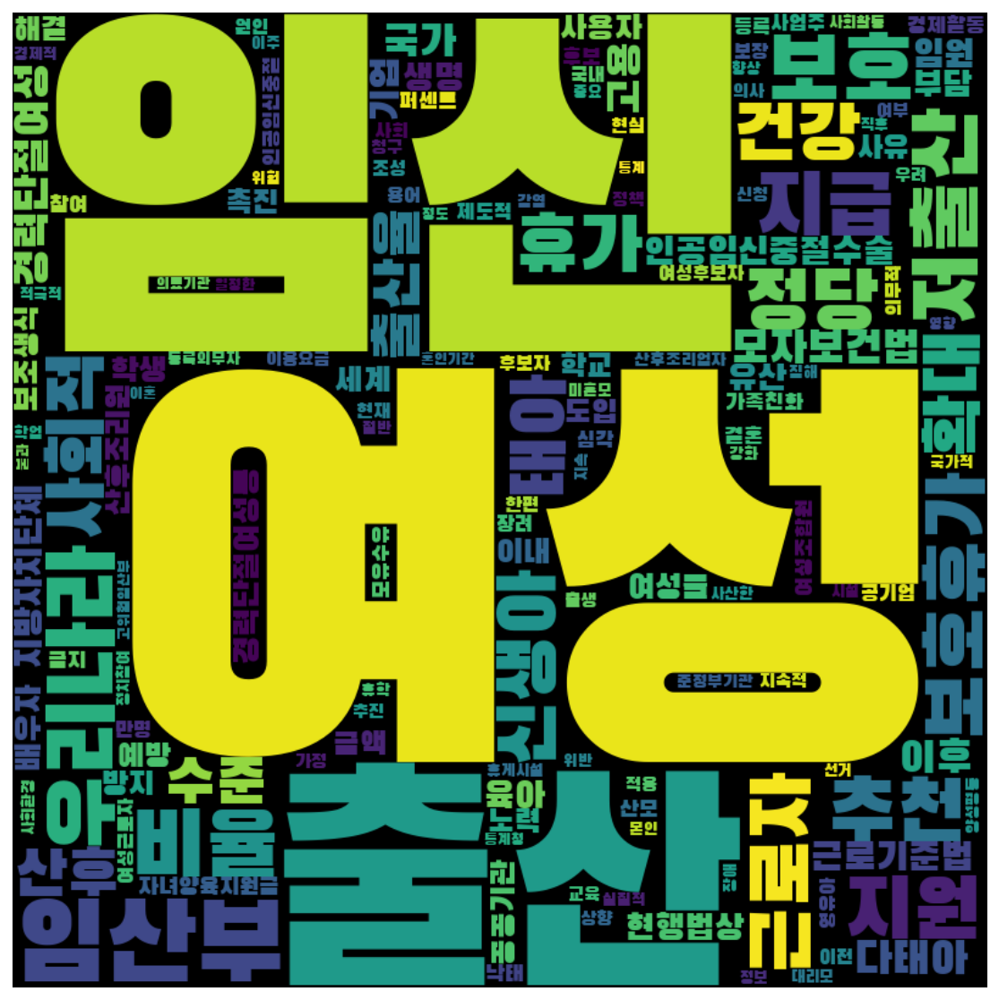

In [177]:
frewords_vis(conservative_g3_tokens)
wordcloud_vis(conservative_g3_tokens)

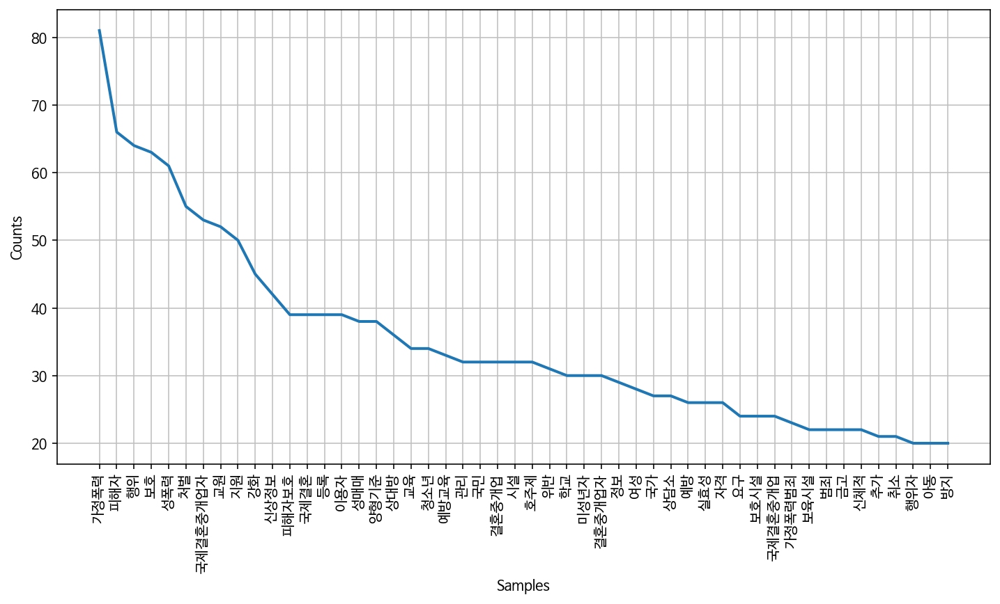

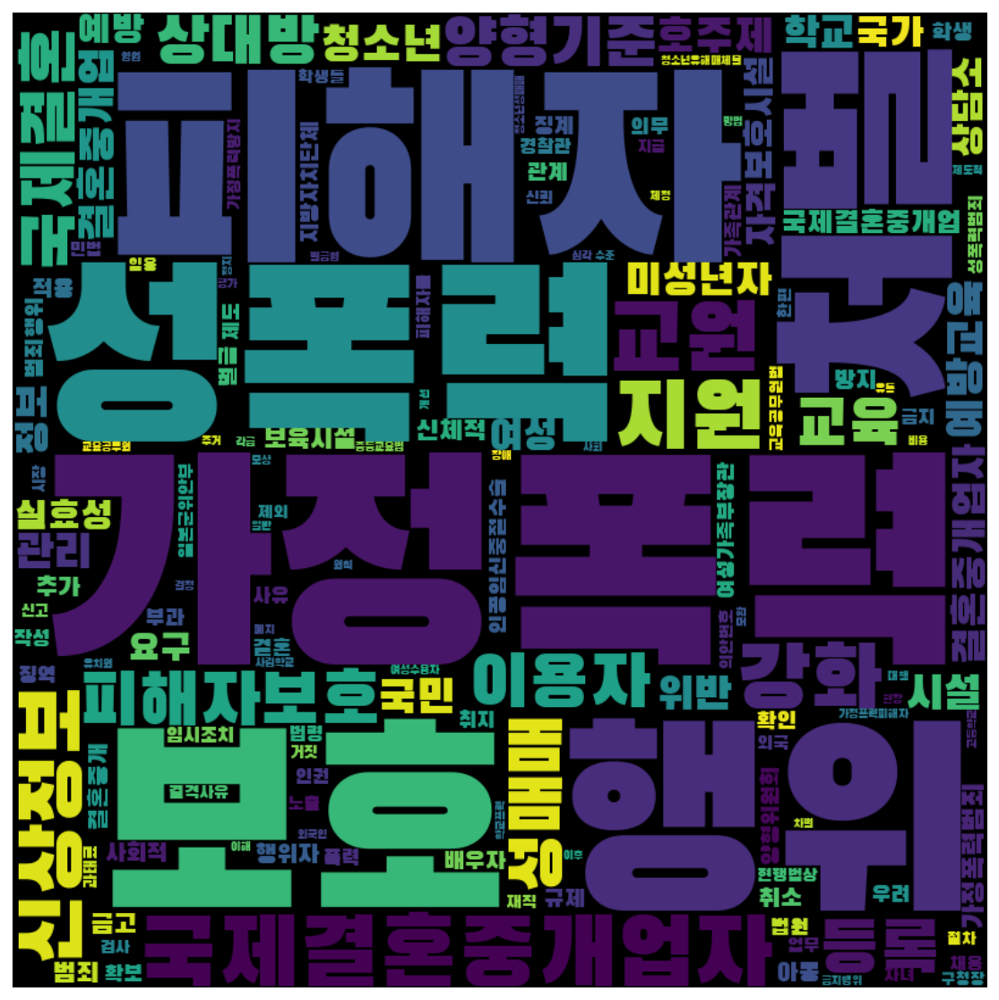

In [178]:
frewords_vis(conservative_g4_tokens)
wordcloud_vis(conservative_g4_tokens)

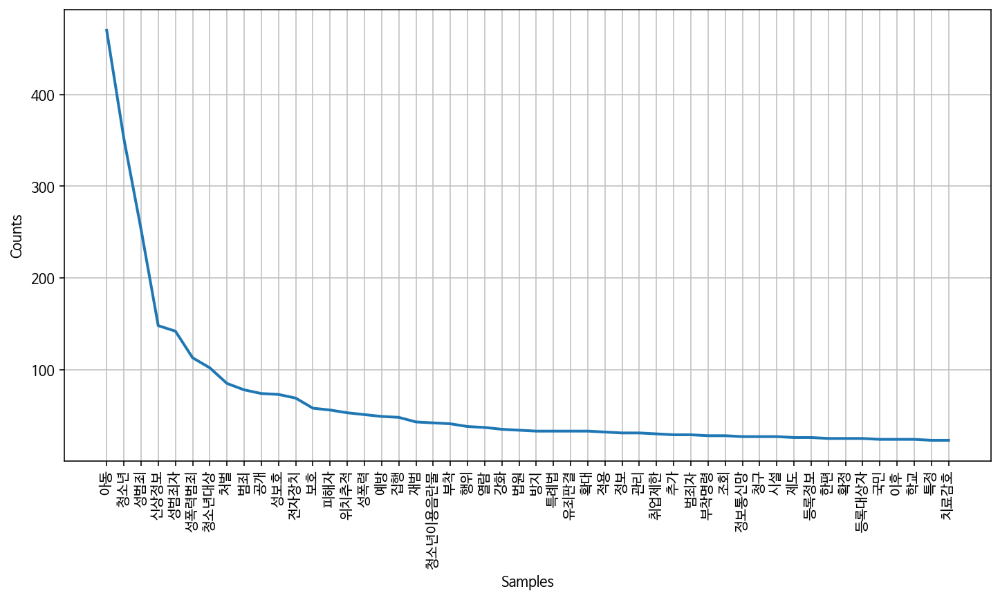

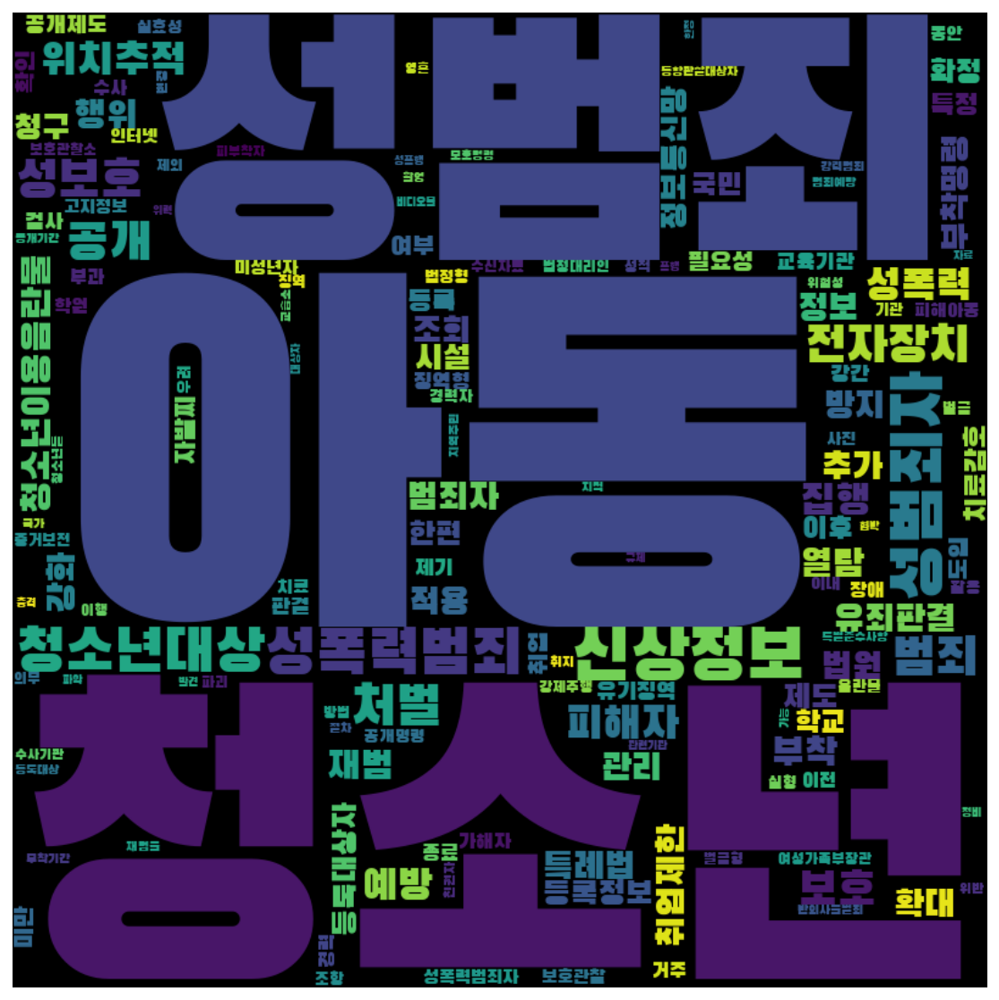

In [179]:
frewords_vis(conservative_g5_tokens)
wordcloud_vis(conservative_g5_tokens)

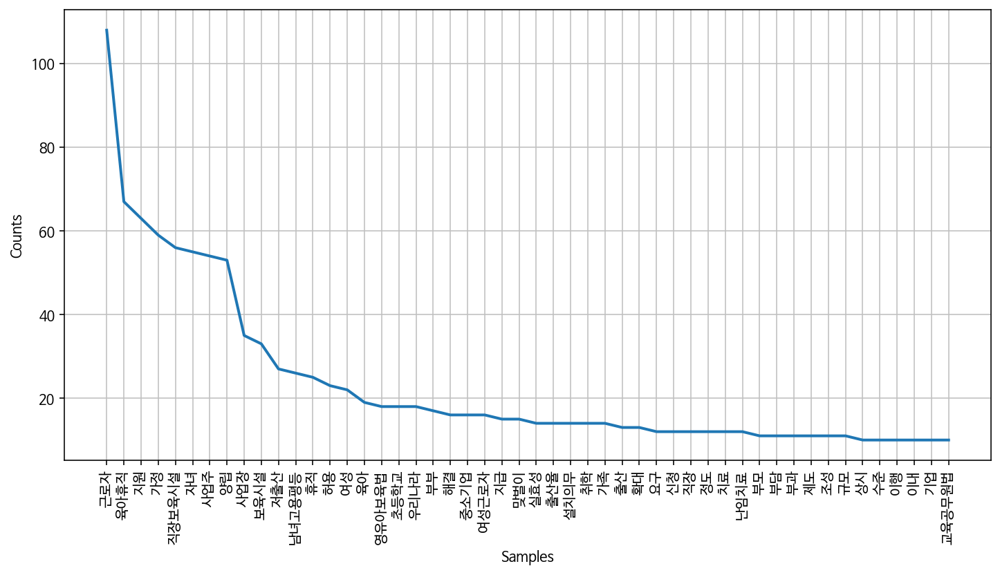

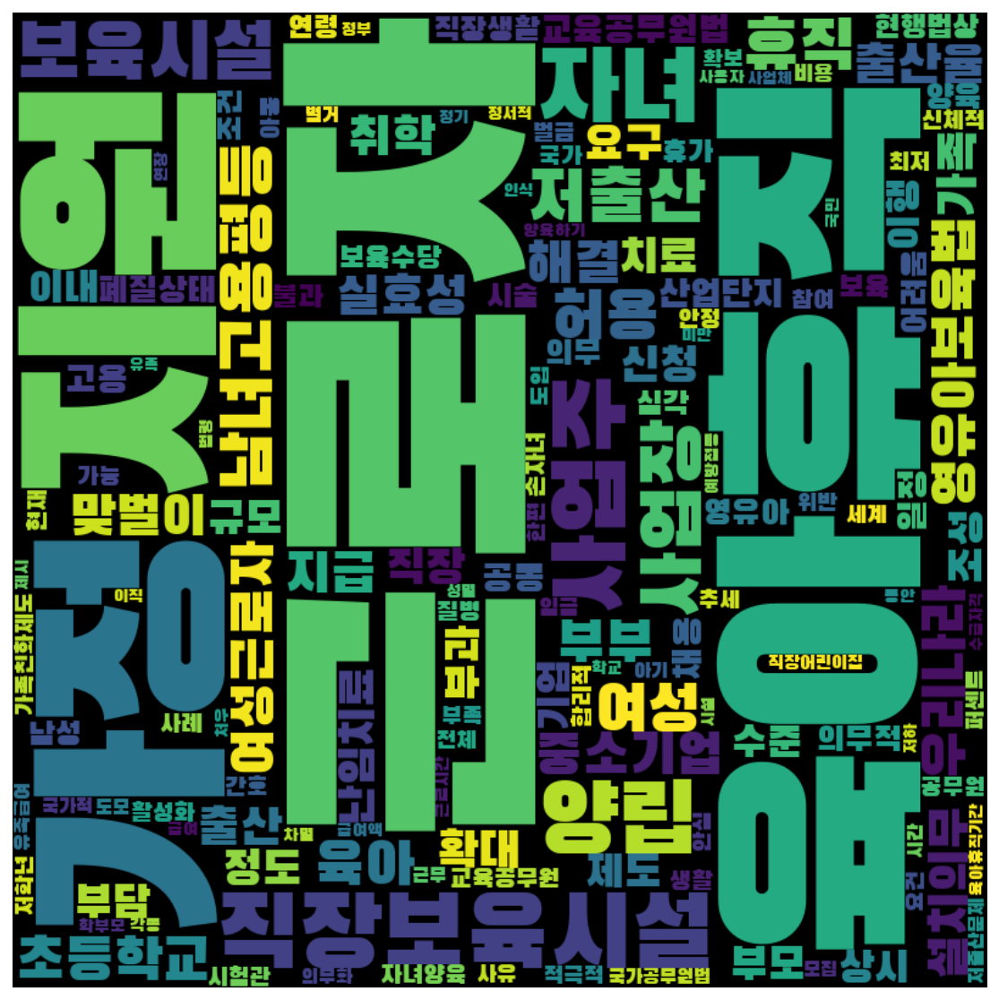

In [180]:
frewords_vis(conservative_g6_tokens)
wordcloud_vis(conservative_g6_tokens)

## 박근혜 정권
- 2013.02.25 ~ 2017.03.13

In [182]:
parkkeunhye = gender[(gender['제안일자'] > datetime.date(2013,2,25)) & 
                        (gender['제안일자'] < datetime.date(2017,5,10))]
parkkeunhye.shape

(1121, 19)

In [183]:
parkkeunhye['정당성향'].value_counts()

진보    675
보수    338
Name: 정당성향, dtype: int64

In [184]:
pd.DataFrame(parkkeunhye.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  170
     여성  168
진보   남성  391
     여성  284

In [185]:
progressive = parkkeunhye[parkkeunhye['정당성향'] == '진보']
conservative = parkkeunhye[parkkeunhye['정당성향'] == '보수']

In [186]:
model_progressive = Word2Vec(progressive['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)
model_conservative = Word2Vec(conservative['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)

2020-10-13 22:08:45,175 : INFO : collecting all words and their counts
2020-10-13 22:08:45,177 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-13 22:08:45,193 : INFO : collected 7392 word types from a corpus of 48581 raw words and 675 sentences
2020-10-13 22:08:45,194 : INFO : Loading a fresh vocabulary
2020-10-13 22:08:45,201 : INFO : effective_min_count=10 retains 976 unique words (13% of original 7392, drops 6416)
2020-10-13 22:08:45,202 : INFO : effective_min_count=10 leaves 33455 word corpus (68% of original 48581, drops 15126)
2020-10-13 22:08:45,208 : INFO : deleting the raw counts dictionary of 7392 items
2020-10-13 22:08:45,209 : INFO : sample=0.001 downsamples 62 most-common words
2020-10-13 22:08:45,209 : INFO : downsampling leaves estimated 29060 word corpus (86.9% of prior 33455)
2020-10-13 22:08:45,216 : INFO : estimated required memory for 976 words and 100 dimensions: 1268800 bytes
2020-10-13 22:08:45,220 : INFO : resetting layer weigh

2020-10-13 22:08:46,151 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:46,156 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:46,160 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:46,161 : INFO : EPOCH - 15 : training on 48581 raw words (29017 effective words) took 0.0s, 834055 effective words/s
2020-10-13 22:08:46,189 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:46,193 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:46,194 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:46,198 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:46,199 : INFO : EPOCH - 16 : training on 48581 raw words (29054 effective words) took 0.0s, 911610 effective words/s
2020-10-13 22:08:46,228 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:08:46,874 : INFO : EPOCH - 31 : training on 48581 raw words (29122 effective words) took 0.0s, 741813 effective words/s
2020-10-13 22:08:46,904 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:46,905 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:46,907 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:46,909 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:46,911 : INFO : EPOCH - 32 : training on 48581 raw words (29097 effective words) took 0.0s, 971824 effective words/s
2020-10-13 22:08:46,935 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:46,952 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:46,957 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:46,959 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:08:47,656 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:47,659 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:47,662 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:47,663 : INFO : EPOCH - 48 : training on 48581 raw words (29062 effective words) took 0.0s, 789094 effective words/s
2020-10-13 22:08:47,692 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:47,695 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:47,696 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:47,700 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:47,702 : INFO : EPOCH - 49 : training on 48581 raw words (29024 effective words) took 0.0s, 828129 effective words/s
2020-10-13 22:08:47,730 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:08:48,349 : INFO : EPOCH - 64 : training on 48581 raw words (29028 effective words) took 0.0s, 845757 effective words/s
2020-10-13 22:08:48,386 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:48,398 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:48,399 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:48,401 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:48,402 : INFO : EPOCH - 65 : training on 48581 raw words (29003 effective words) took 0.0s, 633532 effective words/s
2020-10-13 22:08:48,460 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:48,476 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:48,483 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:48,485 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:08:49,218 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:49,219 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:49,222 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:49,224 : INFO : EPOCH - 81 : training on 48581 raw words (29100 effective words) took 0.0s, 766636 effective words/s
2020-10-13 22:08:49,253 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:49,261 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:49,263 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:49,265 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:49,266 : INFO : EPOCH - 82 : training on 48581 raw words (28935 effective words) took 0.0s, 752907 effective words/s
2020-10-13 22:08:49,301 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:08:49,931 : INFO : EPOCH - 97 : training on 48581 raw words (29013 effective words) took 0.0s, 760102 effective words/s
2020-10-13 22:08:49,960 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:49,965 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:49,967 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:49,970 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:49,971 : INFO : EPOCH - 98 : training on 48581 raw words (29038 effective words) took 0.0s, 938403 effective words/s
2020-10-13 22:08:49,992 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:49,999 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:50,005 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:50,007 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:08:50,642 : INFO : EPOCH - 11 : training on 24345 raw words (12155 effective words) took 0.0s, 788024 effective words/s
2020-10-13 22:08:50,655 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:50,663 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:50,666 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:50,669 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:50,670 : INFO : EPOCH - 12 : training on 24345 raw words (12067 effective words) took 0.0s, 635753 effective words/s
2020-10-13 22:08:50,681 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:50,691 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:50,693 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:50,696 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:08:51,118 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:51,122 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:51,124 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:51,126 : INFO : EPOCH - 28 : training on 24345 raw words (12217 effective words) took 0.0s, 694859 effective words/s
2020-10-13 22:08:51,140 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:51,145 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:51,146 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:51,147 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:51,149 : INFO : EPOCH - 29 : training on 24345 raw words (12218 effective words) took 0.0s, 1208456 effective words/s
2020-10-13 22:08:51,156 : INFO : worker thread finished; awaiting finish of 3 more threads
202

2020-10-13 22:08:51,576 : INFO : EPOCH - 44 : training on 24345 raw words (12204 effective words) took 0.0s, 542053 effective words/s
2020-10-13 22:08:51,583 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:51,592 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:51,595 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:51,597 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:51,598 : INFO : EPOCH - 45 : training on 24345 raw words (12197 effective words) took 0.0s, 651403 effective words/s
2020-10-13 22:08:51,608 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:51,620 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:51,622 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:51,627 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:08:52,064 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:52,066 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:52,069 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:52,071 : INFO : EPOCH - 61 : training on 24345 raw words (12210 effective words) took 0.0s, 666764 effective words/s
2020-10-13 22:08:52,078 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:52,096 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:52,100 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:52,102 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:52,103 : INFO : EPOCH - 62 : training on 24345 raw words (12267 effective words) took 0.0s, 449020 effective words/s
2020-10-13 22:08:52,112 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:08:52,533 : INFO : EPOCH - 77 : training on 24345 raw words (12154 effective words) took 0.0s, 522307 effective words/s
2020-10-13 22:08:52,546 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:52,560 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:52,572 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:52,573 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:52,575 : INFO : EPOCH - 78 : training on 24345 raw words (12203 effective words) took 0.0s, 382033 effective words/s
2020-10-13 22:08:52,586 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:52,596 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:52,600 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:52,602 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:08:53,004 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:53,006 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:53,008 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:53,010 : INFO : EPOCH - 94 : training on 24345 raw words (12154 effective words) took 0.0s, 763418 effective words/s
2020-10-13 22:08:53,021 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:08:53,030 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:08:53,031 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:08:53,032 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:08:53,037 : INFO : EPOCH - 95 : training on 24345 raw words (12123 effective words) took 0.0s, 757804 effective words/s
2020-10-13 22:08:53,051 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

In [187]:
print(model_progressive.wv.most_similar('여성'))
print(model_conservative.wv.most_similar('여성'))

2020-10-13 22:08:53,384 : INFO : precomputing L2-norms of word weight vectors
2020-10-13 22:08:53,389 : INFO : precomputing L2-norms of word weight vectors


[('정치', 0.5652403831481934), ('정치참여', 0.49920186400413513), ('개국', 0.47855228185653687), ('남성', 0.46615105867385864), ('격차', 0.4608581066131592), ('한국', 0.42436403036117554), ('남녀', 0.396193265914917), ('지수', 0.39308691024780273), ('임기만료', 0.36856913566589355), ('분야', 0.34590575098991394)]
[('동등', 0.5711514949798584), ('불과', 0.5275887250900269), ('정치', 0.5195097923278809), ('경제활동', 0.5154809951782227), ('경력단절여성등', 0.4860994815826416), ('실현', 0.47557157278060913), ('적극적', 0.4690943956375122), ('우리나라', 0.45809951424598694), ('확산', 0.4566640257835388), ('여성들', 0.4544360637664795)]


In [188]:
progressive['문장벡터'] = progressive['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_progressive))
conservative['문장벡터'] = conservative['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_conservative))

<ipython-input-188-7f57b9f27847>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  progressive['문장벡터'] = progressive['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_progressive))
<ipython-input-188-7f57b9f27847>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  conservative['문장벡터'] = conservative['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_conservative))


#### 진보

In [189]:
# K means 수행 
word_vectors_pro = progressive['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro)
progressive['category'] = idx

<ipython-input-189-b83bfee9be13>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  progressive['category'] = idx


In [190]:
progressive['category'].value_counts()

5    134
4    134
1    119
3    116
2     89
0     83
Name: category, dtype: int64

In [191]:
progressive_g1 = progressive[progressive['category'] == 0]
progressive_g2 = progressive[progressive['category'] == 1]
progressive_g3 = progressive[progressive['category'] == 2]
progressive_g4 = progressive[progressive['category'] == 3]
progressive_g5 = progressive[progressive['category'] == 4]
progressive_g6 = progressive[progressive['category'] == 5]

In [192]:
progressive_g1_tokens = total_tokens(progressive_g1['tokens'])
progressive_g2_tokens = total_tokens(progressive_g2['tokens'])
progressive_g3_tokens = total_tokens(progressive_g3['tokens'])
progressive_g4_tokens = total_tokens(progressive_g4['tokens'])
progressive_g5_tokens = total_tokens(progressive_g5['tokens'])
progressive_g6_tokens = total_tokens(progressive_g6['tokens'])

In [193]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
progressive_g1_tokens = [each_word for each_word in progressive_g1_tokens if each_word not in stopwords]
progressive_g2_tokens = [each_word for each_word in progressive_g2_tokens if each_word not in stopwords]
progressive_g3_tokens = [each_word for each_word in progressive_g3_tokens if each_word not in stopwords]
progressive_g4_tokens = [each_word for each_word in progressive_g4_tokens if each_word not in stopwords]
progressive_g5_tokens = [each_word for each_word in progressive_g5_tokens if each_word not in stopwords]
progressive_g6_tokens = [each_word for each_word in progressive_g6_tokens if each_word not in stopwords]

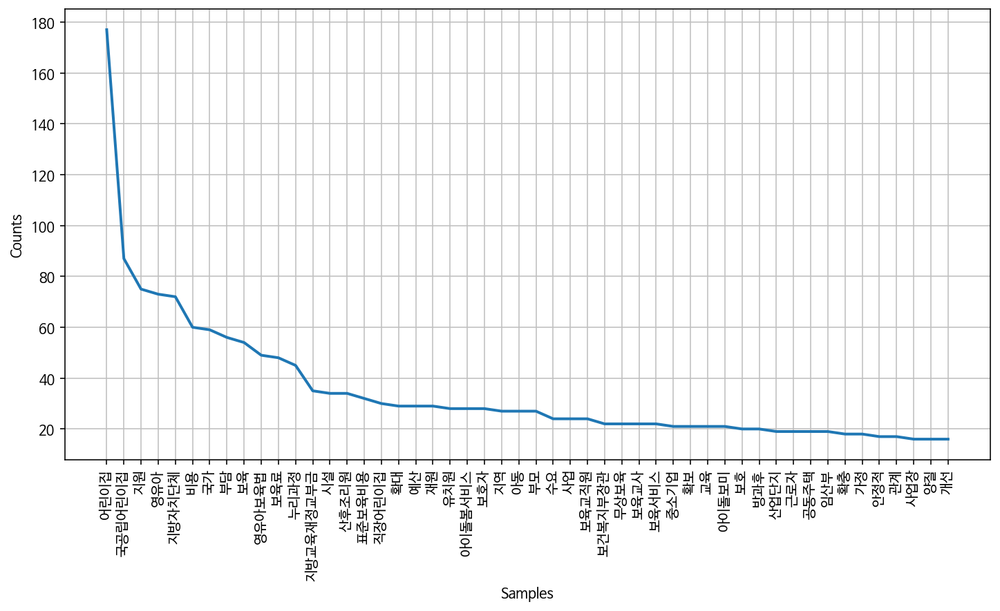

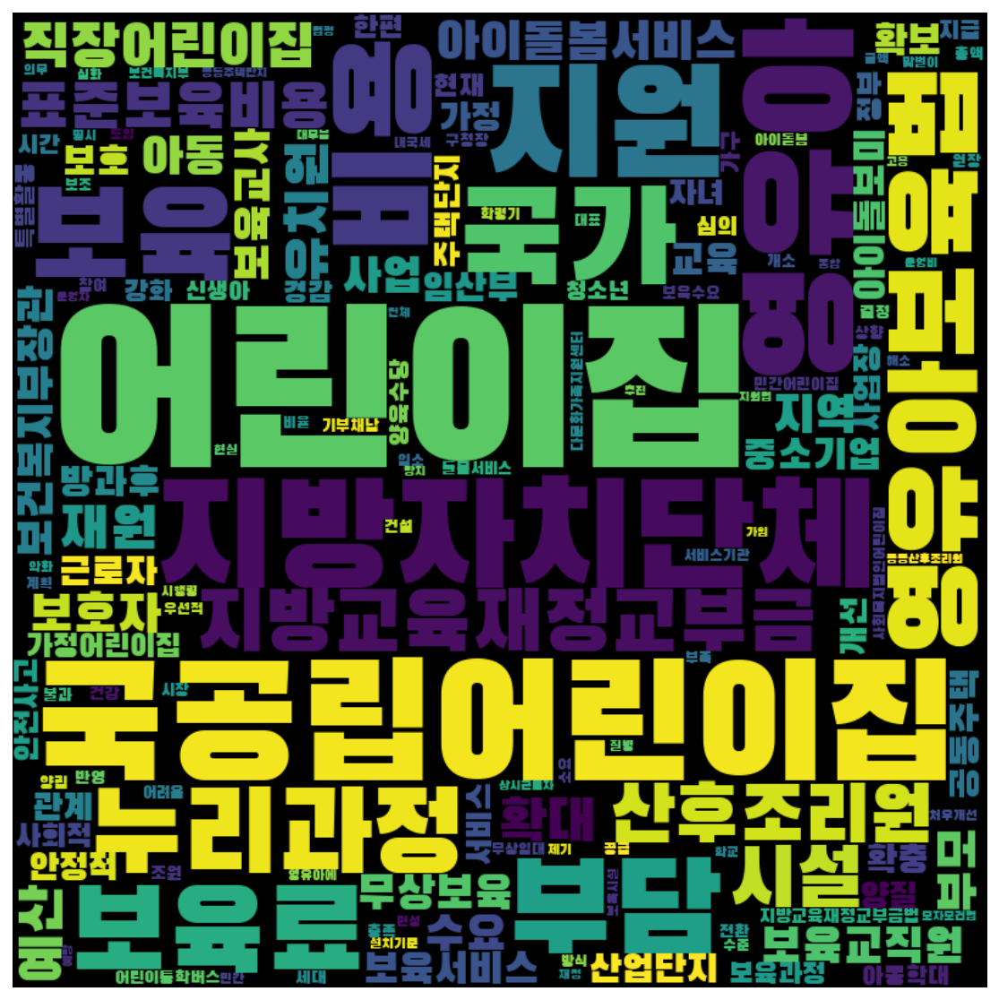

In [194]:
frewords_vis(progressive_g1_tokens)
wordcloud_vis(progressive_g1_tokens)

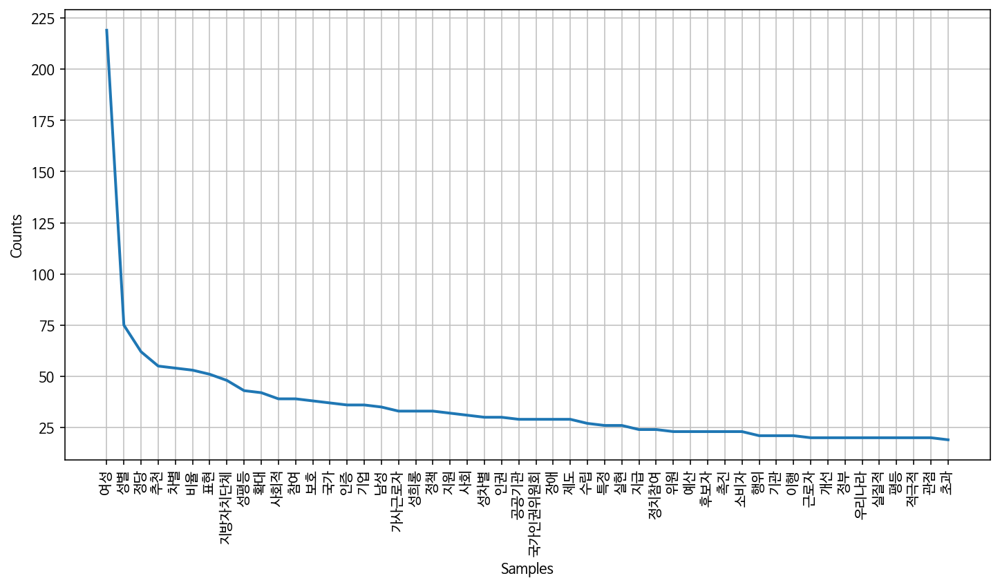

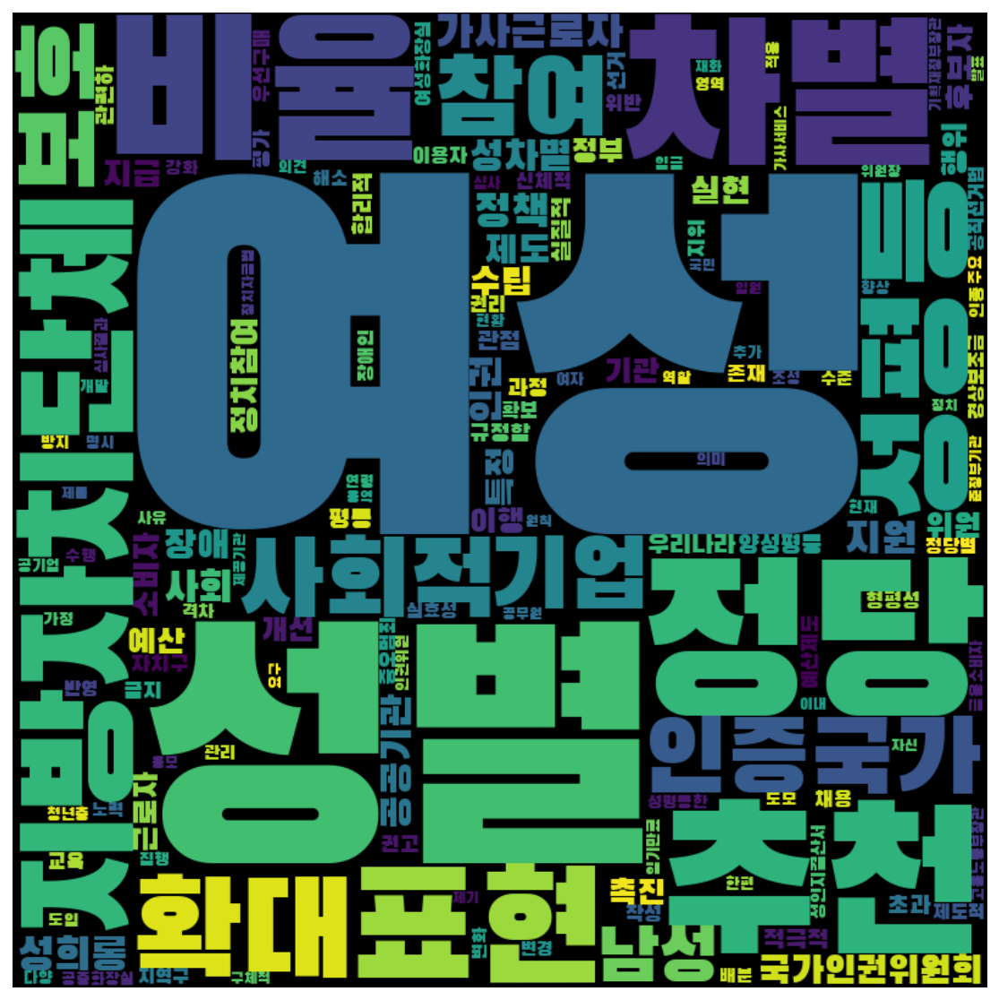

In [195]:
frewords_vis(progressive_g2_tokens)
wordcloud_vis(progressive_g2_tokens)

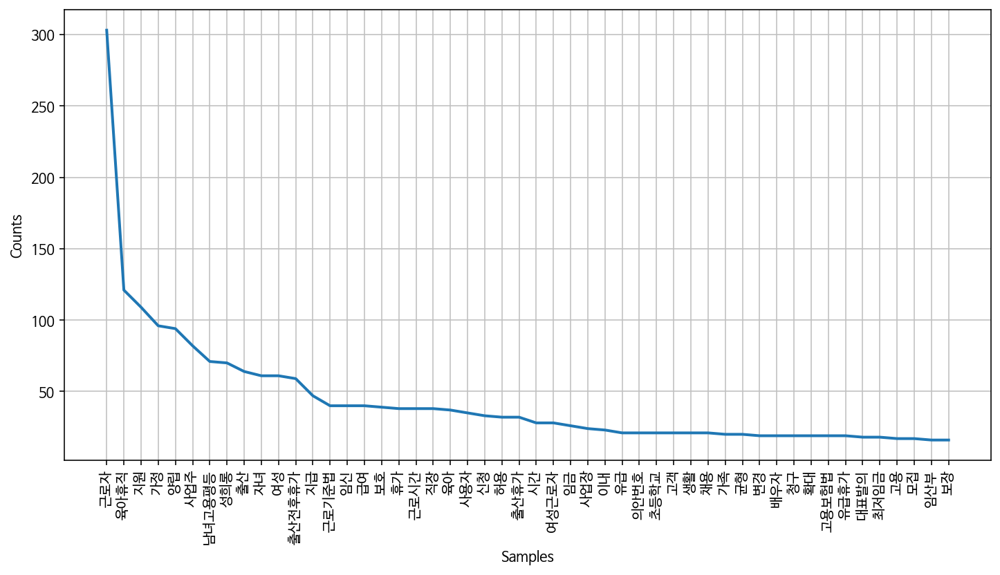

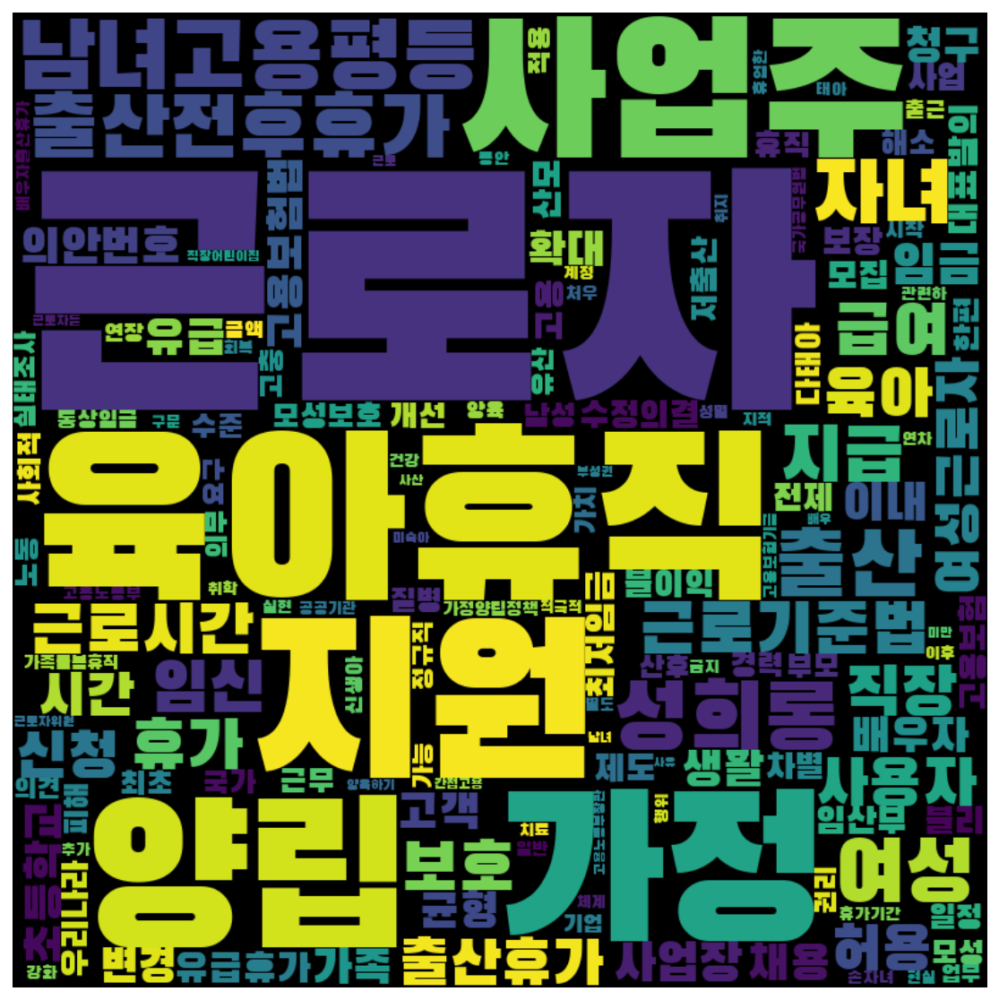

In [196]:
frewords_vis(progressive_g3_tokens)
wordcloud_vis(progressive_g3_tokens)

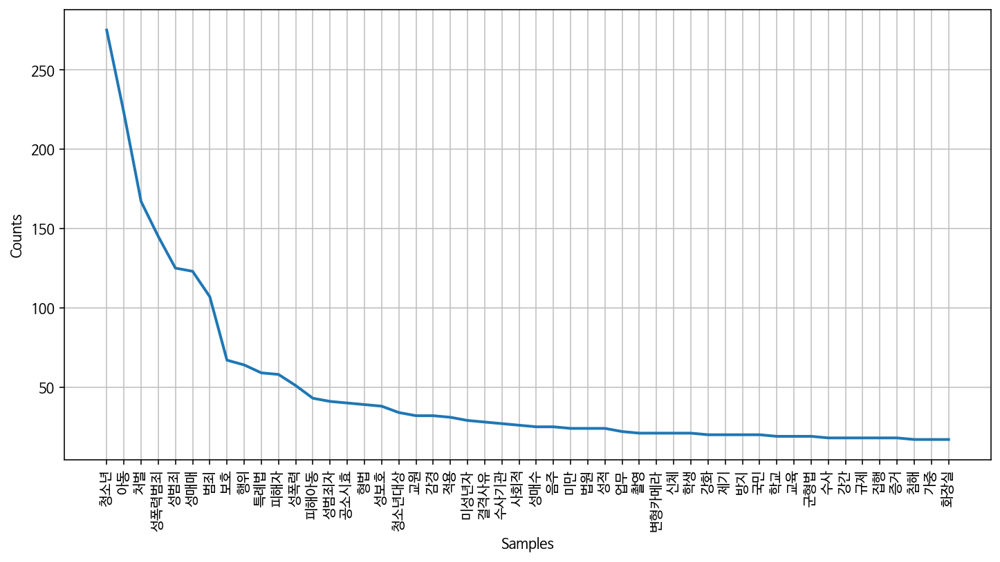

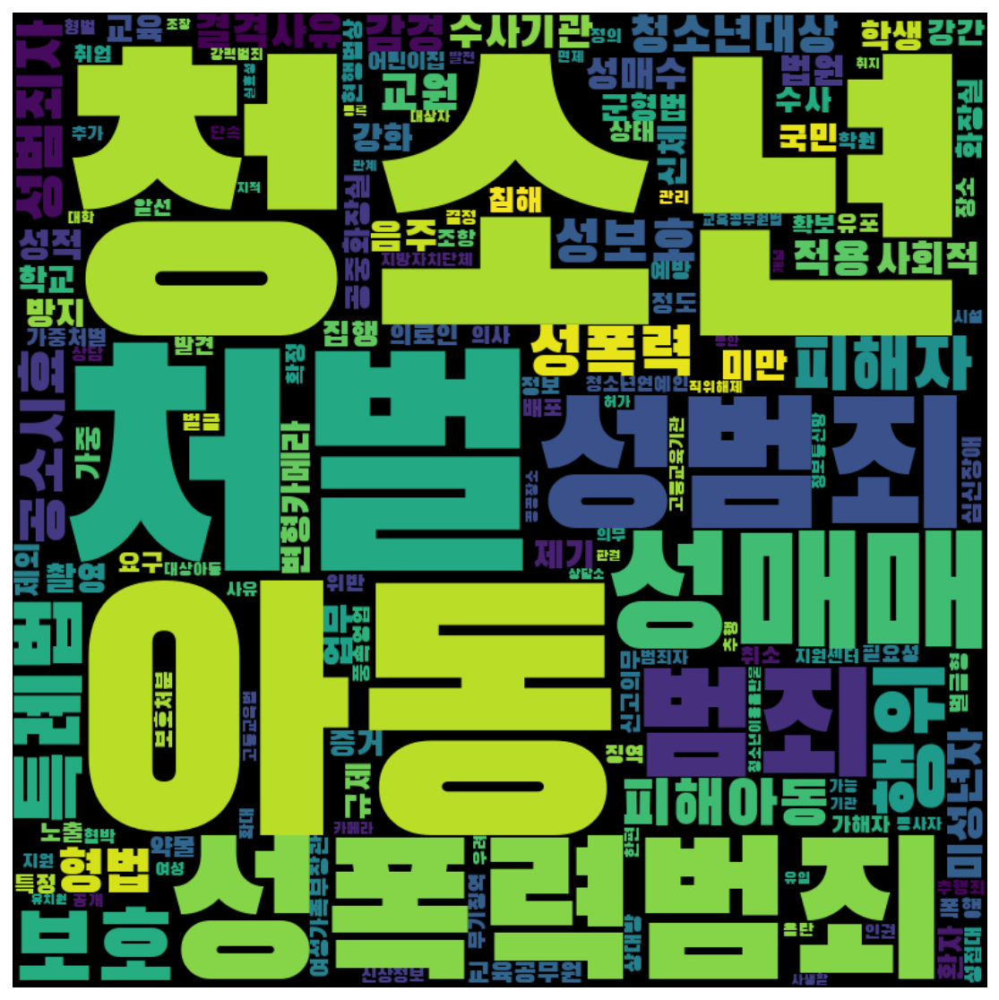

In [197]:
frewords_vis(progressive_g4_tokens)
wordcloud_vis(progressive_g4_tokens)

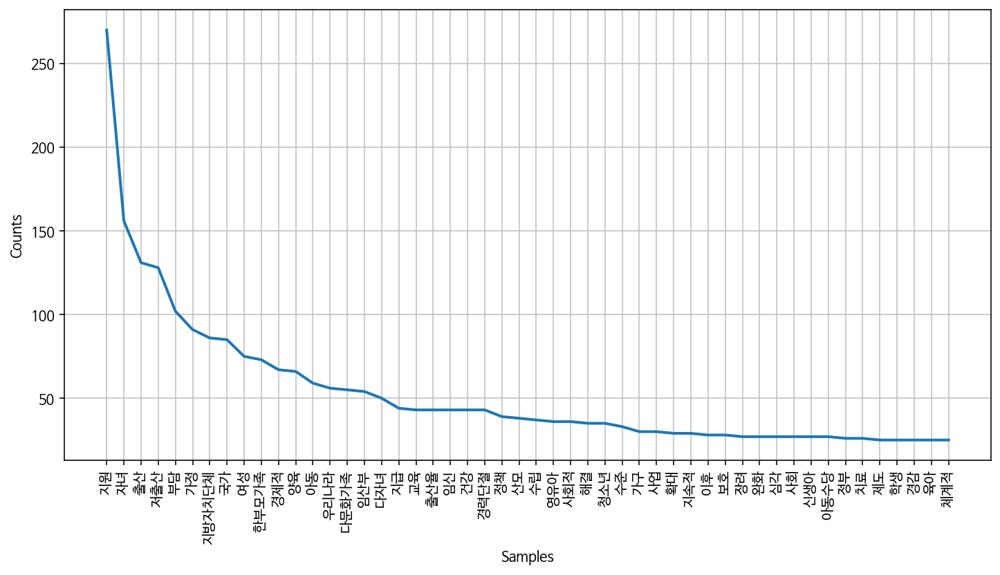

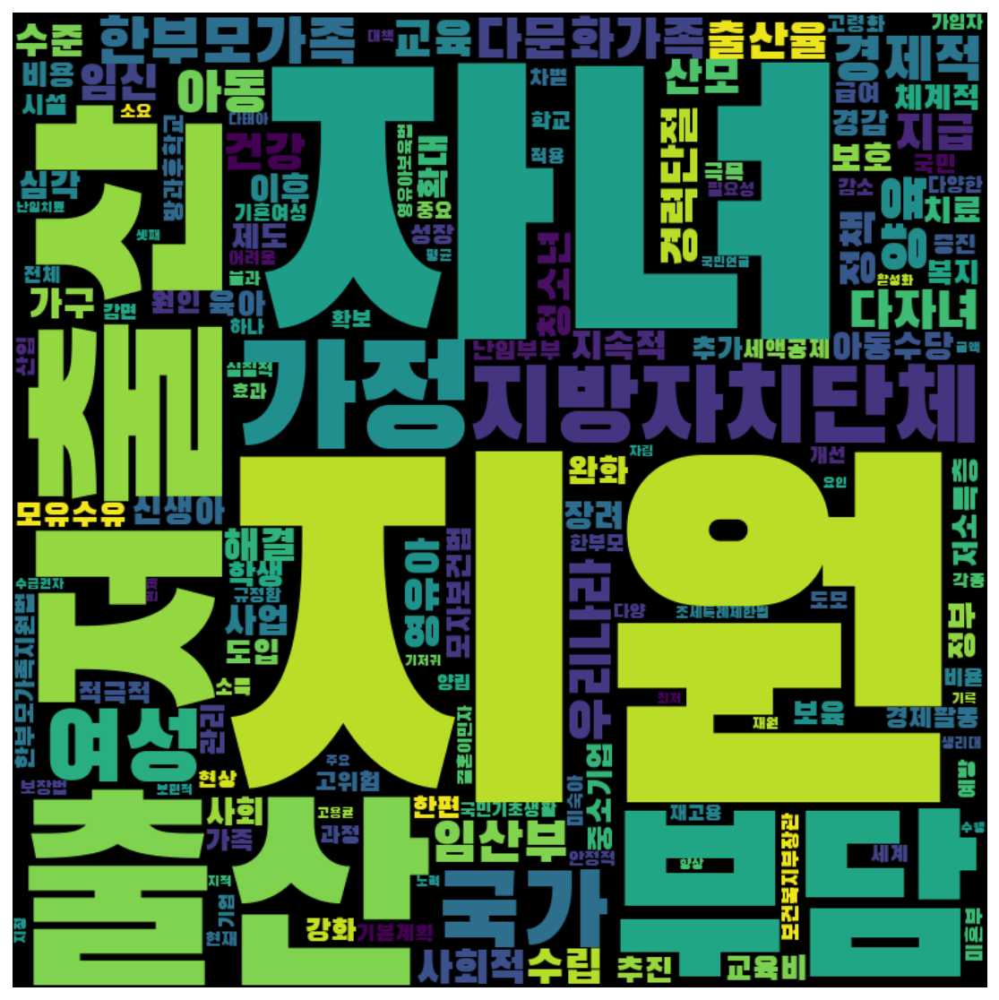

In [198]:
frewords_vis(progressive_g5_tokens)
wordcloud_vis(progressive_g5_tokens)

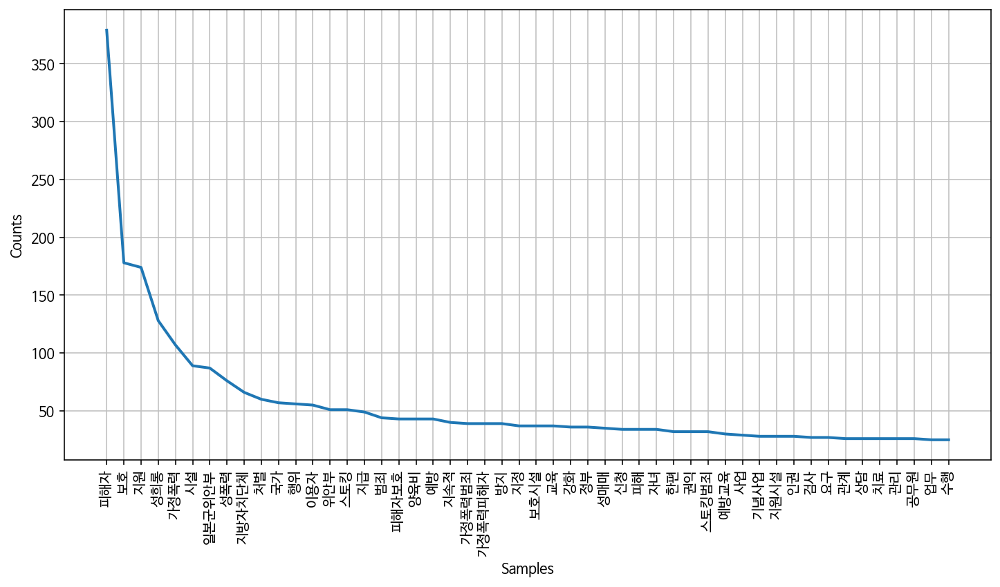

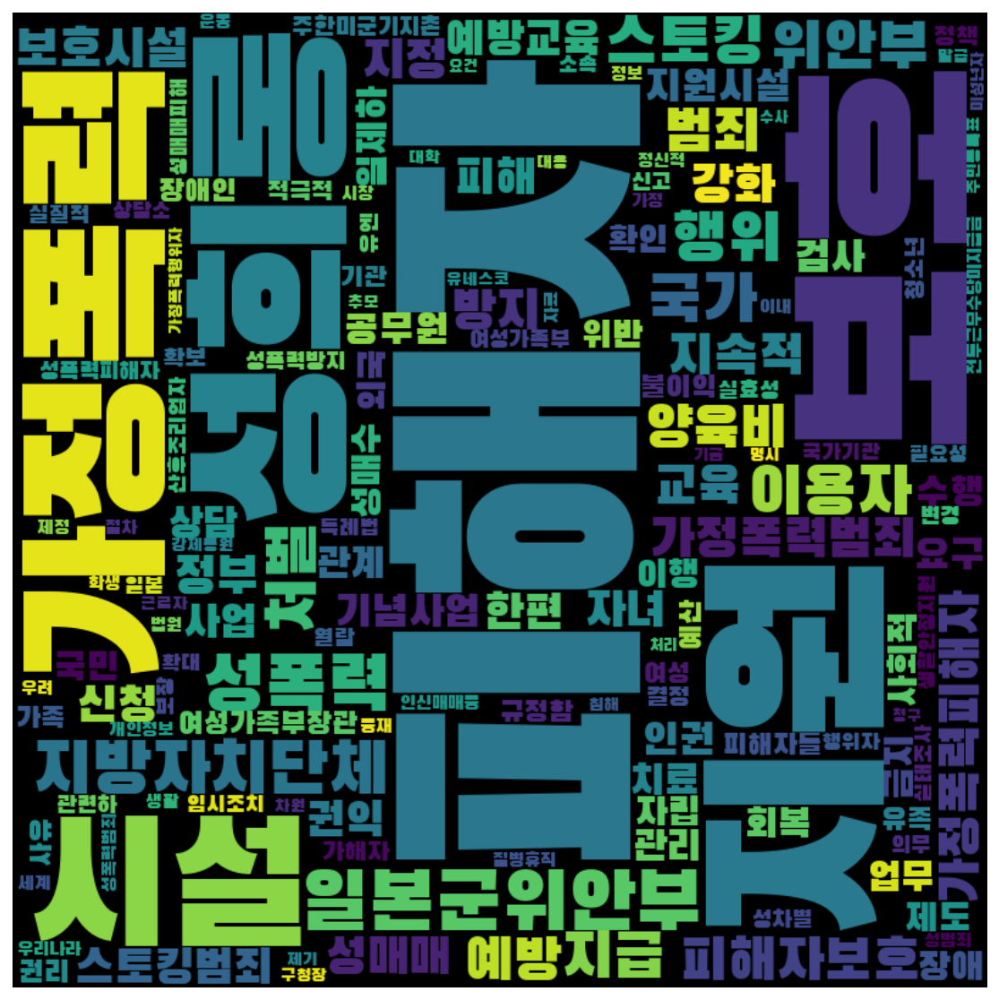

In [199]:
frewords_vis(progressive_g6_tokens)
wordcloud_vis(progressive_g6_tokens)

#### 보수

In [200]:
# K means 수행 
word_vectors_con = conservative['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con)
conservative['category'] = idx

<ipython-input-200-413f37cc3da8>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  conservative['category'] = idx


In [201]:
conservative['category'].value_counts()

1    130
0     75
5     63
4     41
2     17
3     12
Name: category, dtype: int64

In [202]:
conservative_g1 = conservative[conservative['category'] == 0]
conservative_g2 = conservative[conservative['category'] == 1]
conservative_g3 = conservative[conservative['category'] == 2]
conservative_g4 = conservative[conservative['category'] == 3]
conservative_g5 = conservative[conservative['category'] == 4]
conservative_g6 = conservative[conservative['category'] == 5]

In [203]:
conservative_g1_tokens = total_tokens(conservative_g1['tokens'])
conservative_g2_tokens = total_tokens(conservative_g2['tokens'])
conservative_g3_tokens = total_tokens(conservative_g3['tokens'])
conservative_g4_tokens = total_tokens(conservative_g4['tokens'])
conservative_g5_tokens = total_tokens(conservative_g5['tokens'])
conservative_g6_tokens = total_tokens(conservative_g6['tokens'])

In [204]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
conservative_g1_tokens = [each_word for each_word in conservative_g1_tokens if each_word not in stopwords]
conservative_g2_tokens = [each_word for each_word in conservative_g2_tokens if each_word not in stopwords]
conservative_g3_tokens = [each_word for each_word in conservative_g3_tokens if each_word not in stopwords]
conservative_g4_tokens = [each_word for each_word in conservative_g4_tokens if each_word not in stopwords]
conservative_g5_tokens = [each_word for each_word in conservative_g5_tokens if each_word not in stopwords]
conservative_g6_tokens = [each_word for each_word in conservative_g6_tokens if each_word not in stopwords]

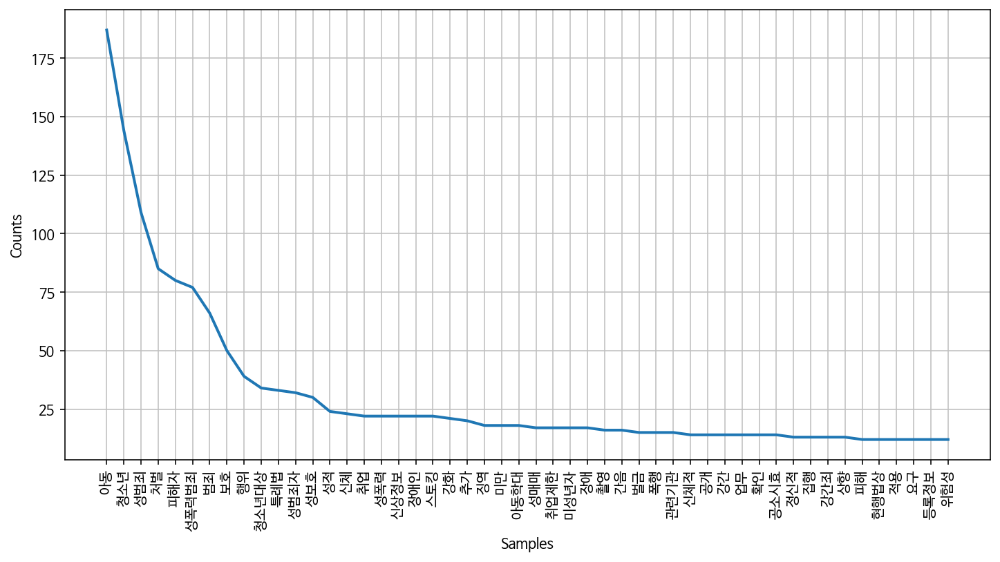

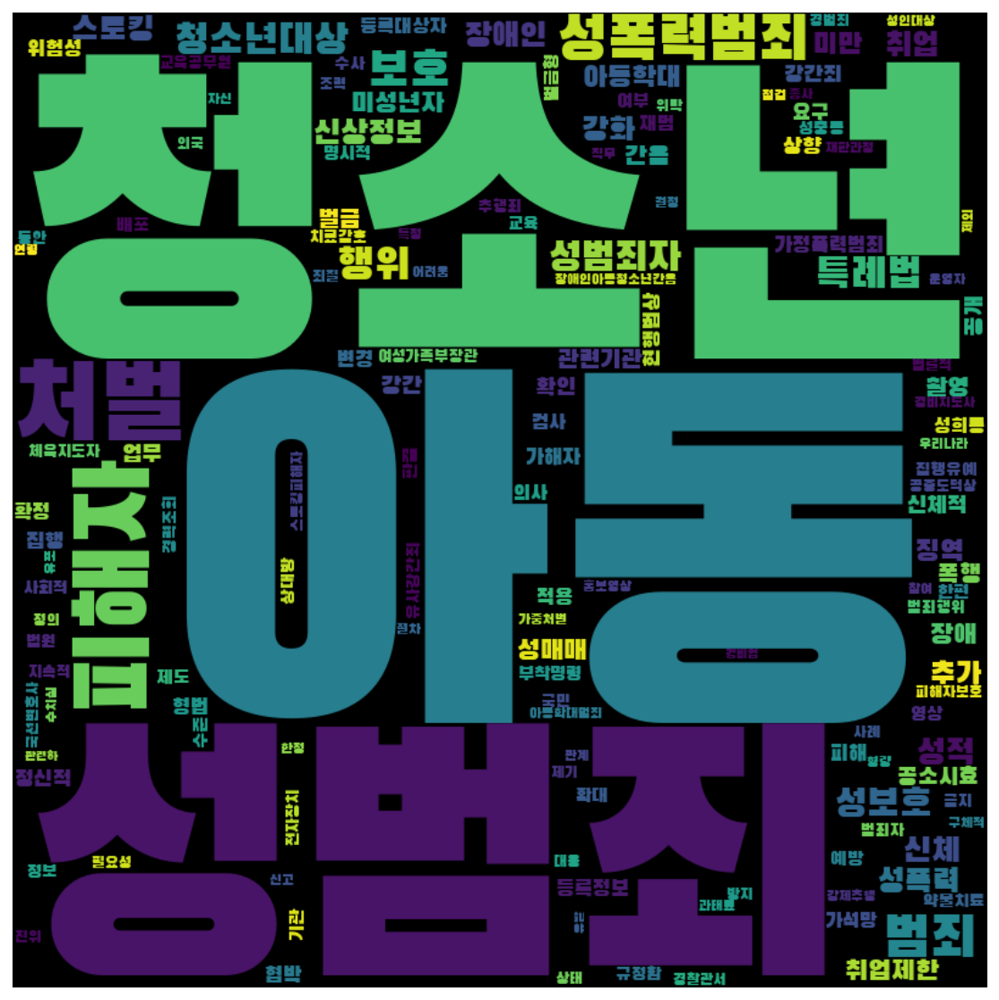

In [205]:
frewords_vis(conservative_g1_tokens)
wordcloud_vis(conservative_g1_tokens)

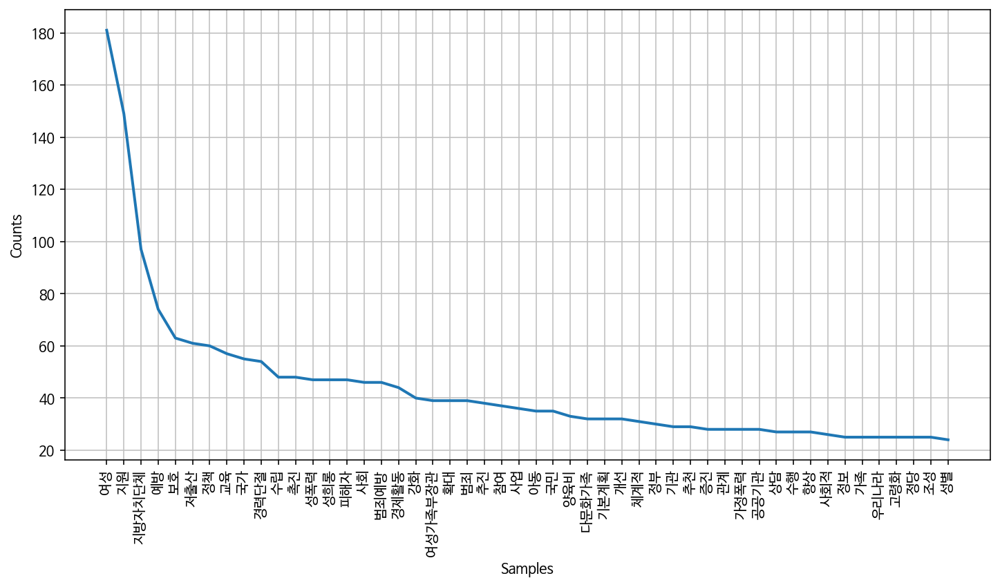

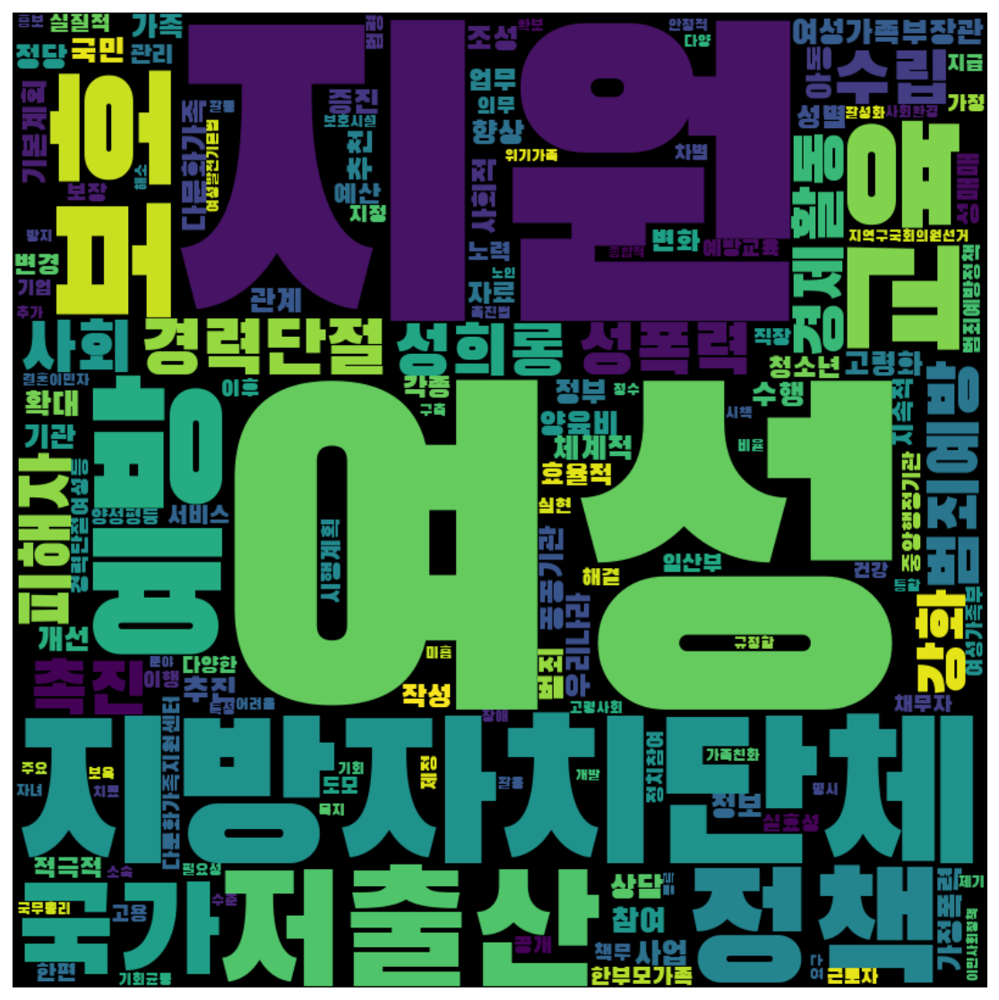

In [206]:
frewords_vis(conservative_g2_tokens)
wordcloud_vis(conservative_g2_tokens)

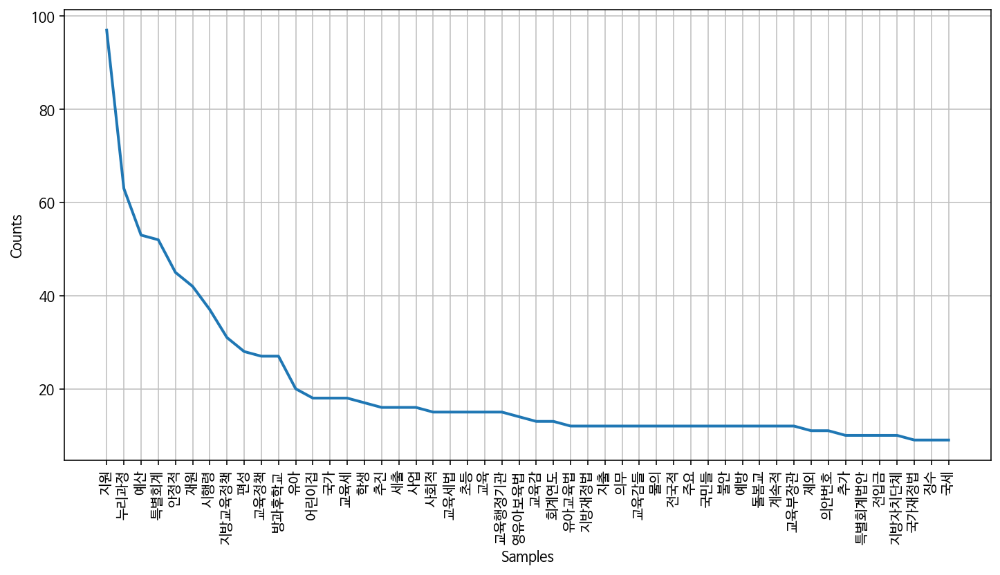

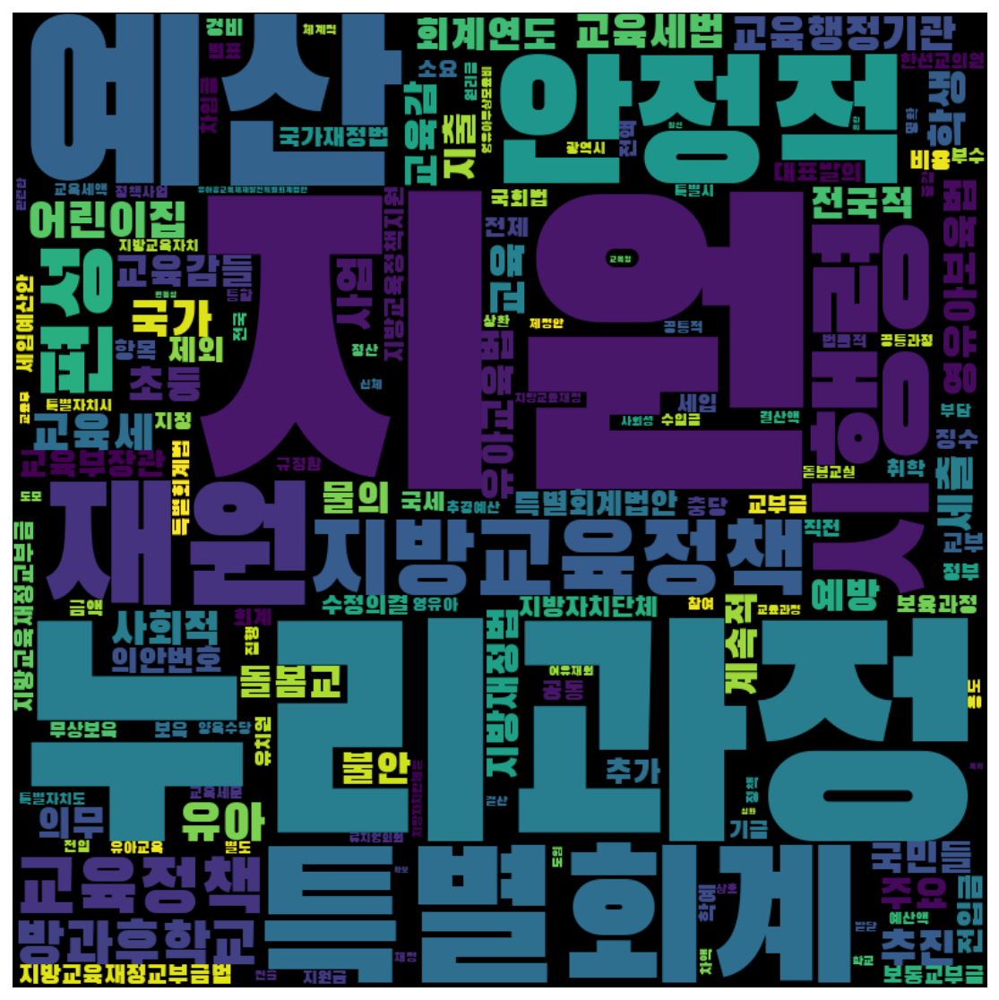

In [207]:
frewords_vis(conservative_g3_tokens)
wordcloud_vis(conservative_g3_tokens)

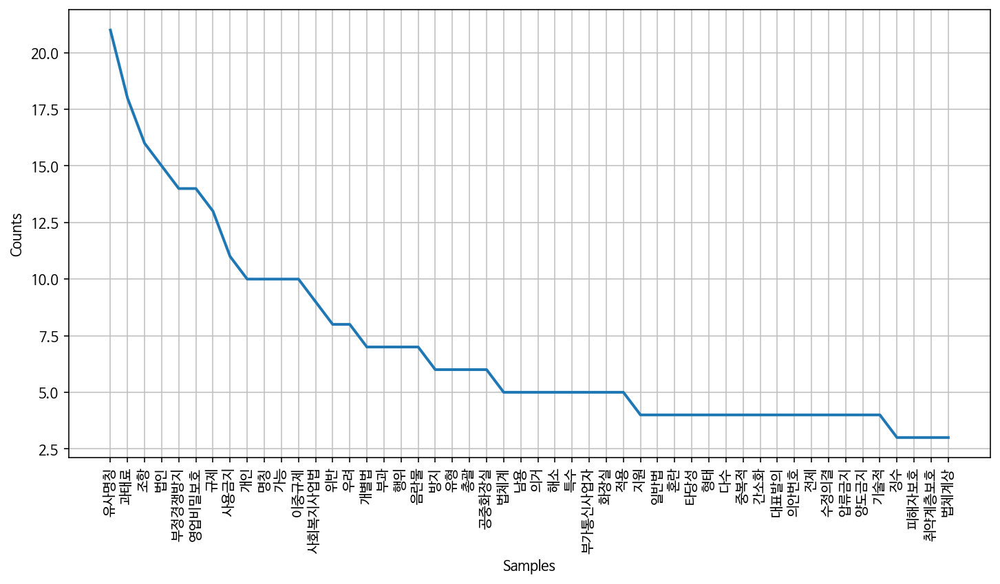

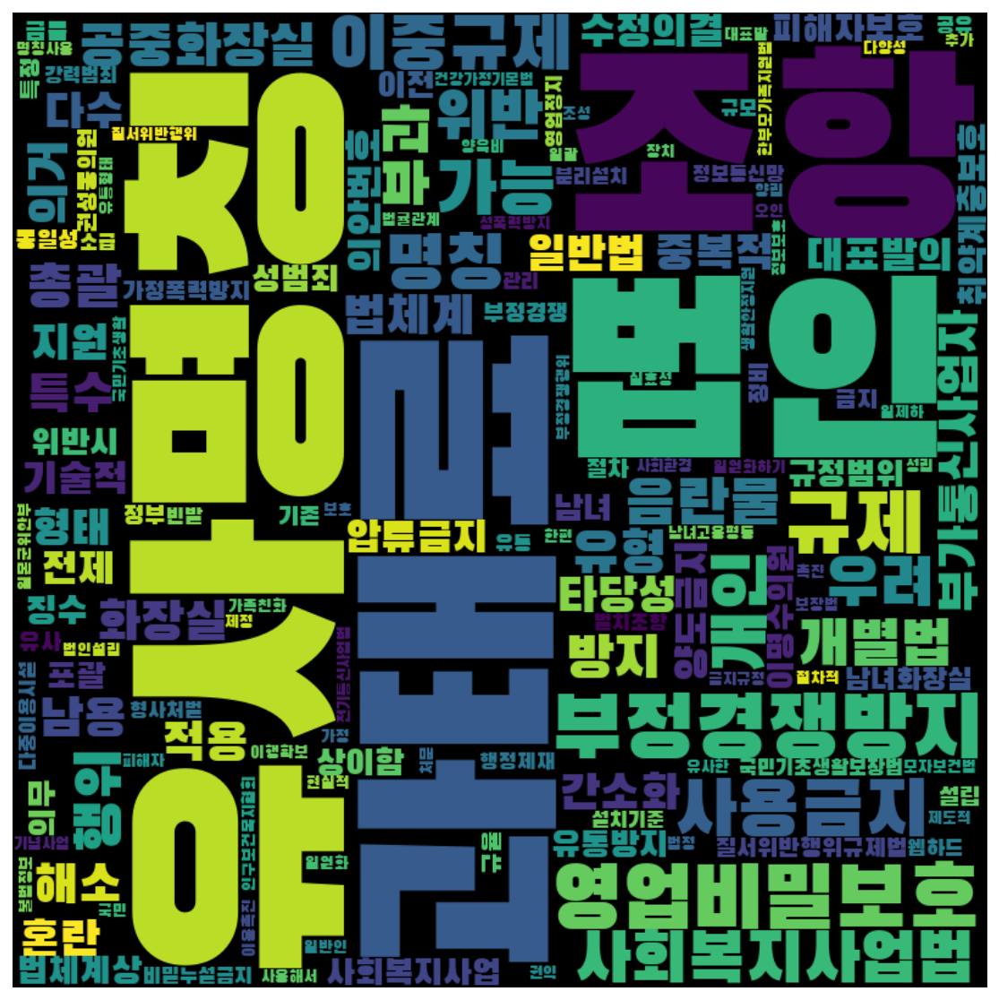

In [208]:
frewords_vis(conservative_g4_tokens)
wordcloud_vis(conservative_g4_tokens)

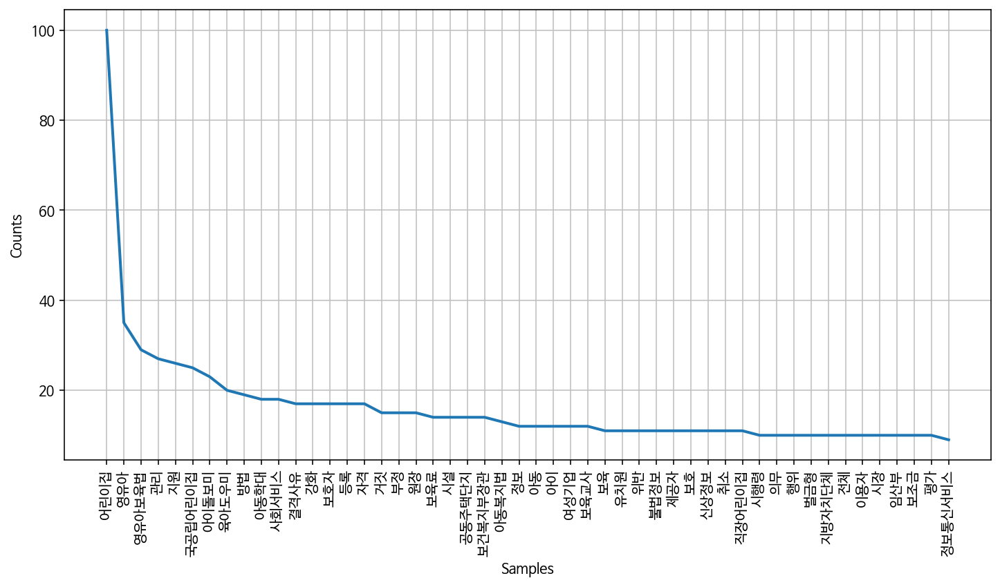

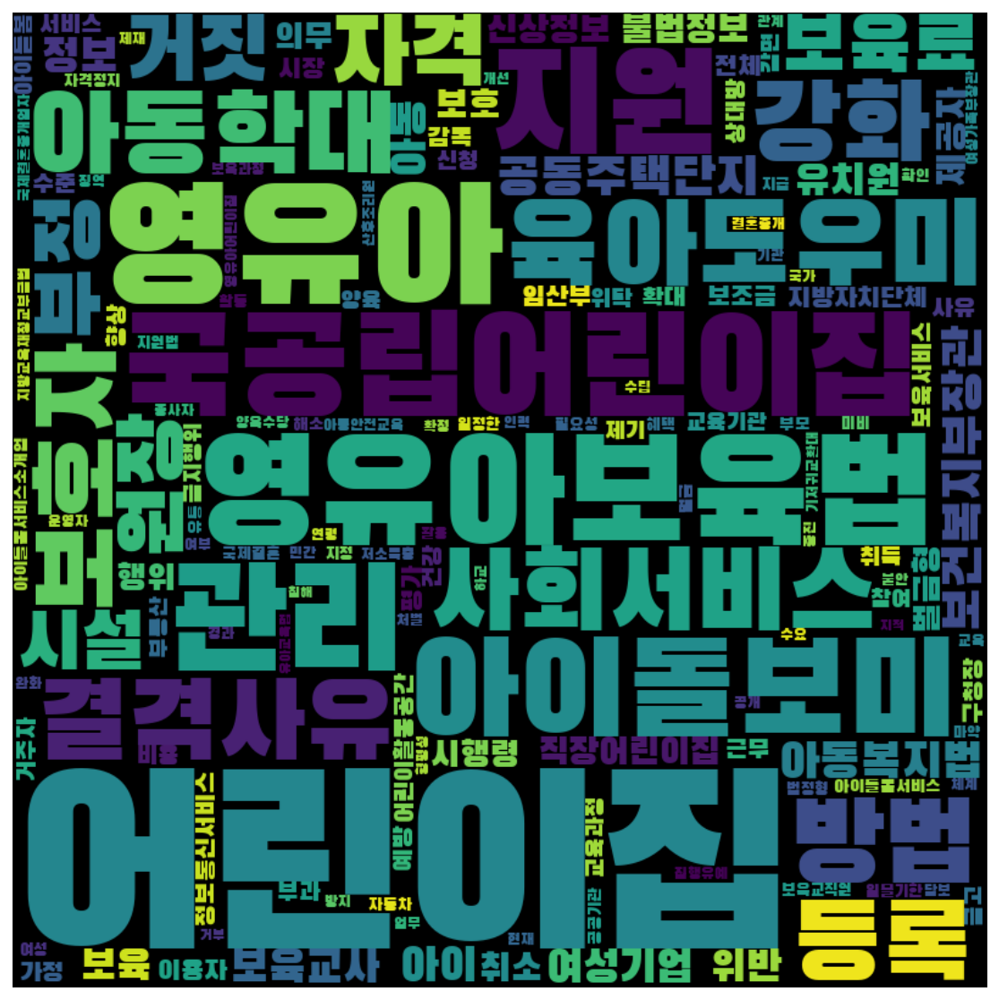

In [209]:
frewords_vis(conservative_g5_tokens)
wordcloud_vis(conservative_g5_tokens)

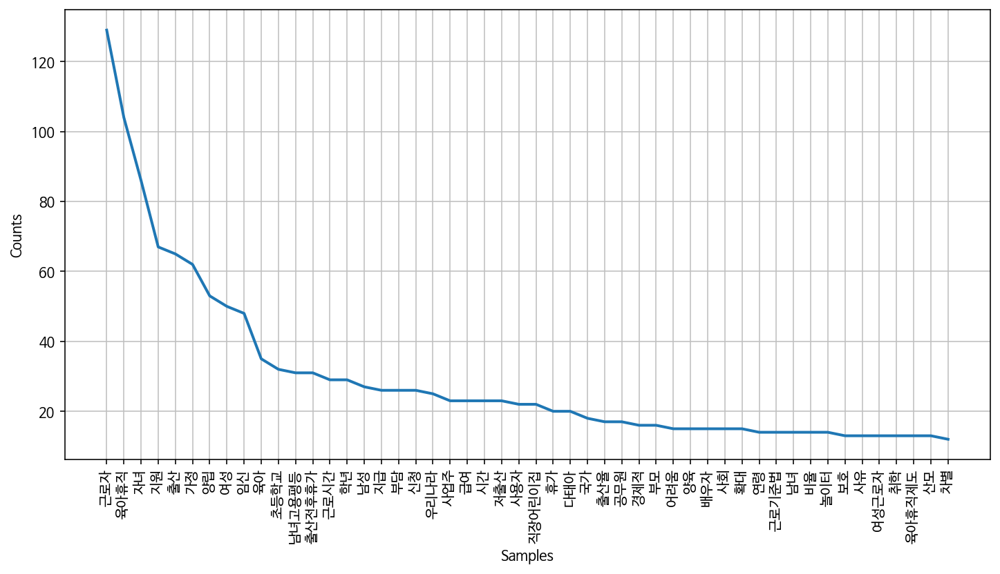

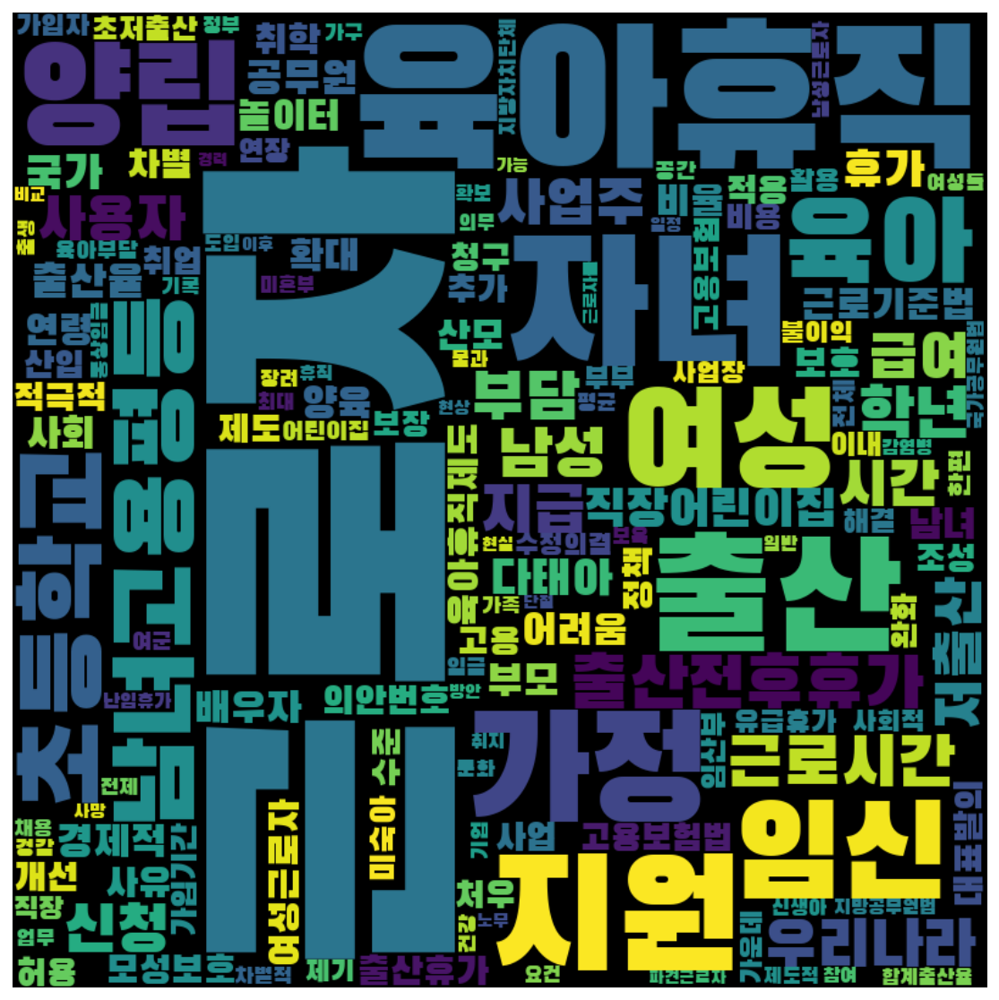

In [210]:
frewords_vis(conservative_g6_tokens)
wordcloud_vis(conservative_g6_tokens)

## 문재인 정권 
- 2017.05.10 ~

In [212]:
moonjaein = gender[(gender['제안일자'] > datetime.date(2017,5,10))]
moonjaein.shape

(1410, 19)

In [213]:
moonjaein['정당성향'].value_counts()

진보    859
보수    410
Name: 정당성향, dtype: int64

In [214]:
pd.DataFrame(moonjaein.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  234
     여성  176
진보   남성  510
     여성  349

In [215]:
progressive = moonjaein[moonjaein['정당성향'] == '진보']
conservative = moonjaein[moonjaein['정당성향'] == '보수']

In [216]:
model_progressive = Word2Vec(progressive['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)
model_conservative = Word2Vec(conservative['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=0)

2020-10-13 22:15:49,460 : INFO : collecting all words and their counts
2020-10-13 22:15:49,461 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-13 22:15:49,476 : INFO : collected 7943 word types from a corpus of 56563 raw words and 859 sentences
2020-10-13 22:15:49,477 : INFO : Loading a fresh vocabulary
2020-10-13 22:15:49,483 : INFO : effective_min_count=10 retains 1108 unique words (13% of original 7943, drops 6835)
2020-10-13 22:15:49,483 : INFO : effective_min_count=10 leaves 40796 word corpus (72% of original 56563, drops 15767)
2020-10-13 22:15:49,488 : INFO : deleting the raw counts dictionary of 7943 items
2020-10-13 22:15:49,488 : INFO : sample=0.001 downsamples 58 most-common words
2020-10-13 22:15:49,489 : INFO : downsampling leaves estimated 35945 word corpus (88.1% of prior 40796)
2020-10-13 22:15:49,492 : INFO : estimated required memory for 1108 words and 100 dimensions: 1440400 bytes
2020-10-13 22:15:49,493 : INFO : resetting layer wei

2020-10-13 22:15:50,419 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:50,420 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:50,421 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:50,423 : INFO : EPOCH - 15 : training on 56563 raw words (35967 effective words) took 0.0s, 826958 effective words/s
2020-10-13 22:15:50,464 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:50,465 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:50,471 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:50,475 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:50,476 : INFO : EPOCH - 16 : training on 56563 raw words (35963 effective words) took 0.0s, 737964 effective words/s
2020-10-13 22:15:50,514 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:15:51,199 : INFO : EPOCH - 31 : training on 56563 raw words (35922 effective words) took 0.0s, 817591 effective words/s
2020-10-13 22:15:51,237 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:51,239 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:51,245 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:51,247 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:51,249 : INFO : EPOCH - 32 : training on 56563 raw words (35909 effective words) took 0.0s, 826527 effective words/s
2020-10-13 22:15:51,287 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:51,290 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:51,294 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:51,297 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:15:51,986 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:51,989 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:51,989 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:51,990 : INFO : EPOCH - 48 : training on 56563 raw words (35979 effective words) took 0.0s, 892058 effective words/s
2020-10-13 22:15:52,033 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:52,037 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:52,039 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:52,041 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:52,042 : INFO : EPOCH - 49 : training on 56563 raw words (35846 effective words) took 0.0s, 775620 effective words/s
2020-10-13 22:15:52,082 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:15:52,764 : INFO : EPOCH - 64 : training on 56563 raw words (35896 effective words) took 0.0s, 930666 effective words/s
2020-10-13 22:15:52,795 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:52,799 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:52,803 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:52,805 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:52,806 : INFO : EPOCH - 65 : training on 56563 raw words (35903 effective words) took 0.0s, 974681 effective words/s
2020-10-13 22:15:52,835 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:52,841 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:52,842 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:52,844 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:15:53,612 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:53,615 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:53,617 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:53,618 : INFO : EPOCH - 81 : training on 56563 raw words (35877 effective words) took 0.0s, 873124 effective words/s
2020-10-13 22:15:53,657 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:53,667 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:53,669 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:53,671 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:53,673 : INFO : EPOCH - 82 : training on 56563 raw words (35954 effective words) took 0.1s, 704633 effective words/s
2020-10-13 22:15:53,714 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:15:54,393 : INFO : EPOCH - 97 : training on 56563 raw words (35910 effective words) took 0.0s, 732986 effective words/s
2020-10-13 22:15:54,436 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:54,440 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:54,442 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:54,444 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:54,447 : INFO : EPOCH - 98 : training on 56563 raw words (35995 effective words) took 0.0s, 761949 effective words/s
2020-10-13 22:15:54,491 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:54,496 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:54,498 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:54,500 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:15:55,031 : INFO : EPOCH - 11 : training on 25979 raw words (12926 effective words) took 0.0s, 772626 effective words/s
2020-10-13 22:15:55,049 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:55,053 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:55,055 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:55,056 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:55,057 : INFO : EPOCH - 12 : training on 25979 raw words (12901 effective words) took 0.0s, 1354544 effective words/s
2020-10-13 22:15:55,066 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:55,079 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:55,082 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:55,084 : INFO : worker thread finished; awaiting finish of 0 more threads
202

2020-10-13 22:15:55,483 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:55,487 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:55,490 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:55,492 : INFO : EPOCH - 28 : training on 25979 raw words (12934 effective words) took 0.0s, 558231 effective words/s
2020-10-13 22:15:55,507 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:55,517 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:55,522 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:55,524 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:55,526 : INFO : EPOCH - 29 : training on 25979 raw words (12867 effective words) took 0.0s, 527986 effective words/s
2020-10-13 22:15:55,535 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:15:55,969 : INFO : EPOCH - 44 : training on 25979 raw words (12844 effective words) took 0.0s, 709726 effective words/s
2020-10-13 22:15:55,976 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:55,984 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:55,988 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:55,990 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:55,991 : INFO : EPOCH - 45 : training on 25979 raw words (12858 effective words) took 0.0s, 712475 effective words/s
2020-10-13 22:15:55,999 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:56,011 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:56,013 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:56,016 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-13 22:15:56,427 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:56,431 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:56,433 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:56,434 : INFO : EPOCH - 61 : training on 25979 raw words (12947 effective words) took 0.0s, 645593 effective words/s
2020-10-13 22:15:56,449 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:56,452 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:56,456 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:56,458 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:56,460 : INFO : EPOCH - 62 : training on 25979 raw words (12881 effective words) took 0.0s, 591762 effective words/s
2020-10-13 22:15:56,470 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-13 22:15:56,887 : INFO : EPOCH - 77 : training on 25979 raw words (12865 effective words) took 0.0s, 1520482 effective words/s
2020-10-13 22:15:56,894 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:56,902 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:56,907 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:56,908 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:56,912 : INFO : EPOCH - 78 : training on 25979 raw words (12856 effective words) took 0.0s, 639148 effective words/s
2020-10-13 22:15:56,920 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:56,932 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:56,936 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:56,937 : INFO : worker thread finished; awaiting finish of 0 more threads
202

2020-10-13 22:15:57,341 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:57,345 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:57,347 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:57,349 : INFO : EPOCH - 94 : training on 25979 raw words (12914 effective words) took 0.0s, 691204 effective words/s
2020-10-13 22:15:57,354 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-13 22:15:57,366 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-13 22:15:57,373 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-13 22:15:57,374 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-13 22:15:57,376 : INFO : EPOCH - 95 : training on 25979 raw words (12856 effective words) took 0.0s, 536130 effective words/s
2020-10-13 22:15:57,383 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

In [217]:
print(model_progressive.wv.most_similar('여성'))
print(model_conservative.wv.most_similar('여성'))

2020-10-13 22:15:57,504 : INFO : precomputing L2-norms of word weight vectors
2020-10-13 22:15:57,507 : INFO : precomputing L2-norms of word weight vectors


[('유리천장', 0.4660312533378601), ('경제활동', 0.4437319040298462), ('경력단절', 0.38486671447753906), ('비중', 0.37864941358566284), ('분석', 0.3774473965167999), ('세계', 0.3762310743331909), ('남성', 0.3758683204650879), ('비율', 0.3644704818725586), ('수유', 0.3639957308769226), ('지역구지방의회의원선거', 0.3578468859195709)]
[('우리나라', 0.5506992340087891), ('최초', 0.5157445669174194), ('남성', 0.5087078809738159), ('출산율', 0.4376147389411926), ('사용', 0.42453184723854065), ('동의', 0.4084016978740692), ('조세특례제한법', 0.4073609709739685), ('가능', 0.40527963638305664), ('경제활동', 0.38921919465065), ('기업', 0.37201762199401855)]


In [218]:
progressive['문장벡터'] = progressive['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_progressive))
conservative['문장벡터'] = conservative['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_conservative))

/usr/local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
<ipython-input-218-7f57b9f27847>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  progressive['문장벡터'] = progressive['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_progressive))
<ipython-input-218-7f57b9f27847>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  conservative['문장벡터'] = conservative['tokens'].apply(lambda x: get_sentence_mean_v

#### 진보

In [227]:
progressive = progressive[progressive['명사수'] > 1]

In [228]:
# K means 수행 
word_vectors_pro = progressive['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro)
progressive['category'] = idx

In [229]:
progressive['category'].value_counts()

0    213
2    193
4    185
1    115
3    100
5     52
Name: category, dtype: int64

In [230]:
progressive_g1 = progressive[progressive['category'] == 0]
progressive_g2 = progressive[progressive['category'] == 1]
progressive_g3 = progressive[progressive['category'] == 2]
progressive_g4 = progressive[progressive['category'] == 3]
progressive_g5 = progressive[progressive['category'] == 4]
progressive_g6 = progressive[progressive['category'] == 5]

In [231]:
progressive_g1_tokens = total_tokens(progressive_g1['tokens'])
progressive_g2_tokens = total_tokens(progressive_g2['tokens'])
progressive_g3_tokens = total_tokens(progressive_g3['tokens'])
progressive_g4_tokens = total_tokens(progressive_g4['tokens'])
progressive_g5_tokens = total_tokens(progressive_g5['tokens'])
progressive_g6_tokens = total_tokens(progressive_g6['tokens'])

In [232]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
progressive_g1_tokens = [each_word for each_word in progressive_g1_tokens if each_word not in stopwords]
progressive_g2_tokens = [each_word for each_word in progressive_g2_tokens if each_word not in stopwords]
progressive_g3_tokens = [each_word for each_word in progressive_g3_tokens if each_word not in stopwords]
progressive_g4_tokens = [each_word for each_word in progressive_g4_tokens if each_word not in stopwords]
progressive_g5_tokens = [each_word for each_word in progressive_g5_tokens if each_word not in stopwords]
progressive_g6_tokens = [each_word for each_word in progressive_g6_tokens if each_word not in stopwords]

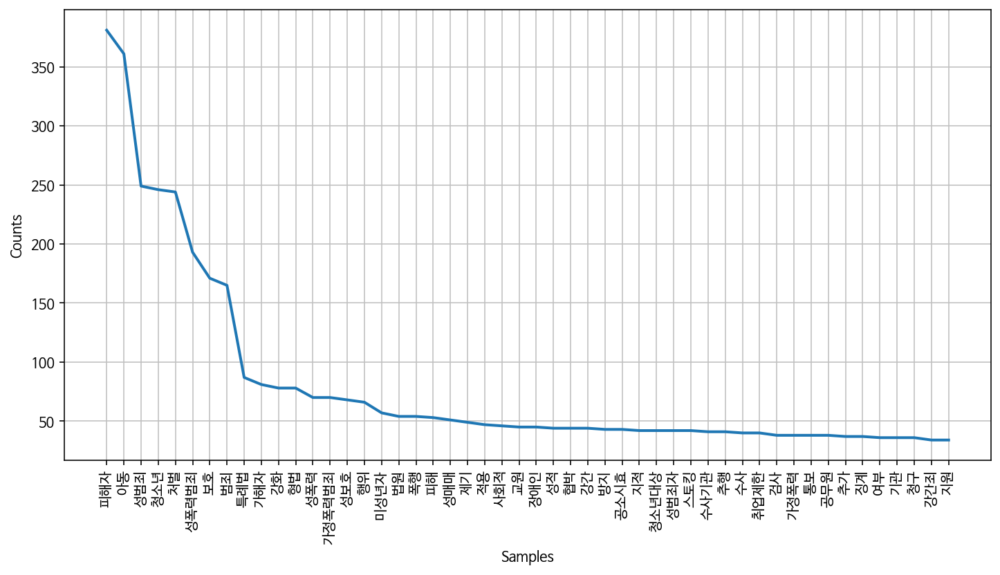

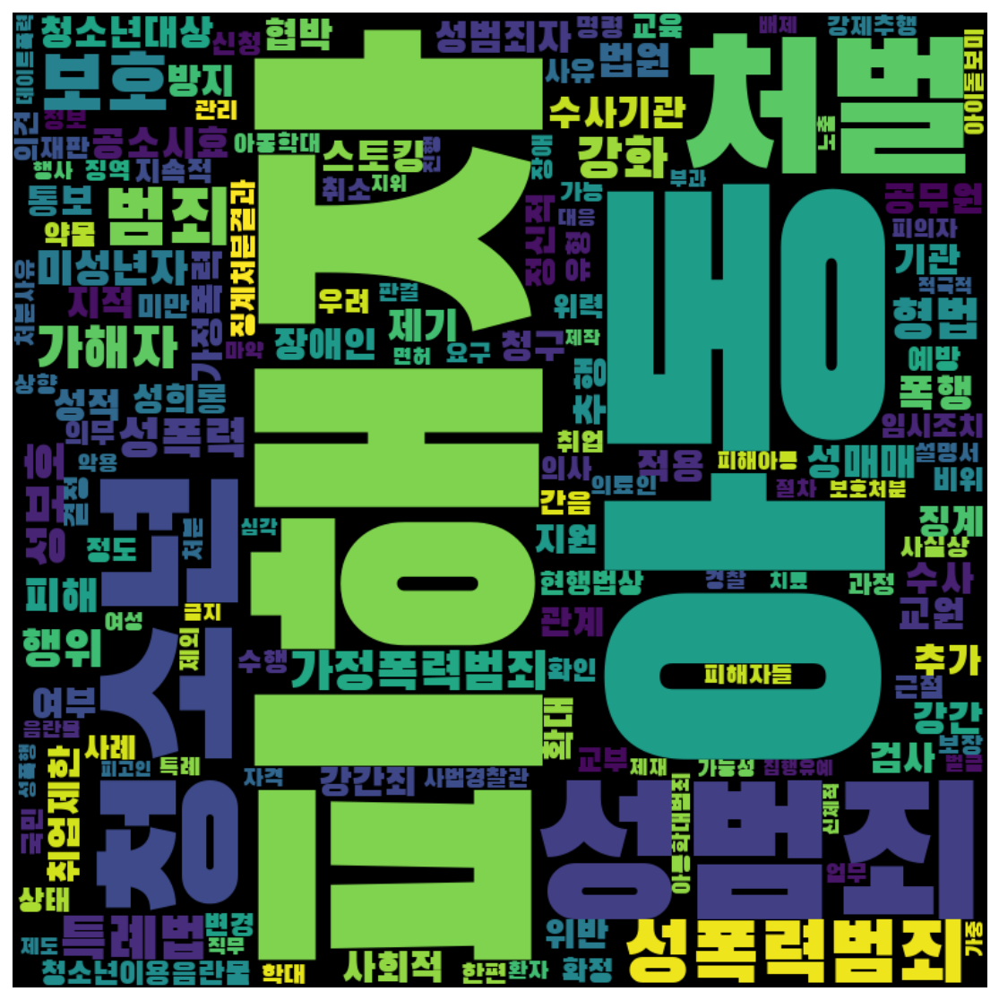

In [233]:
frewords_vis(progressive_g1_tokens)
wordcloud_vis(progressive_g1_tokens)

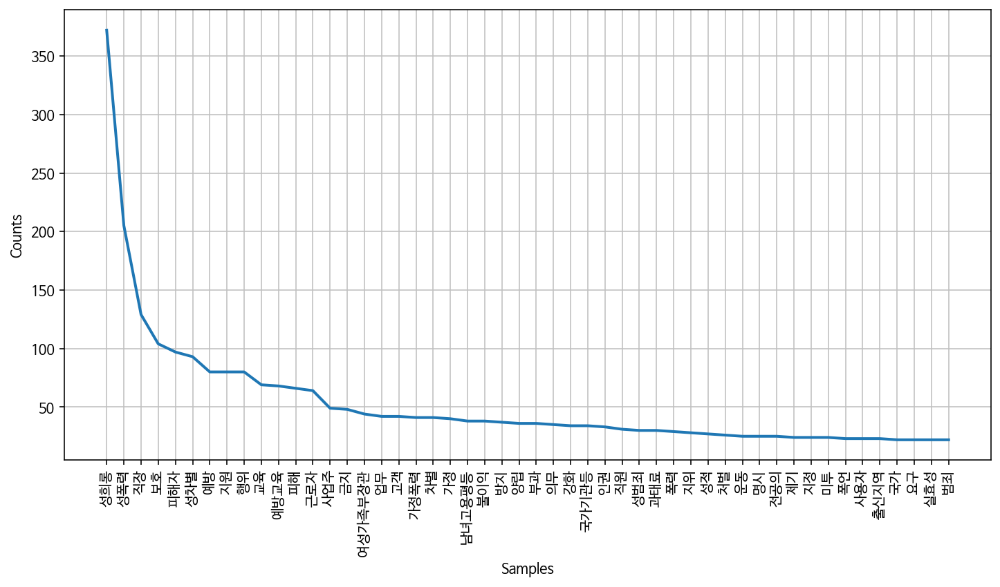

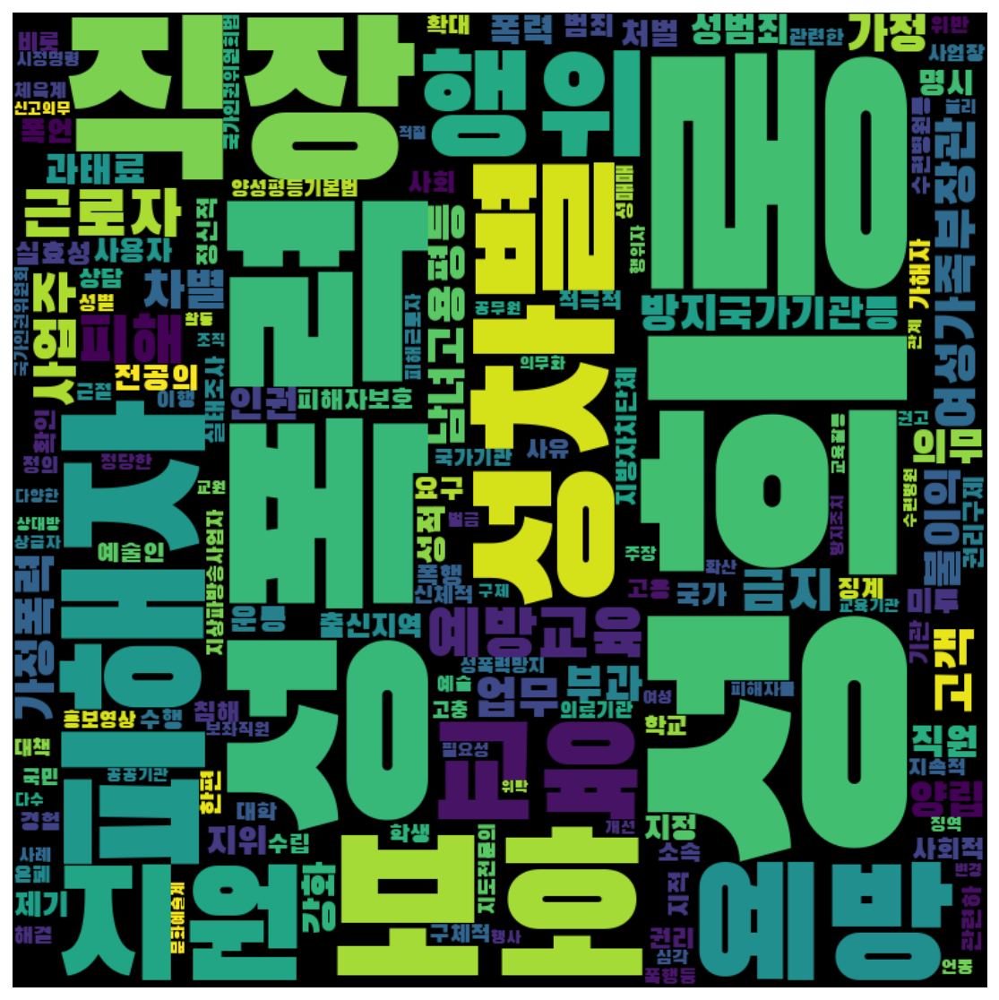

In [234]:
frewords_vis(progressive_g2_tokens)
wordcloud_vis(progressive_g2_tokens)

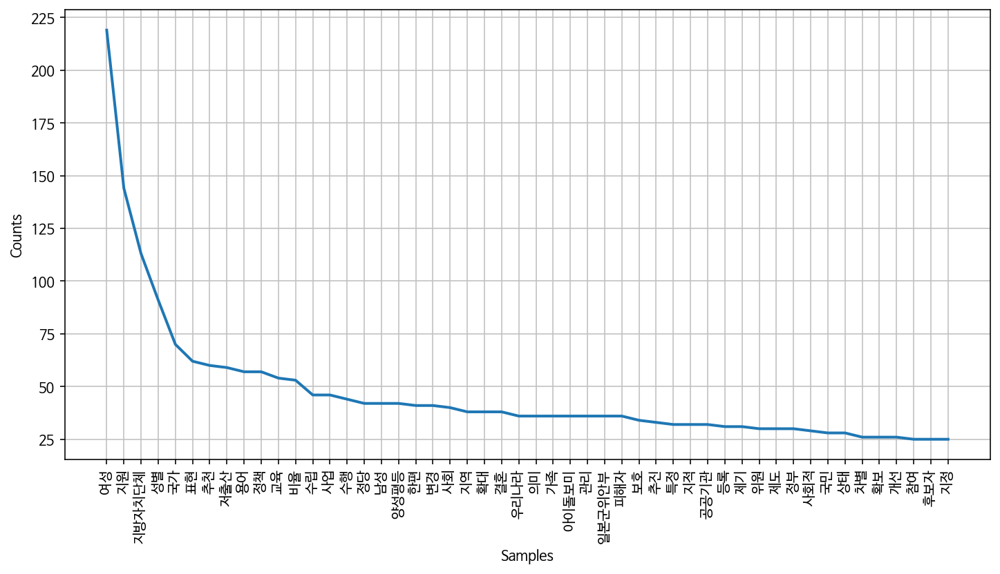

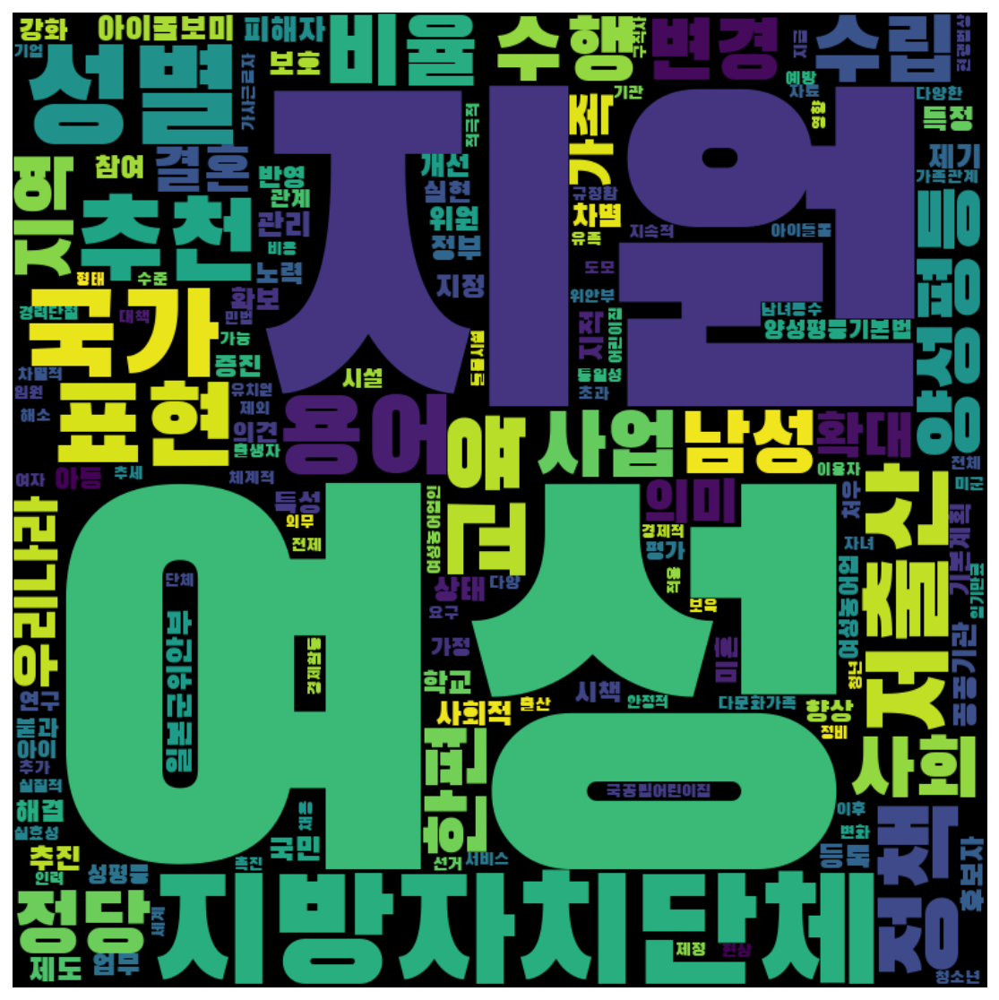

In [235]:
frewords_vis(progressive_g3_tokens)
wordcloud_vis(progressive_g3_tokens)

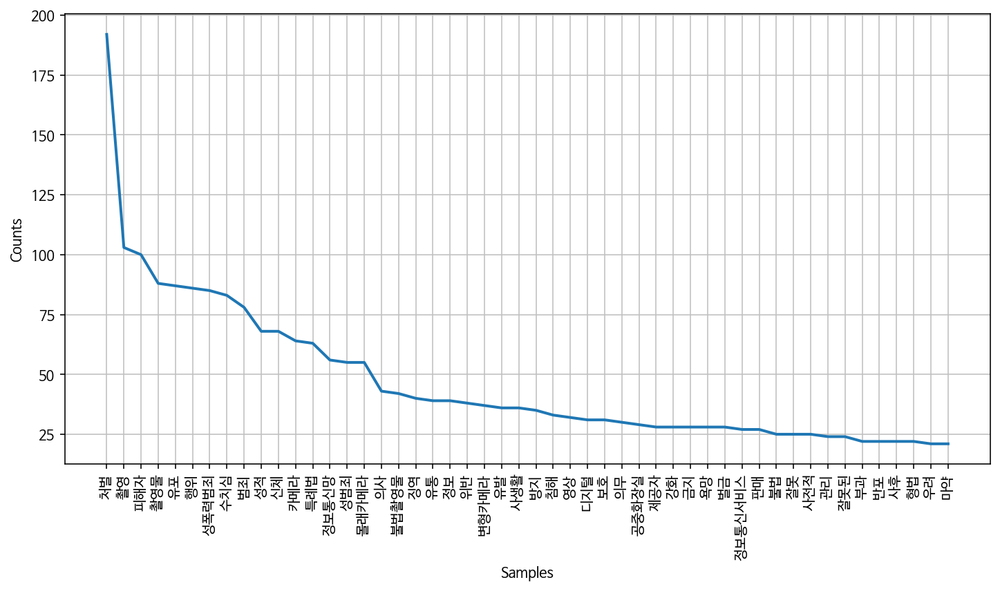

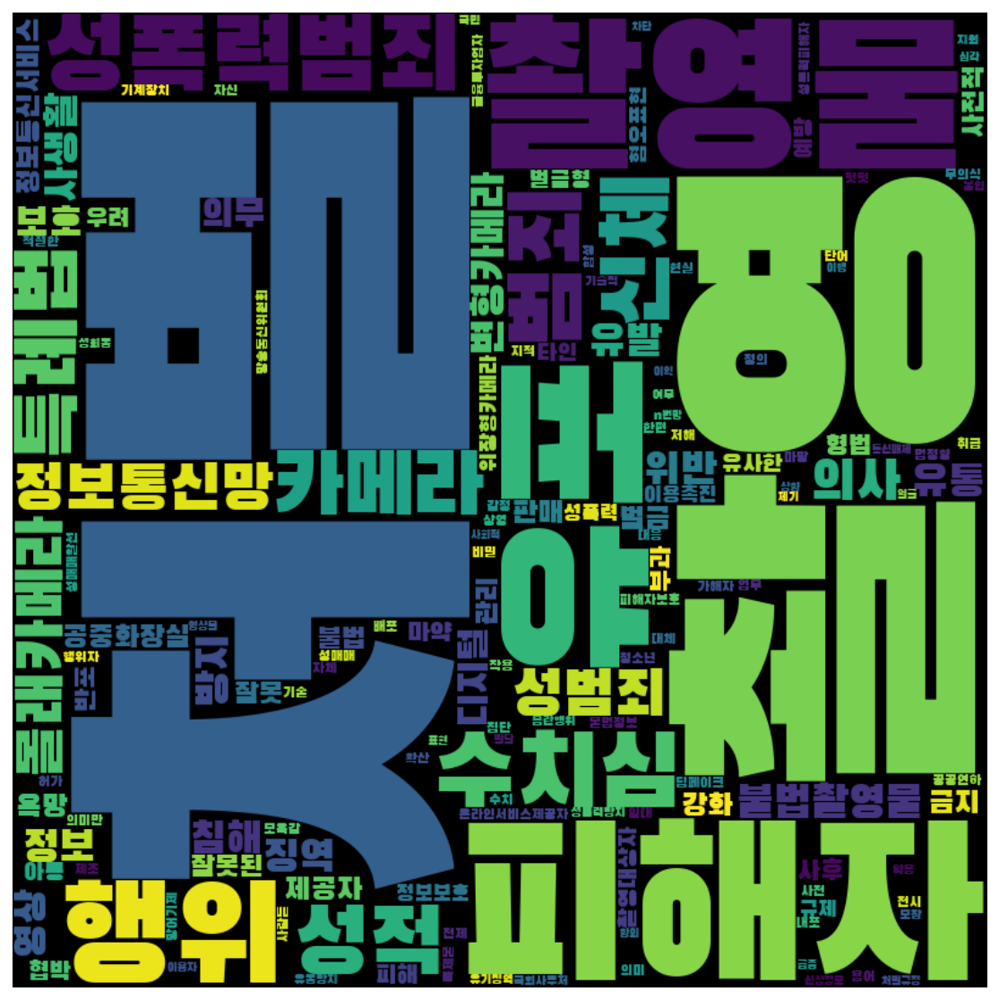

In [236]:
frewords_vis(progressive_g4_tokens)
wordcloud_vis(progressive_g4_tokens)

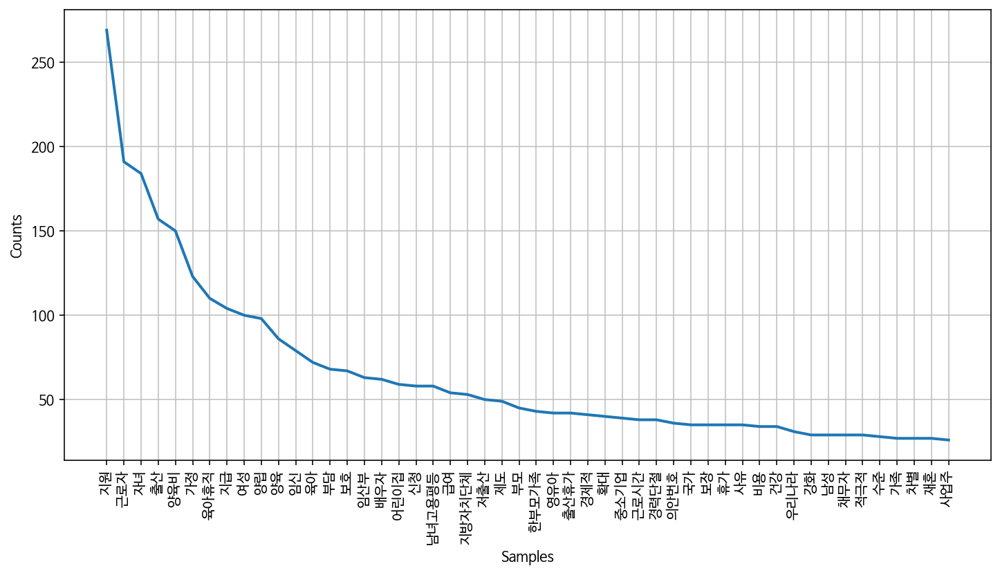

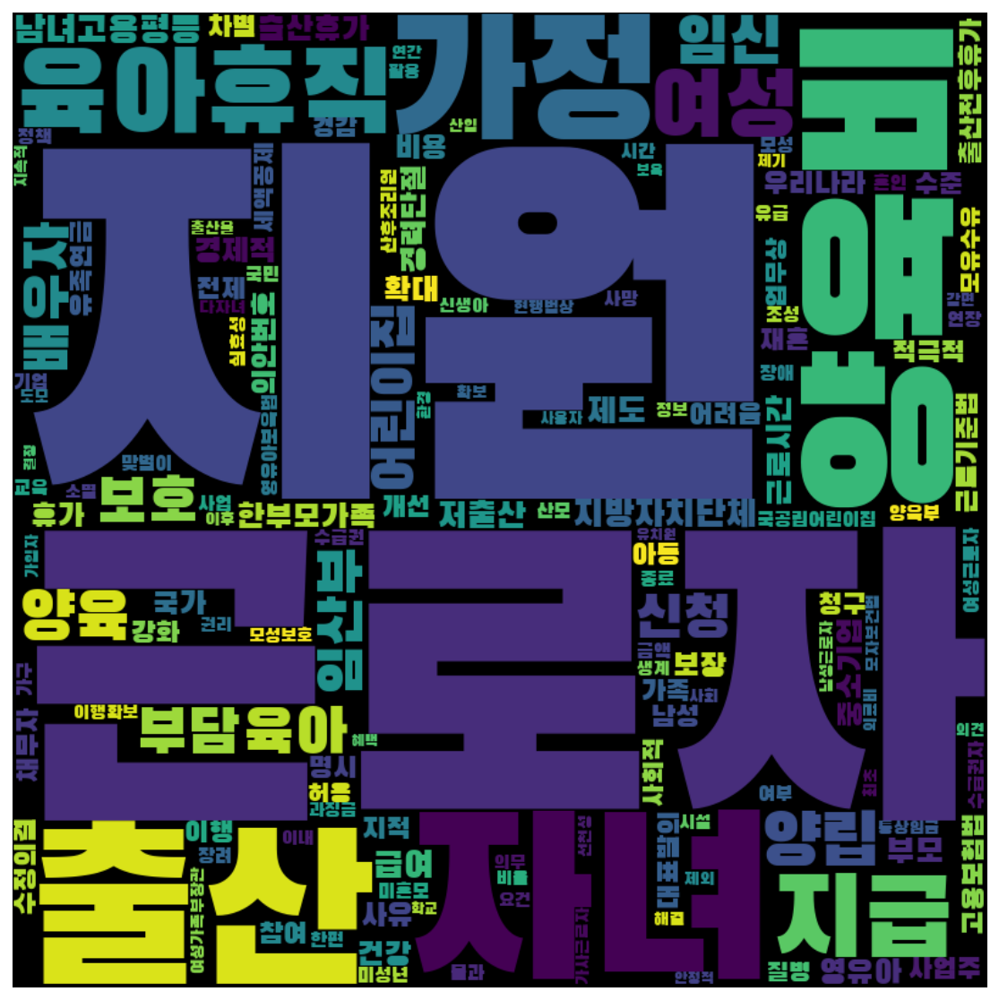

In [237]:
frewords_vis(progressive_g5_tokens)
wordcloud_vis(progressive_g5_tokens)

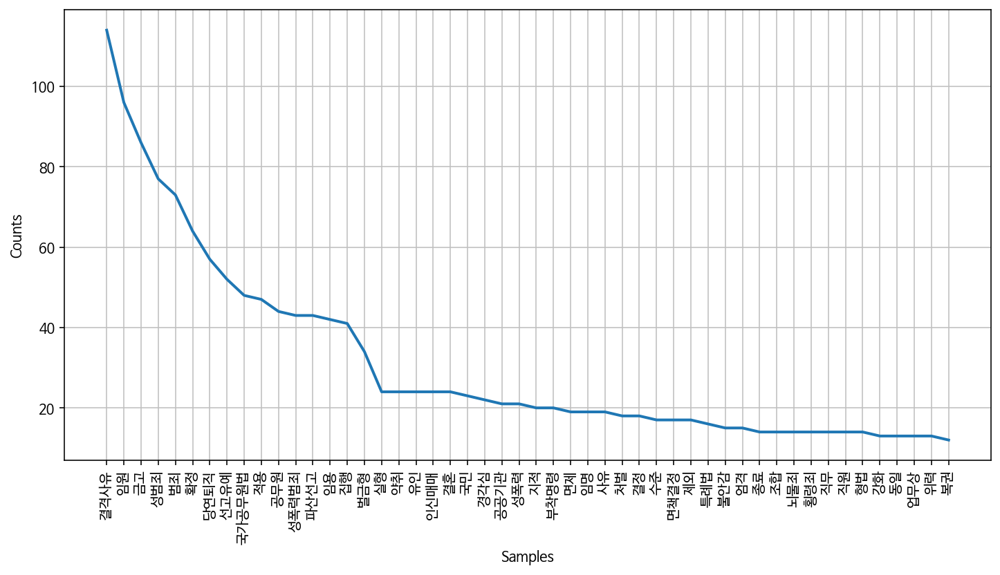

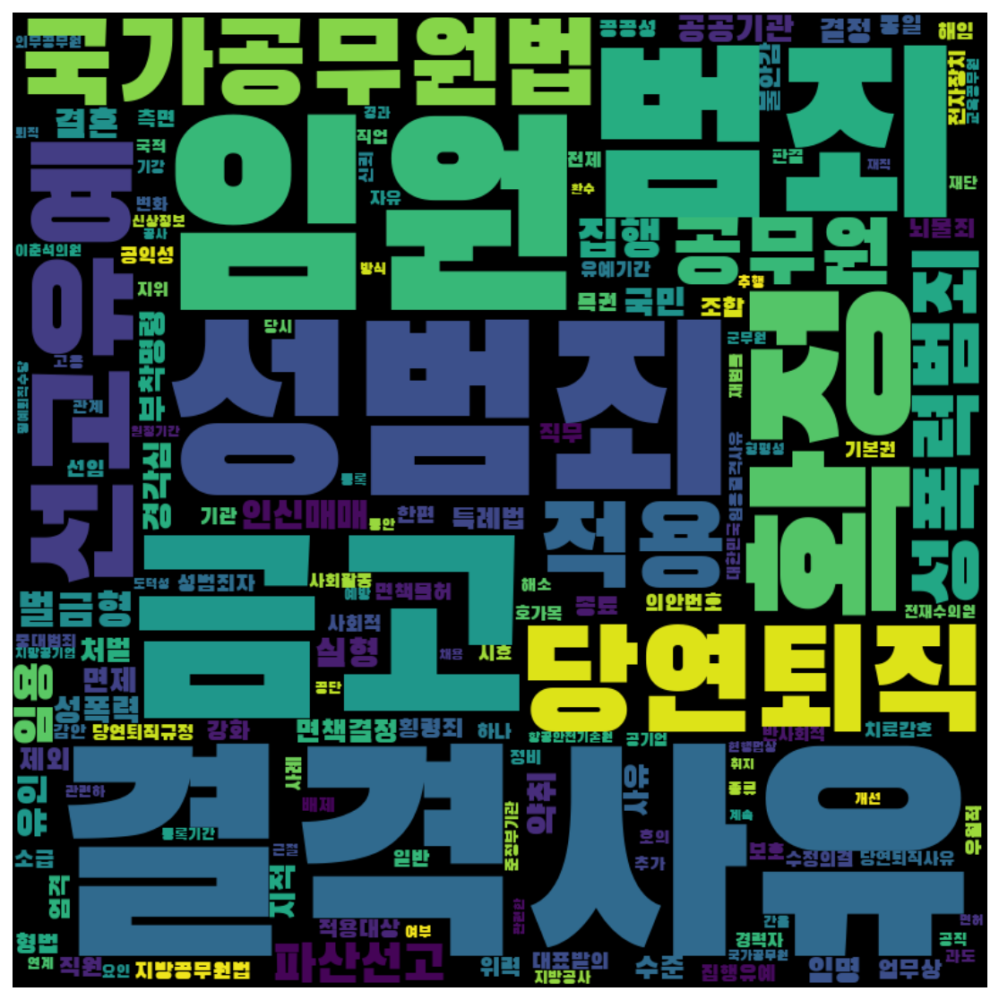

In [238]:
frewords_vis(progressive_g6_tokens)
wordcloud_vis(progressive_g6_tokens)

#### 보수

In [239]:
# K means 수행 
word_vectors_con = conservative['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con)
conservative['category'] = idx

<ipython-input-239-413f37cc3da8>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  conservative['category'] = idx


In [240]:
conservative['category'].value_counts()

2    88
4    83
0    82
5    59
1    53
3    45
Name: category, dtype: int64

In [241]:
conservative_g1 = conservative[conservative['category'] == 0]
conservative_g2 = conservative[conservative['category'] == 1]
conservative_g3 = conservative[conservative['category'] == 2]
conservative_g4 = conservative[conservative['category'] == 3]
conservative_g5 = conservative[conservative['category'] == 4]
conservative_g6 = conservative[conservative['category'] == 5]

In [242]:
conservative_g1_tokens = total_tokens(conservative_g1['tokens'])
conservative_g2_tokens = total_tokens(conservative_g2['tokens'])
conservative_g3_tokens = total_tokens(conservative_g3['tokens'])
conservative_g4_tokens = total_tokens(conservative_g4['tokens'])
conservative_g5_tokens = total_tokens(conservative_g5['tokens'])
conservative_g6_tokens = total_tokens(conservative_g6['tokens'])

In [243]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
conservative_g1_tokens = [each_word for each_word in conservative_g1_tokens if each_word not in stopwords]
conservative_g2_tokens = [each_word for each_word in conservative_g2_tokens if each_word not in stopwords]
conservative_g3_tokens = [each_word for each_word in conservative_g3_tokens if each_word not in stopwords]
conservative_g4_tokens = [each_word for each_word in conservative_g4_tokens if each_word not in stopwords]
conservative_g5_tokens = [each_word for each_word in conservative_g5_tokens if each_word not in stopwords]
conservative_g6_tokens = [each_word for each_word in conservative_g6_tokens if each_word not in stopwords]

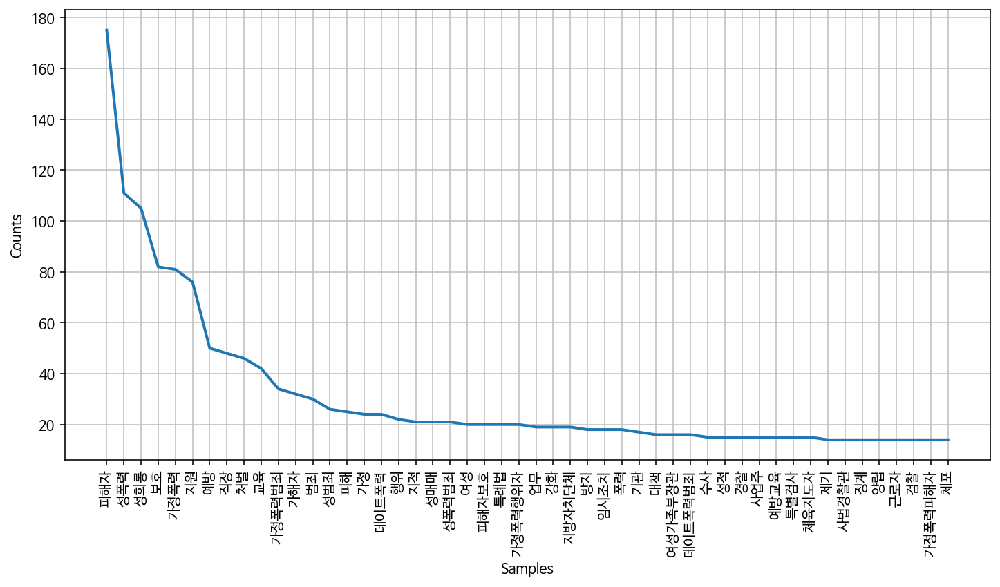

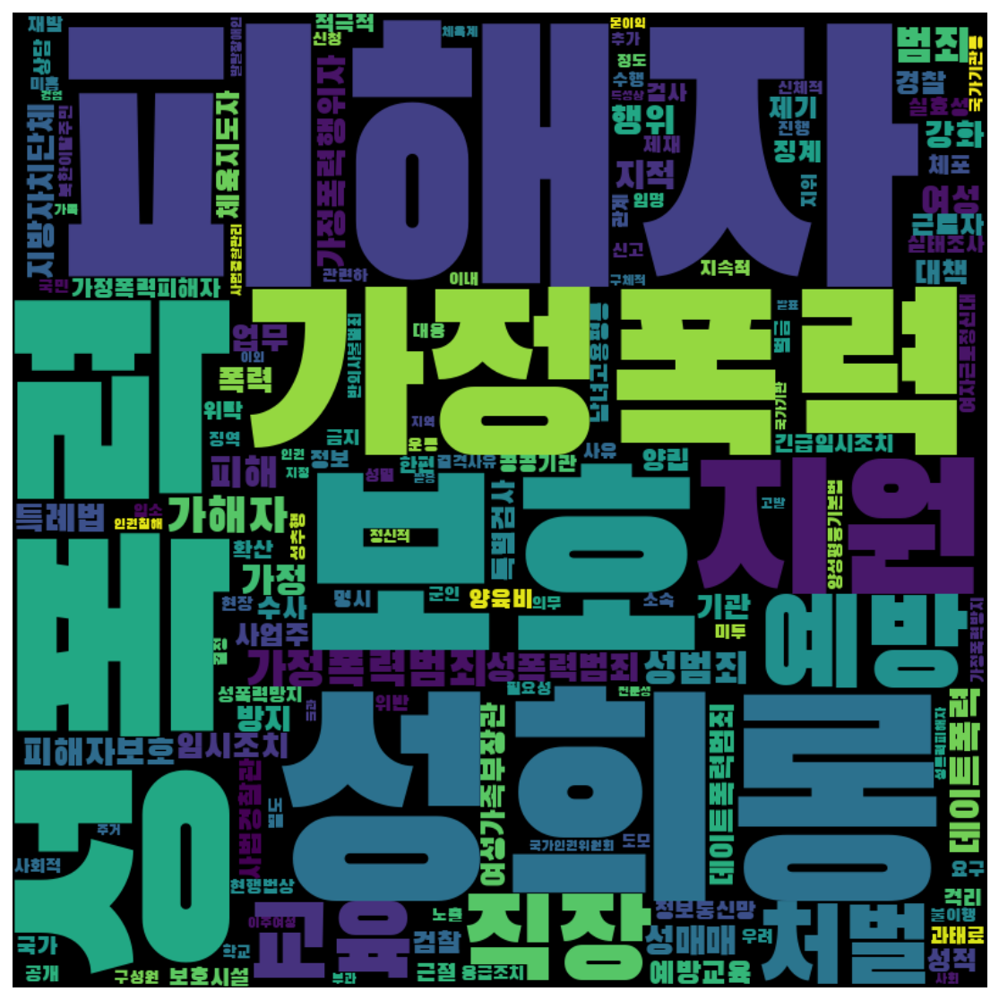

In [244]:
frewords_vis(conservative_g1_tokens)
wordcloud_vis(conservative_g1_tokens)

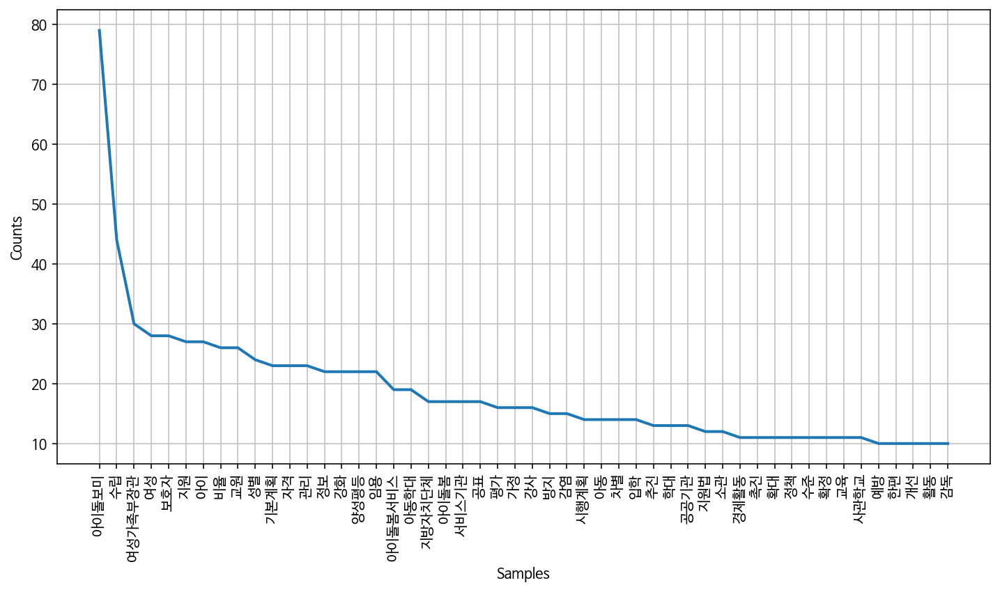

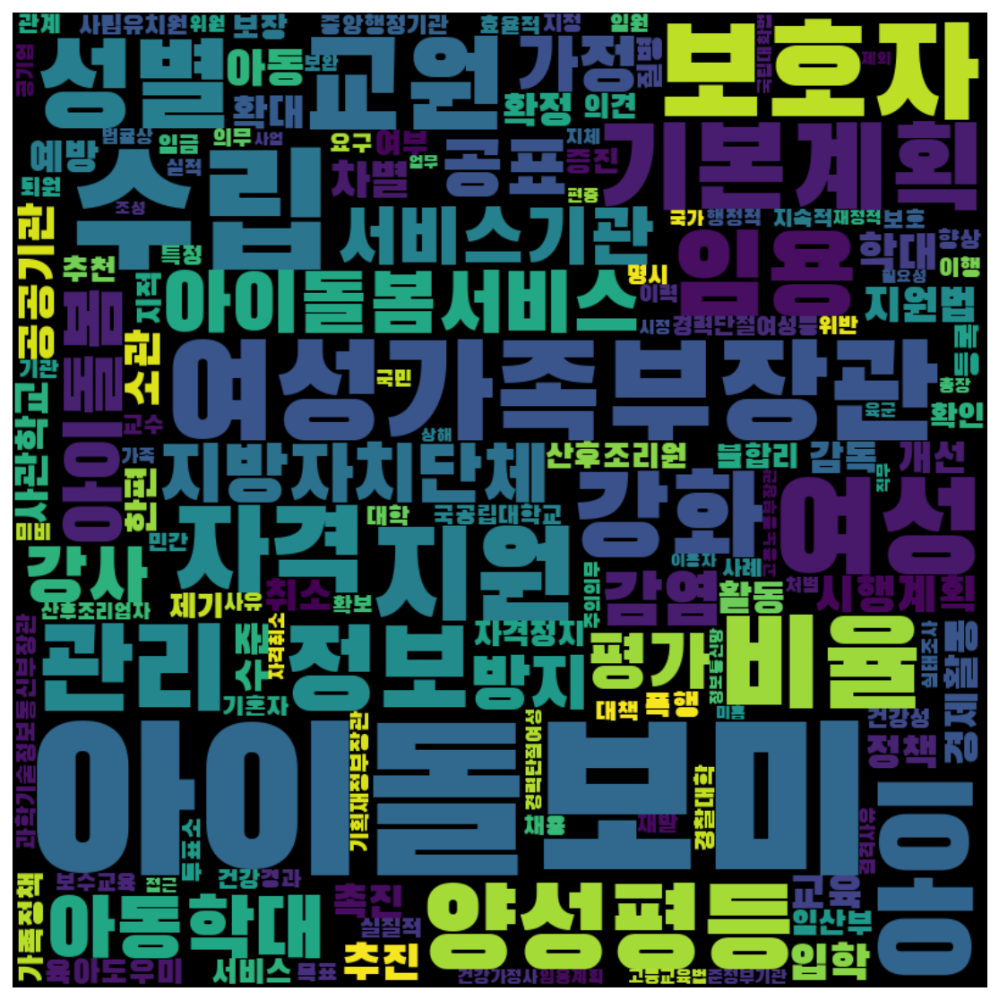

In [245]:
frewords_vis(conservative_g2_tokens)
wordcloud_vis(conservative_g2_tokens)

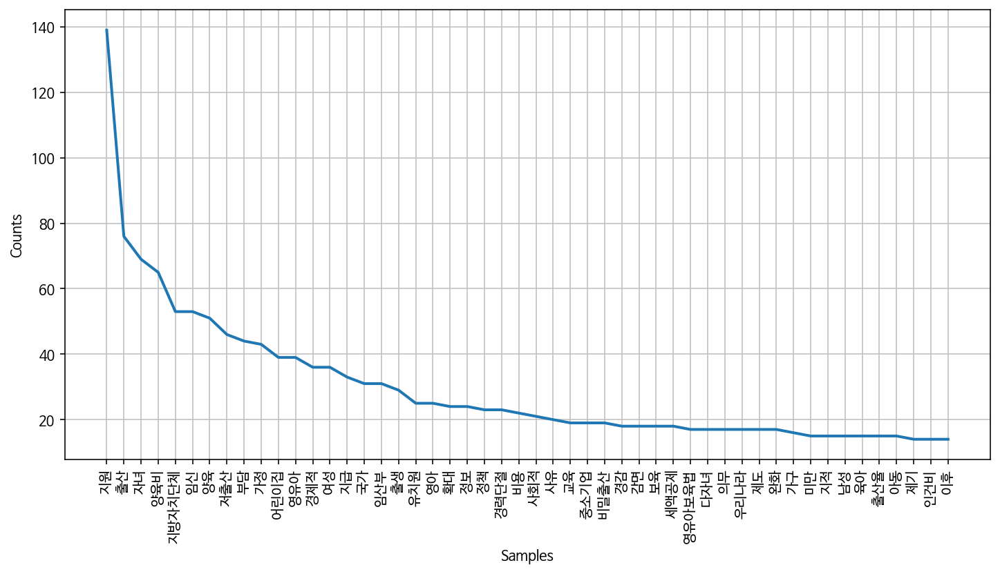

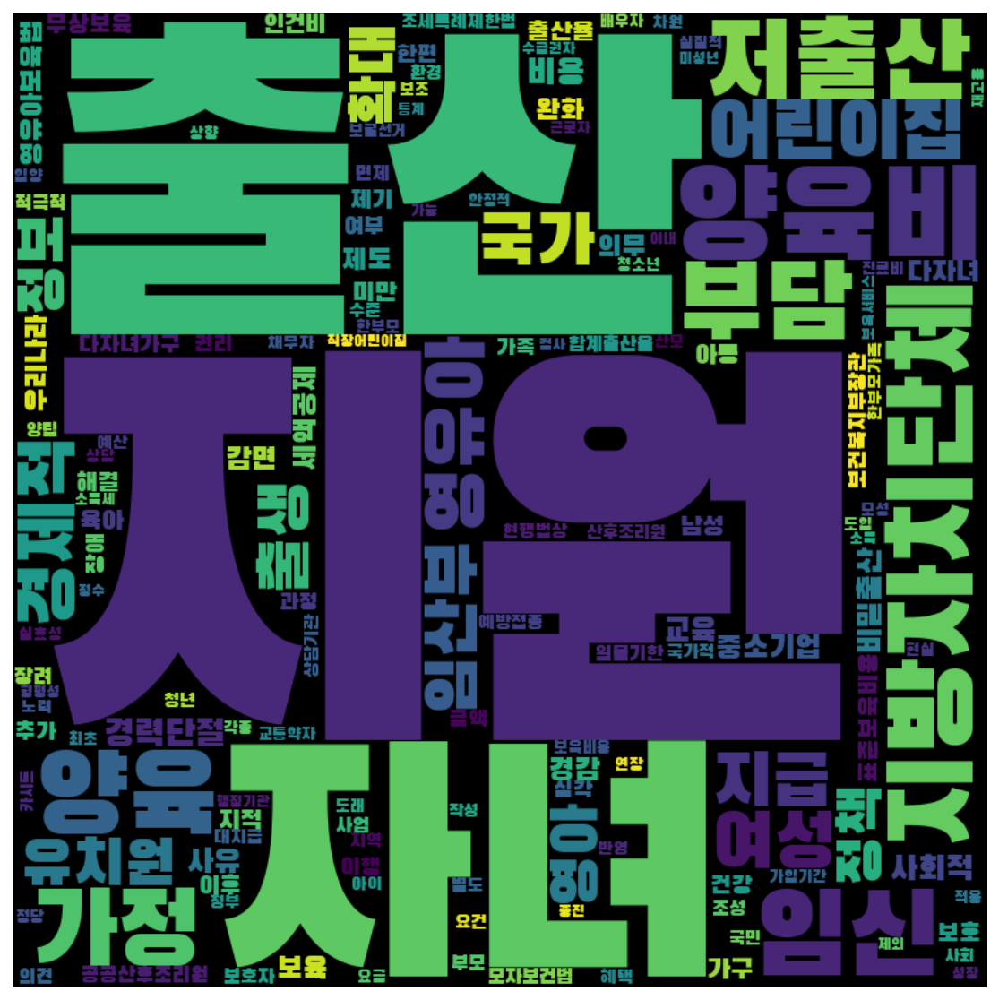

In [246]:
frewords_vis(conservative_g3_tokens)
wordcloud_vis(conservative_g3_tokens)

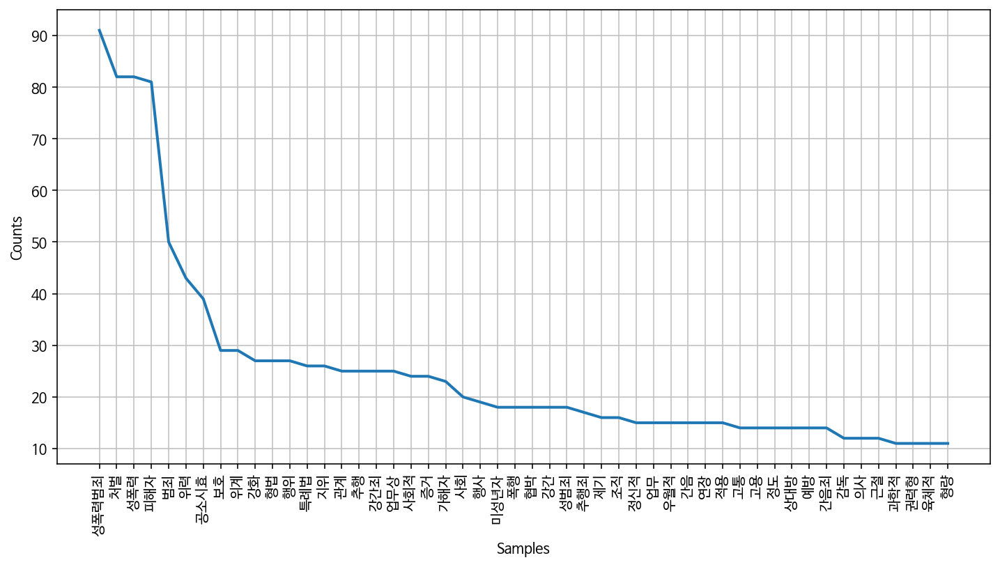

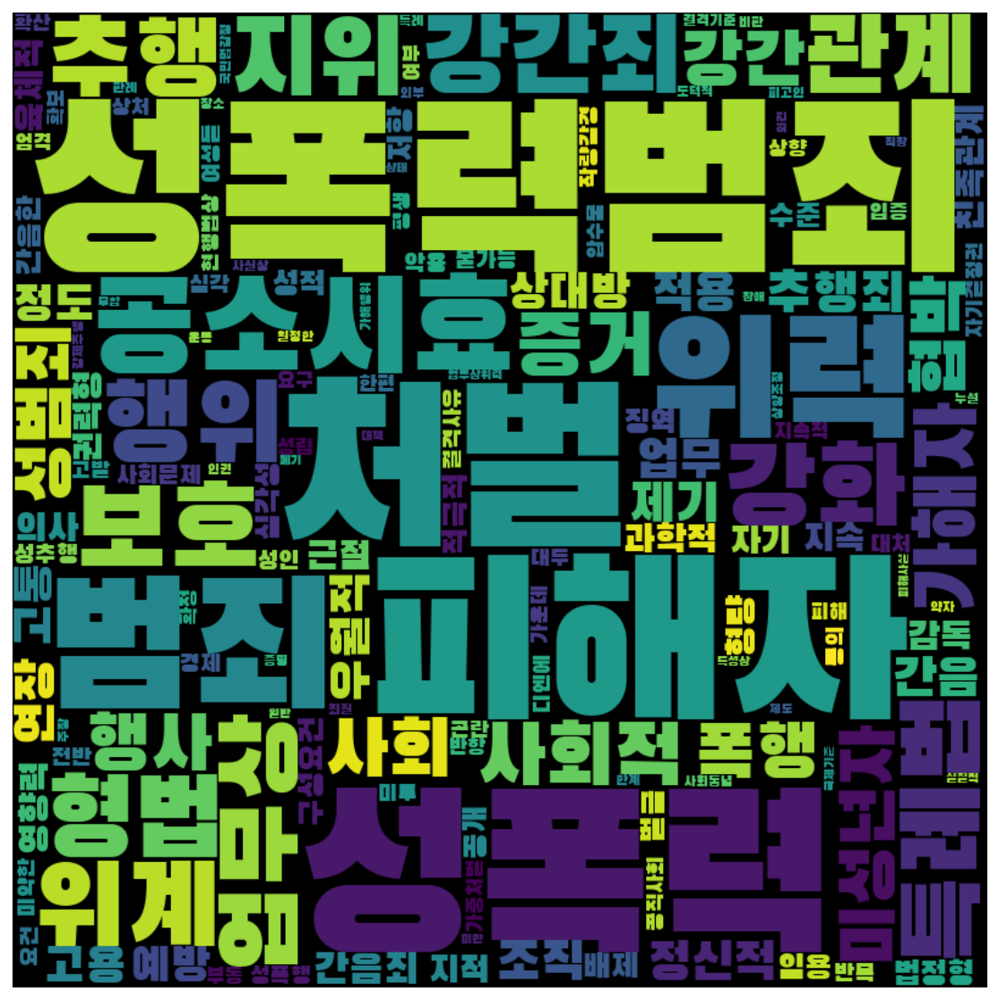

In [247]:
frewords_vis(conservative_g4_tokens)
wordcloud_vis(conservative_g4_tokens)

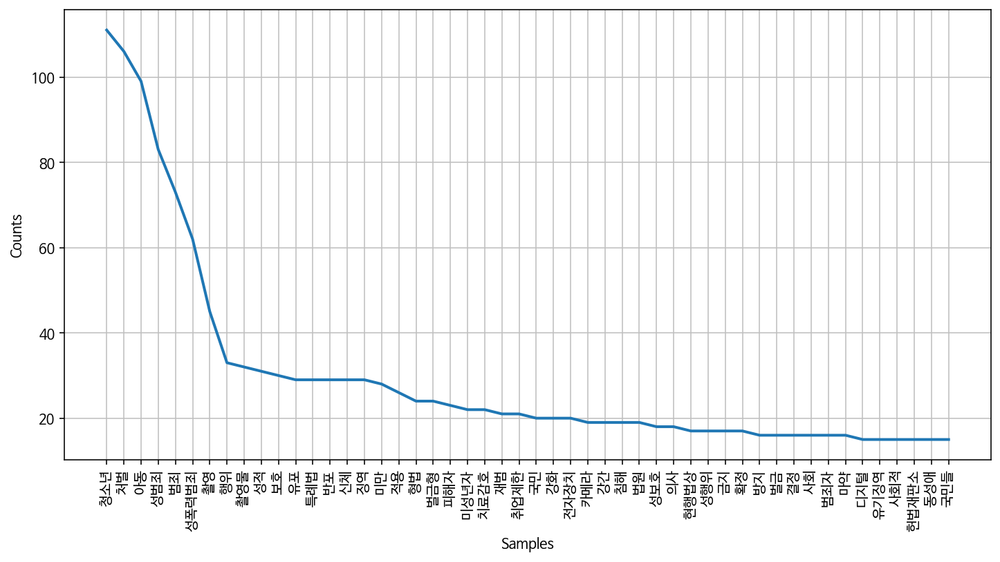

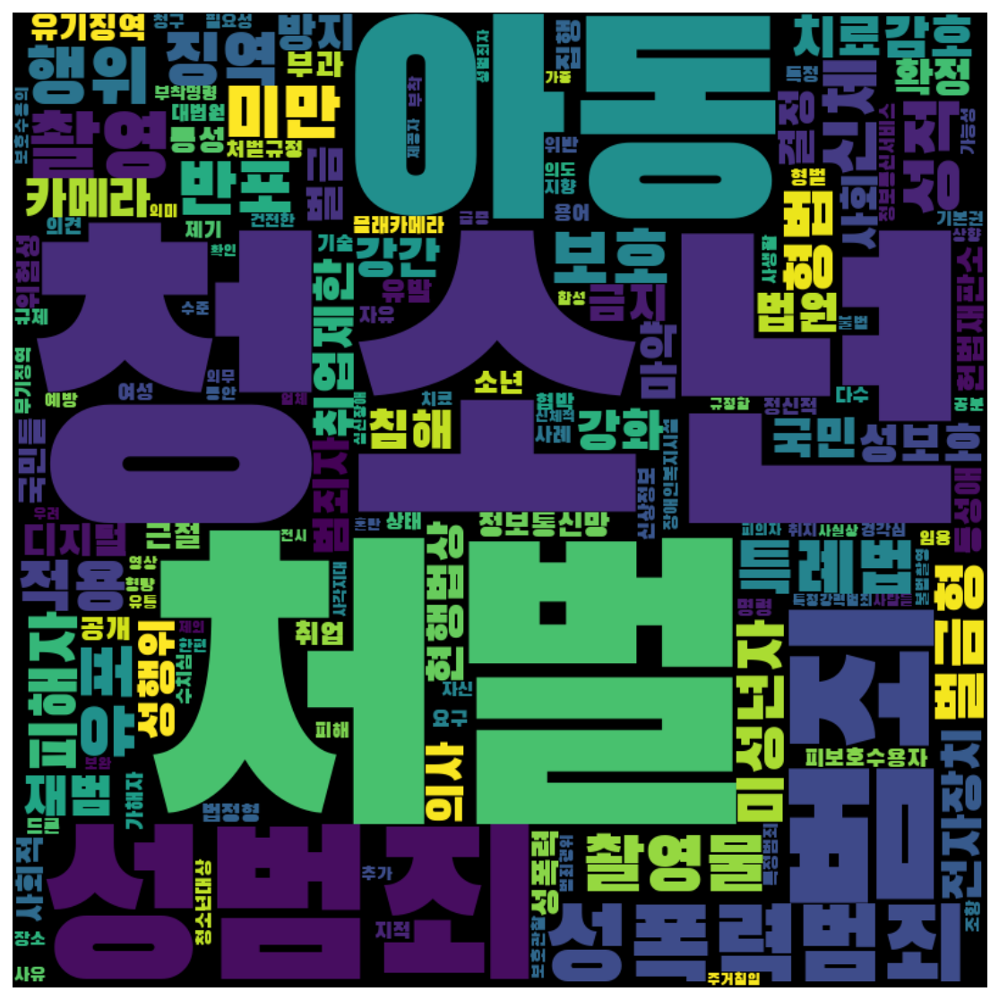

In [248]:
frewords_vis(conservative_g5_tokens)
wordcloud_vis(conservative_g5_tokens)

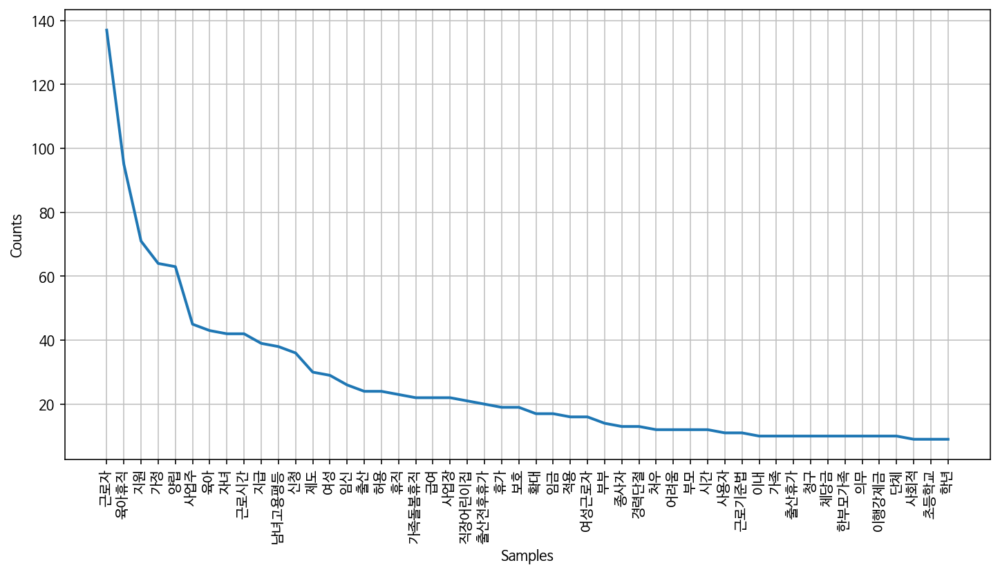

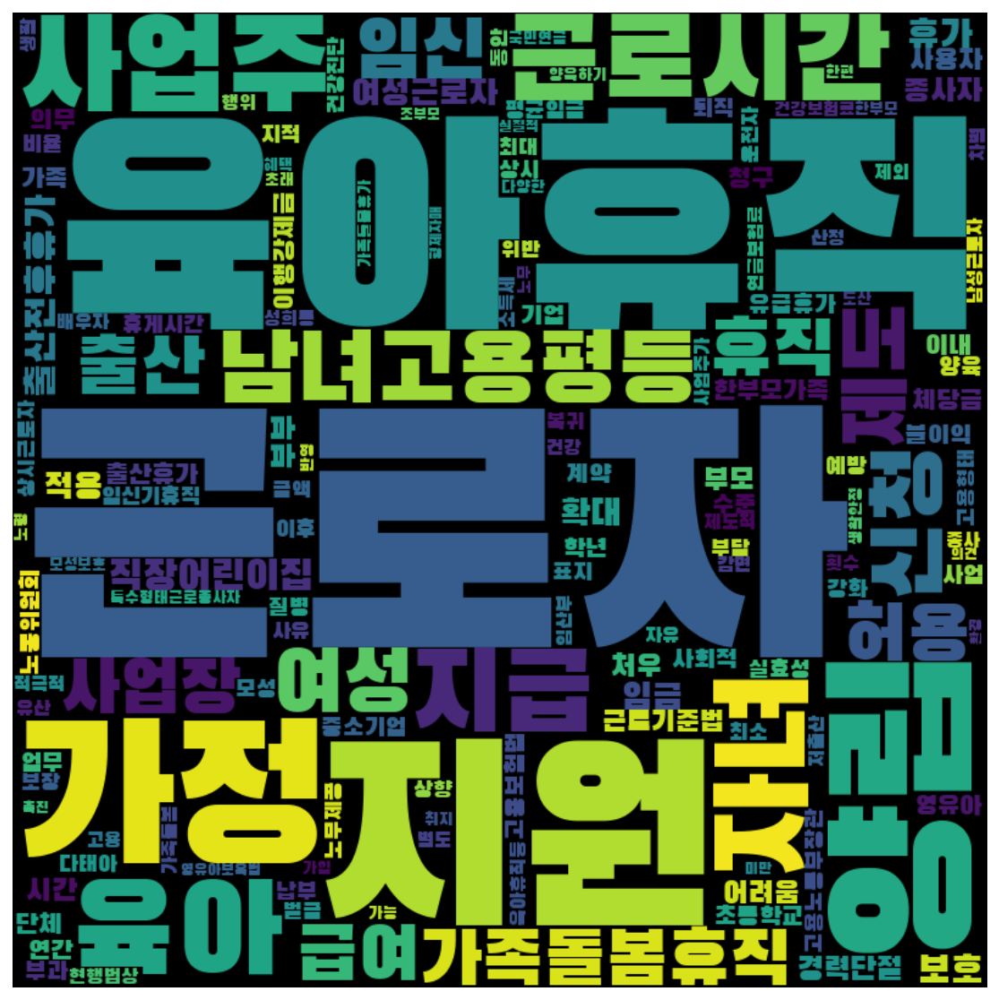

In [249]:
frewords_vis(conservative_g6_tokens)
wordcloud_vis(conservative_g6_tokens)